In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
%matplotlib inline
import matplotlib.pyplot as plt

import sys 
import inspect
import seaborn as sns
import os

import perturbseq as perturb

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis')
sc.logging.print_versions()

scanpy==1.5.1 anndata==0.7.1 umap==0.4.4 numpy==1.17.2 scipy==1.4.1 pandas==0.24.2 scikit-learn==0.22 statsmodels==0.11.0 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.8.1


In [2]:
PROTEIN='TP53'
DATA='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14'
SUBSAMPLED=DATA+'/'+PROTEIN+'/subsampled/A549.'+PROTEIN

counts=20000

FIGS=DATA+'/2020-09-15_Figures/'
DATADUMP=DATA+'/2020-09-15_Tables/'
os.system('mkdir -p '+FIGS)
print(FIGS)
os.system('mkdir -p '+DATADUMP)
print(DATADUMP)

sc.settings.figdir=FIGS

/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/2020-09-15_Figures/
/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/2020-09-15_Tables/


In [3]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

In [4]:
perturb.tl.bulk(adata,grouping_variable='guide.compact')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


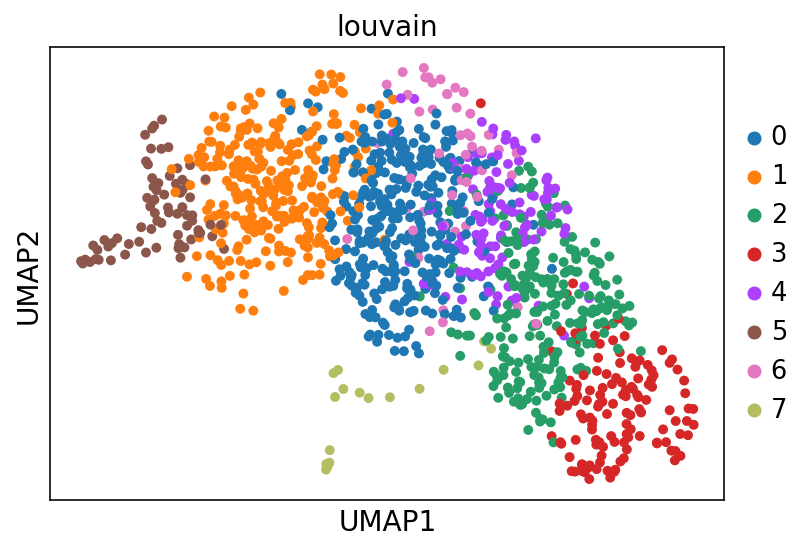

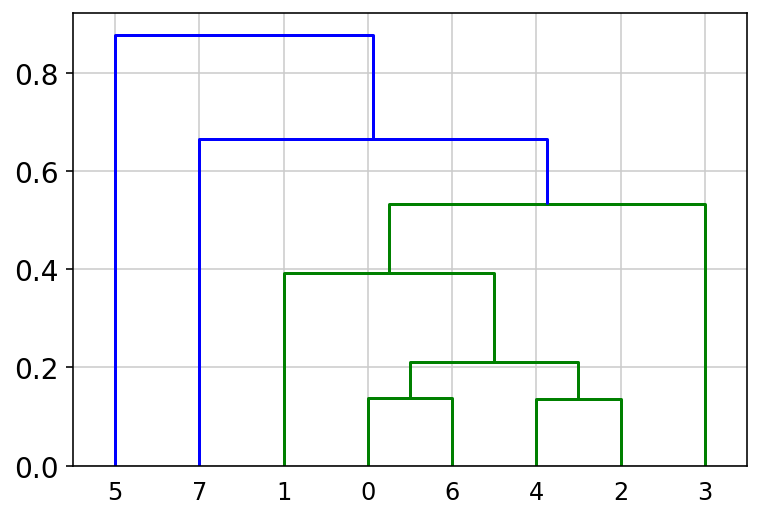

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


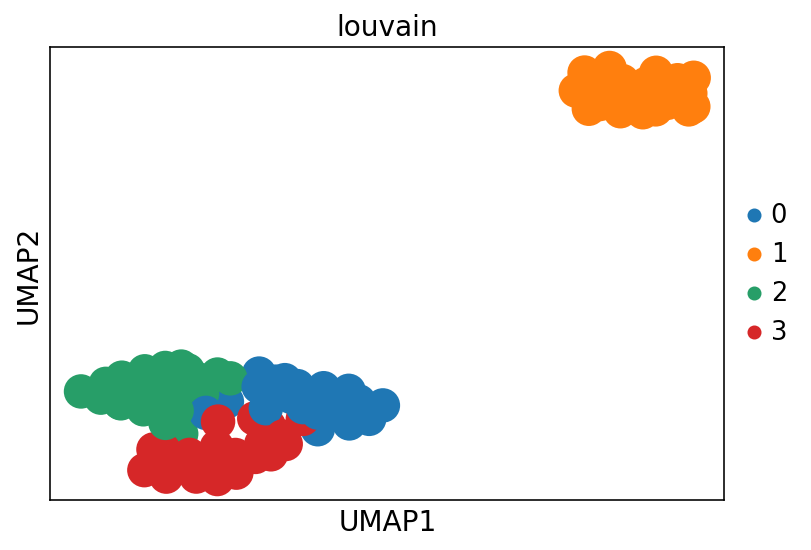

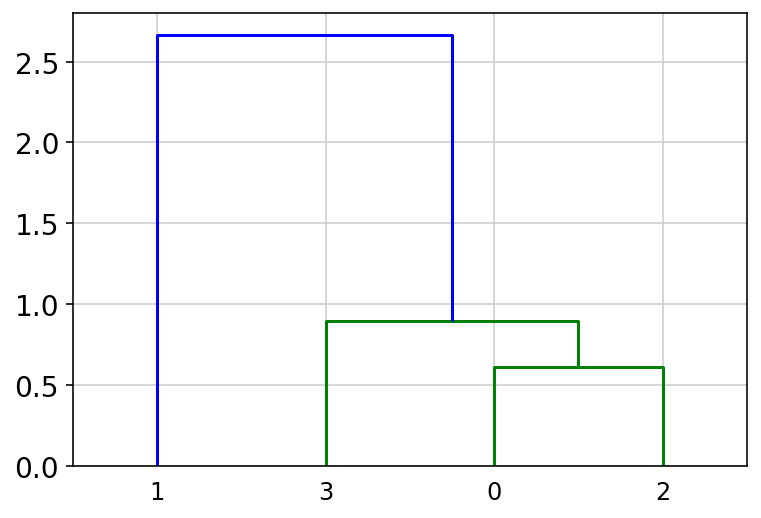

In [5]:
perturb.tl.gene_programs_and_perturbation_modules(adata,cluster_within=False,
                                                  cmap_programs='Paired')

In [6]:
import copy
sc_bulk=copy.deepcopy(adata.uns['bulk.guide.compact'].T)
sc_bulk=sc_bulk.drop(columns=['multiple'])

In [7]:
#save bulk for the clustering
res=DATA+'/'+PROTEIN+'/clustering/'+PROTEIN
os.system('mkdir -p '+DATA+'/'+PROTEIN+'/clustering/')
sc_bulk.to_csv(res+'.bulk.csv')
print(res+'.bulk.csv')

/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/TP53/clustering/TP53.bulk.csv


In [8]:
#go to the R clustering notebook to cluster the variants
#bye!

#back!

In [4]:
#make the anno table
#add scores and cluster information
#read in the annotation file to add the clusters to it

FDR=0.01
#original anno
ANNO=DATA+'/'+PROTEIN+'/anno'
anno=pd.read_csv(ANNO+'/'+PROTEIN+'.anno.complete2.csv',sep='\t')
anno.index=anno['Variant']

anno['Position']=anno['Position'].astype('Int32')
anno['Count_pancan']=anno['Count_pancan'].astype('Int32')
anno['Count_ExAC']=anno['Count_ExAC'].astype('Int32')

#scores
ref='P359P'
score='HotellingT2'
scores=pd.read_csv(DATA+'/'+PROTEIN+'/scoring/'+PROTEIN+'.scores_vs_'+ref+'.csv')
scores.index=scores['group2']
anno[score]=scores.loc[anno.index,score]
anno['FDR.'+score]=scores.loc[anno.index,'FDR.'+score]

#cluster info
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants_df.index=sorted_variants_df[0]
anno['cluster_color']=sorted_variants_df.loc[anno.index,1]

f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-06-07/TP53/mutational_signatures/TP53_mutationalSignatures_Giacomelli.txt'
mutsig=pd.read_csv(f,sep='\t',skiprows=1)
mutsig.index=mutsig['Allele']
print(mutsig.head())

#modify the names for the synonymous ones
import re
new_vars=[]
for i in range(mutsig.shape[0]):
    v=mutsig.index[i]
    new_var_here=v
    if 'B' in v:
        new_var_here=re.sub('B',v[0],v)
    new_vars.append(new_var_here)
mutsig.index=new_vars

anno.head()



/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


       Allele AA_wt AA_variant  Position  A549_p53WT_Nutlin-3_Z-score  \
Allele                                                                  
R175H   R175H     R          H       175                     1.791388   
R248Q   R248Q     R          Q       248                     1.233480   
R273H   R273H     R          H       273                     1.145501   
R248W   R248W     R          W       248                     1.552718   
R273C   R273C     R          C       273                     1.261347   

        A549_p53NULL_Nutlin-3_Z-score  A549_p53NULL_Etoposide_Z-score  \
Allele                                                                  
R175H                        0.538396                       -0.744765   
R248Q                        0.217053                       -0.985385   
R273H                        1.077844                       -1.438387   
R248W                        0.613931                       -0.689231   
R273C                        0.314304             

,Variant,Variant.1,Position,From,To,mutation_type,Count_pancan,Count_ExAC,control_status,control_color,Library_synthesis,long_name,control_status2,text_color,HotellingT2,FDR.HotellingT2,cluster_color
Variant,,,,,,,,,,,,,,,,,
R175H,R175H,R175H,175,C,T,Single,993,NaN,unknown,white,in,TP53_R175H,hotspot,blue,385.656185,0.004,navy
R273C,R273C,R273C,273,G,A,Single,677,NaN,unknown,white,in,TP53_R273C,hotspot,blue,283.661525,0.004,#99CCFF
R248Q,R248Q,R248Q,248,C,T,Single,656,NaN,unknown,white,not in library,NaN,hotspot,blue,NaN,NaN,NaN
R273H,R273H,R273H,273,C,T,Single,622,NaN,unknown,white,in,TP53_R273H,hotspot,blue,185.357515,0.004,#99CCFF
R248W,R248W,R248W,248,G,A,Single,550,NaN,unknown,white,in,TP53_R248W,hotspot,blue,290.608023,0.004,navy


In [5]:
#annotate the cluster color onto the adata
adata.obs['Cluster']=list(anno.loc[adata.obs['guide.compact'],'cluster_color'])

In [6]:
adata.obs['Cluster2']=list(anno.loc[adata.obs['guide.compact'],'cluster_color'])
adata.obs['Cluster2'][adata.obs['guide.compact']=='unassigned']='slateblue'

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


... storing 'Cluster' as categorical
... storing 'Cluster2' as categorical


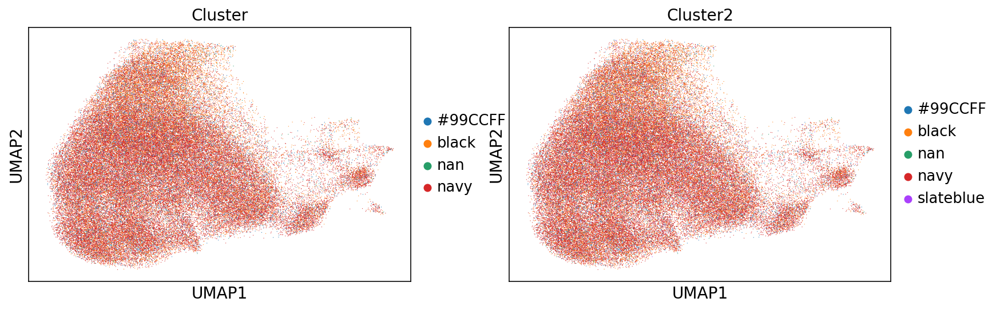

In [7]:
sc.pl.umap(adata,color=['Cluster','Cluster2'])

In [8]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

In [9]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['P359P', 'T170T', 'D21D', 'A83V', 'P153P', 'E2E', 'P47P', 'P295P', 'R158R', 'T118T', 'Q5R', 'G360V', 'V31I', 'P36P', 'P58R', 'P222P', 'T312S', 'P301P', 'L344L', 'P47S', 'WT', 'E339K', 'Y107H', 'S366A', 'V216V', 'R337C', 'R337L', 'unassigned', 'C277F', 'R280K', 'R213Q', 'P152L', 'S241C', 'R273H', 'R273L', 'R273C', 'K132R', 'R158H', 'M246V', 'M237I', 'V272L', 'C242F', 'E271K', 'Y205C', 'G154V', 'Y234C', 'Y220C', 'G266E', 'Y236C', 'R280T', 'R158L', 'R248W', 'C238F', 'Y163C', 'G266V', 'A159V', 'E285K', 'G105C', 'G245C', 'H179R', 'K132N', 'S241F', 'R248L', 'V272M', 'H193R', 'G245S', 'P250L', 'C141Y', 'P278L', 'A159P', 'G244C', 'E286K', 'S127F', 'C238Y', 'V216M', 'V173L', 'V157F', 'C176Y', 'C176F', 'H214R', 'H193Y', 'R110L', 'C135Y', 'R249S', 'R282W', 'L194R', 'G266R', 'R249M', 'G245V', 'C275Y', 'H179Y', 'P151S', 'R175H', 'C135F', 'I195T', 'P278S', 'V173M', 'G245D', 'H193L', 'C275F']


In [10]:
#number of cells
#===== cells/variant
#======================

adata_full=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.analysis.h5ad')
print(adata_full)
new_mut=[]
for i in range(adata_full.n_obs):
    v=adata_full.obs['mut.std'][i]
    if v=='uninfected':
        v='unassigned'
    elif v=='H166Y':
        v='Y166H'
    else:
        v=v
    new_mut.append(v)
adata_full.obs['mut.std']=new_mut

cells_per_variant=pd.DataFrame(adata_full.obs['mut.std'].value_counts())
cells_per_variant['variant']=list(cells_per_variant.index)
print(cells_per_variant.head())



Only considering the two last: ['.analysis', '.h5ad'].
Only considering the two last: ['.analysis', '.h5ad'].
AnnData object with n_obs × n_vars = 162314 × 1224 
    obs: 'TP53_A159P', 'TP53_A159V', 'TP53_C135F', 'TP53_C135Y', 'TP53_C141Y', 'TP53_C176F', 'TP53_C176Y', 'TP53_C238F', 'TP53_C238Y', 'TP53_C242F', 'TP53_C275F', 'TP53_C275Y', 'TP53_C277F', 'TP53_E271K', 'TP53_E285K', 'TP53_E286K', 'TP53_G105C', 'TP53_G154V', 'TP53_G244C', 'TP53_G245C', 'TP53_G245D', 'TP53_G245S', 'TP53_G245V', 'TP53_G266E', 'TP53_G266R', 'TP53_G266V', 'TP53_H179R', 'TP53_H179Y', 'TP53_H193L', 'TP53_H193R', 'TP53_H193Y', 'TP53_H214R', 'TP53_I195T', 'TP53_K132N', 'TP53_K132R', 'TP53_L194R', 'TP53_M237I', 'TP53_M246V', 'TP53_P151S', 'TP53_P152L', 'TP53_P250L', 'TP53_P278L', 'TP53_P278S', 'TP53_R110L', 'TP53_R158H', 'TP53_R158L', 'TP53_R175H', 'TP53_R213Q', 'TP53_R248L', 'TP53_R248W', 'TP53_R249M', 'TP53_R249S', 'TP53_R273C', 'TP53_R273H', 'TP53_R273L', 'TP53_R280K', 'TP53_R280T', 'TP53_R282W', 'TP53_R337C', 'TP

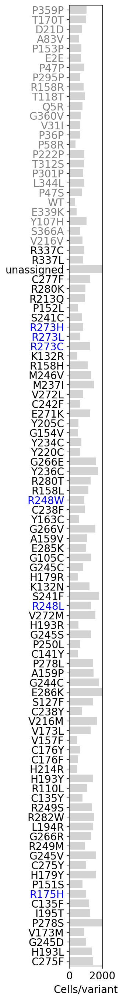

In [11]:
fig,plots=plt.subplots(1)
fig.set_size_inches(0.8,23)
plots.barh(cells_per_variant.loc[sorted_variants,'variant'].iloc[::-1],
           cells_per_variant.loc[sorted_variants,'mut.std'].iloc[::-1],
          color='lightgray')

#cells_per_variant.plot.bar(x='variant',y='mut.std',ax=plots)
plots.set_xlim(0,2000)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]
plots.set_xlabel('Cells/variant')


plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.png',bbox_inches = "tight")
plt.show()

In [12]:
anno['Cells/variant']=cells_per_variant.loc[anno.index,'mut.std']

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


In [13]:
adata_single=adata_full[adata_full.obs['mut.std']!='multiple',:]
adata_single

View of AnnData object with n_obs × n_vars = 125680 × 1224 
    obs: 'TP53_A159P', 'TP53_A159V', 'TP53_C135F', 'TP53_C135Y', 'TP53_C141Y', 'TP53_C176F', 'TP53_C176Y', 'TP53_C238F', 'TP53_C238Y', 'TP53_C242F', 'TP53_C275F', 'TP53_C275Y', 'TP53_C277F', 'TP53_E271K', 'TP53_E285K', 'TP53_E286K', 'TP53_G105C', 'TP53_G154V', 'TP53_G244C', 'TP53_G245C', 'TP53_G245D', 'TP53_G245S', 'TP53_G245V', 'TP53_G266E', 'TP53_G266R', 'TP53_G266V', 'TP53_H179R', 'TP53_H179Y', 'TP53_H193L', 'TP53_H193R', 'TP53_H193Y', 'TP53_H214R', 'TP53_I195T', 'TP53_K132N', 'TP53_K132R', 'TP53_L194R', 'TP53_M237I', 'TP53_M246V', 'TP53_P151S', 'TP53_P152L', 'TP53_P250L', 'TP53_P278L', 'TP53_P278S', 'TP53_R110L', 'TP53_R158H', 'TP53_R158L', 'TP53_R175H', 'TP53_R213Q', 'TP53_R248L', 'TP53_R248W', 'TP53_R249M', 'TP53_R249S', 'TP53_R273C', 'TP53_R273H', 'TP53_R273L', 'TP53_R280K', 'TP53_R280T', 'TP53_R282W', 'TP53_R337C', 'TP53_R337L', 'TP53_S127F', 'TP53_S241C', 'TP53_S241F', 'TP53_V157F', 'TP53_V173L', 'TP53_V173M', 'TP53_V

In [14]:
#vbc_counts=pd.DataFrame({'mut.std':adata_single.obs['mut.std'],
#                        'vbc_norm':10000*adata_single.obs['counts_per_variant']})

keep=[]
for i in range(adata_full.shape[0]):
    m=adata_full.obs['mutant'][i]
    if m not in ['uninfected','multiple']:
        keep.append(i)
adata_single=adata_full[keep,:]
adata_single


#make a variable with the counts per variant
counts_per_v=[]
for i in range(adata_single.shape[0]):
    m=adata_single.obs['mutant'][i]
    count_current=adata_single.obs[m][i]
    counts_per_v.append(count_current)
adata_single.obs['counts_per_variant']=counts_per_v

#divide by n_counts (not downsampled)
vbc_counts=pd.DataFrame({'mut.std':adata_single.obs['mut.std'],
                        'vbc_count':adata_single.obs['counts_per_variant'],
                        'counts_original':adata_single.obs['n_counts_original']})
vbc_counts.loc[vbc_counts['mut.std']=='uninfected','mut.std']='unassigned'
vbc_counts['vbc_norm']=10000*vbc_counts['vbc_count']/vbc_counts['counts_original']


#do DE test to find sig different ones
from scipy import stats

fdr=0.1

de_vbc=pd.DataFrame({'variant':list(set(vbc_counts['mut.std'])),
                    'p':-1,
                    'sign':1,
                    'mean_expr':-1})
for v in de_vbc['variant']:
    v_values=vbc_counts.loc[vbc_counts['mut.std']==v,'vbc_norm']
    wt_values=vbc_counts.loc[vbc_counts['mut.std']=='WT','vbc_norm']
    logratio=np.log2(np.mean(v_values)/np.mean(wt_values))
    ttest_out=stats.ttest_ind(v_values,wt_values, equal_var = False)
    p=ttest_out[1]
    de_vbc.loc[de_vbc['variant']==v,'p']=p
    de_vbc.loc[de_vbc['variant']==v,'sign']=np.sign(ttest_out[0])
    de_vbc.loc[de_vbc['variant']==v,'mean_expr']=np.mean(v_values)
    de_vbc.loc[de_vbc['variant']==v,'log2ratio_to_wt']=logratio
    
de_vbc=de_vbc.sort_values(by='p')
from statsmodels.stats.multitest import multipletests
de_vbc['p.bh']=multipletests(de_vbc['p'], alpha=0.05, method='fdr_bh')[1]
de_vbc['signed_minuslogp.bh']=-de_vbc['sign']*np.log10(de_vbc['p.bh'])
de_vbc.index=de_vbc['variant']
print(de_vbc.loc[de_vbc['p.bh']<fdr,:])
de_vbc=de_vbc.sort_values(by='signed_minuslogp.bh',ascending=True)

import copy
vbc_counts['Normalized variant\n barcode counts']=vbc_counts['vbc_norm']
vbc_counts_clip=copy.deepcopy(vbc_counts)
vbc_counts_clip['Normalized variant\n barcode counts'][vbc_counts_clip['Normalized variant\n barcode counts']>5.0]=5.0

Trying to set attribute `.obs` of view, copying.


        variant             p  sign  mean_expr  log2ratio_to_wt          p.bh  \
variant                                                                         
M237I     M237I  4.115097e-20  -1.0   1.260417        -0.691935  4.073946e-18   
Y236C     Y236C  2.014330e-16  -1.0   1.345946        -0.597216  9.970935e-15   
C242F     C242F  1.227864e-06  -1.0   1.600605        -0.347218  4.051951e-05   
Y234C     Y234C  8.734157e-06  -1.0   1.637537        -0.314308  2.161704e-04   
P47P       P47P  2.044793e-05   1.0   2.470460         0.278944  4.048691e-04   
Q5R         Q5R  3.605651e-05  -1.0   1.659903        -0.294737  5.949324e-04   
P359P     P359P  6.022685e-05   1.0   2.420482         0.249459  8.517797e-04   
Y220C     Y220C  9.395726e-05  -1.0   1.680798        -0.276689  1.162721e-03   
S366A     S366A  4.351752e-04  -1.0   1.709711        -0.252083  4.786927e-03   
R248W     R248W  7.287624e-04  -1.0   1.742191        -0.224933  7.214747e-03   
A159P     A159P  1.228252e-0

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [15]:
var_expr_color={}
for i in range(de_vbc.shape[0]):
    col='lightgray'
    mut=de_vbc.iloc[i,0]
    pbh=de_vbc.iloc[i,1]
    direction=de_vbc.iloc[i,2]
    logratio=de_vbc['log2ratio_to_wt'][i]
    val=-np.log10(pbh)
    if np.abs(logratio)>0.5849: #1.5 fold change
        col='red'
    var_expr_color[mut]=col

In [16]:
variants=perturb.util.get_perturbations(adata,compact=True)
variants.append('unassigned')
print(variants)
constr_expr_avg=vbc_counts.groupby('mut.std').mean()
anno['variant expression']=0
anno.loc[variants,'variant_expression']=constr_expr_avg.loc[variants,
                                                                   'Normalized variant\n barcode counts']


['A159P', 'A159V', 'A83V', 'C135F', 'C135Y', 'C141Y', 'C176F', 'C176Y', 'C238F', 'C238Y', 'C242F', 'C275F', 'C275Y', 'C277F', 'D21D', 'E271K', 'E285K', 'E286K', 'E2E', 'E339K', 'G105C', 'G154V', 'G244C', 'G245C', 'G245D', 'G245S', 'G245V', 'G266E', 'G266R', 'G266V', 'G360V', 'H179R', 'H179Y', 'H193L', 'H193R', 'H193Y', 'H214R', 'I195T', 'K132N', 'K132R', 'L194R', 'L344L', 'M237I', 'M246V', 'P151S', 'P152L', 'P153P', 'P222P', 'P250L', 'P278L', 'P278S', 'P295P', 'P301P', 'P359P', 'P36P', 'P47P', 'P47S', 'P58R', 'Q5R', 'R110L', 'R158H', 'R158L', 'R158R', 'R175H', 'R213Q', 'R248L', 'R248W', 'R249M', 'R249S', 'R273C', 'R273H', 'R273L', 'R280K', 'R280T', 'R282W', 'R337C', 'R337L', 'S127F', 'S241C', 'S241F', 'S366A', 'T118T', 'T170T', 'T312S', 'V157F', 'V173L', 'V173M', 'V216M', 'V216V', 'V272L', 'V272M', 'V31I', 'WT', 'Y107H', 'Y163C', 'Y205C', 'Y220C', 'Y234C', 'Y236C', 'unassigned']


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


In [17]:
anno['variant_expression'].describe()

count    99.000000
mean      1.994967
std       0.197369
min       1.260417
25%       1.882585
50%       2.002735
75%       2.115539
max       2.470460
Name: variant_expression, dtype: float64

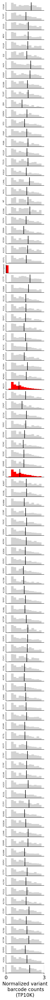

In [18]:
def plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=0.0005):
    fig, ax = plt.subplots(len(sorted_variants),1)
    fig.set_size_inches(2,50)
    for idx in range(len(sorted_variants)):
        v=sorted_variants[idx]
        if v=='unassigned':
            color='red'
        else:
            color=var_expr_color[v]
        a=vbc_counts_clip.loc[vbc_counts_clip['mut.std']==v,'Normalized variant\n barcode counts']
        if v=='unassigned':
            a=[0.0]
        
        wt=vbc_counts_clip.loc[vbc_counts_clip['mut.std']=='WT','Normalized variant\n barcode counts']
        multi=5
        bins=[x/multi for x in range(int(maxi*multi))]
        #print(bins)
        outplot=sns.distplot(a, ax=ax[idx], kde=False,hist=True,
                             norm_hist=True,color=color,
                             kde_kws={"shade": False},bins=bins,
                            hist_kws=dict(alpha=1))
        ax[idx].set_xlim(mini,maxi)
        # Get the two lines from the axes to generate shading
        ###l1 = outplot.lines[0]

        # Get the xy data from the lines so that we can shade
        ##x1 = l1.get_xydata()[:,0]
        ##y1 = l1.get_xydata()[:,1]
        ##outplot.fill_between(x1,y1, color=color, alpha=1)
        med=np.median(a)
        ax[idx].axes.get_xaxis().set_ticks([])
        ax[idx].axes.get_yaxis().set_ticks([])
        ax[idx].spines['right'].set_visible(False)
        ax[idx].spines['top'].set_visible(False)
        ax[idx].axvline(x=med,color='black')
        ax[idx].set_xlabel('')
        ax[idx].set_ylabel(v,fontsize=5)
    ax[idx].set_xticks([mini,maxi])
    ax[idx].set_xlabel('Normalized variant\n barcode counts\n(TP10K)')
        
plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=3)
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.png',bbox_inches = "tight")

In [19]:
anno.columns

Index(['Variant', 'Variant.1', 'Position', 'From', 'To', 'mutation_type',
       'Count_pancan', 'Count_ExAC', 'control_status', 'control_color',
       'Library_synthesis', 'long_name', 'control_status2', 'text_color',
       'HotellingT2', 'FDR.HotellingT2', 'cluster_color', 'Cells/variant',
       'variant expression', 'variant_expression'],
      dtype='object')

In [22]:
anno['Control']=anno['control_color']
anno['Cluster']=anno['cluster_color']
anno['Cluster2']=anno['Cluster']
anno.loc['unassigned','Cluster2']='slateblue'

In [23]:
anno.loc['unassigned','variant_expression']=0

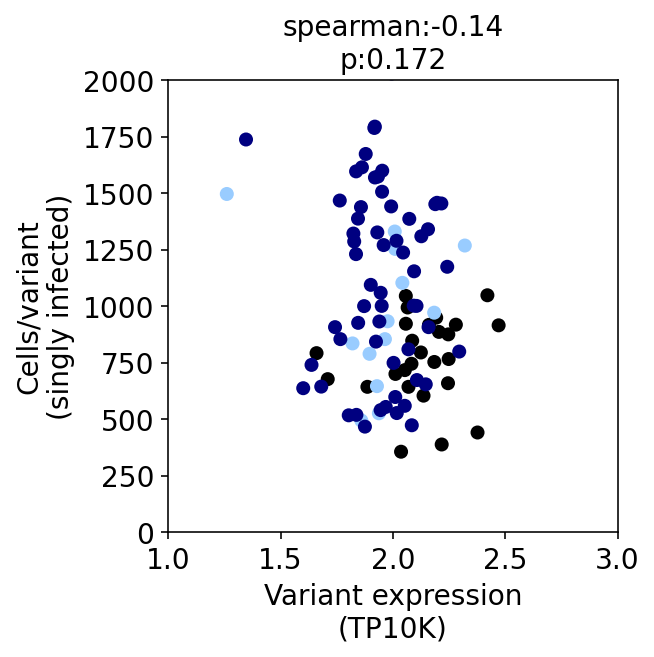

In [30]:
#average expression vs number of cells

def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))
    
fun_scatter(anno.loc[sorted_variants,'variant_expression'],
            anno.loc[sorted_variants,'Cells/variant'],
           c=anno.loc[sorted_variants,'Cluster'])
plt.ylim(0,2000)
plt.xlim(1,3)
plt.grid(False)
plt.xlabel('Variant expression\n(TP10K)')
plt.ylabel('Cells/variant\n(singly infected)')

plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr_vs_numcells.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr_vs_numcells.png',bbox_inches = "tight")

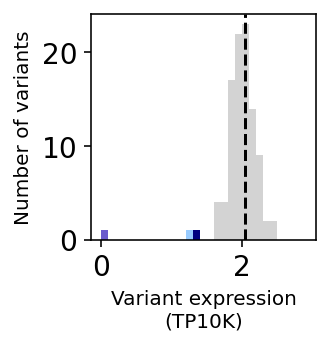

In [33]:
#histogram expression
fig,plots=plt.subplots(1)
fig.set_size_inches(2,2)
bins=[x/10 for x in range(30)]
plots.hist(anno.loc[sorted_variants,'variant_expression'],color='lightgray',
          bins=bins)
plots.axvline(x=anno.loc['WT','variant_expression'],
             color='black',linestyle='--')
for v in ['M237I','Y236C']:
    plots.hist(anno.loc[v,
        'variant_expression'],color=anno.loc[v,'cluster_color'],bins=bins)
plots.hist(anno.loc['unassigned',
        'variant_expression'],color='slateblue',bins=bins)
plots.grid(False)
plots.set_xlabel('Variant expression\n(TP10K)',fontsize=10)
plots.set_ylabel('Number of variants',fontsize=10)

plt.savefig(FIGS+'/'+PROTEIN+'.expr_hist.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.expr_hist.png',bbox_inches = "tight")

In [25]:
anno.to_csv(ANNO+'/'+PROTEIN+'.anno.withresults.csv',sep='\t')

Starting point
===

In [6]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

In [4]:
FDR=0.01
#original anno
ANNO=DATA+'/'+PROTEIN+'/anno'
anno=pd.read_csv(ANNO+'/'+PROTEIN+'.anno.withresults.csv',sep='\t',index_col=0)


#get the threshold
def get_threshold_at_FDR(fdr_data,method,FDR=0.1,higher=True):
    fdr_passed=fdr_data.loc[fdr_data['FDR.'+method]<=FDR,:]
    if higher:
        fdr_passed=fdr_passed.sort_values(by=method,ascending=True)
    else:
        fdr_passed=fdr_passed.sort_values(by=method,ascending=False)
    score_thresh_value=float(list(fdr_passed[method])[0])
    return(score_thresh_value)

score='HotellingT2'
score_thresh_value=get_threshold_at_FDR(anno,score,FDR=0.01,higher=True)
print(score_thresh_value)

70.28571362634686


In [5]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['P359P', 'T170T', 'D21D', 'A83V', 'P153P', 'E2E', 'P47P', 'P295P', 'R158R', 'T118T', 'Q5R', 'G360V', 'V31I', 'P36P', 'P58R', 'P222P', 'T312S', 'P301P', 'L344L', 'P47S', 'WT', 'E339K', 'Y107H', 'S366A', 'V216V', 'R337C', 'R337L', 'unassigned', 'C277F', 'R280K', 'R213Q', 'P152L', 'S241C', 'R273H', 'R273L', 'R273C', 'K132R', 'R158H', 'M246V', 'M237I', 'V272L', 'C242F', 'E271K', 'Y205C', 'G154V', 'Y234C', 'Y220C', 'G266E', 'Y236C', 'R280T', 'R158L', 'R248W', 'C238F', 'Y163C', 'G266V', 'A159V', 'E285K', 'G105C', 'G245C', 'H179R', 'K132N', 'S241F', 'R248L', 'V272M', 'H193R', 'G245S', 'P250L', 'C141Y', 'P278L', 'A159P', 'G244C', 'E286K', 'S127F', 'C238Y', 'V216M', 'V173L', 'V157F', 'C176Y', 'C176F', 'H214R', 'H193Y', 'R110L', 'C135Y', 'R249S', 'R282W', 'L194R', 'G266R', 'R249M', 'G245V', 'C275Y', 'H179Y', 'P151S', 'R175H', 'C135F', 'I195T', 'P278S', 'V173M', 'G245D', 'H193L', 'C275F']


In [6]:
anno.columns

Index(['Variant.1', 'Variant.1.1', 'Position', 'From', 'To', 'mutation_type',
       'Count_pancan', 'Count_ExAC', 'control_status', 'control_color',
       'Library_synthesis', 'long_name', 'control_status2', 'text_color',
       'HotellingT2', 'FDR.HotellingT2', 'cluster_color', 'Cells/variant',
       'variant expression', 'variant_expression', 'Control', 'Cluster',
       'Cluster2'],
      dtype='object')

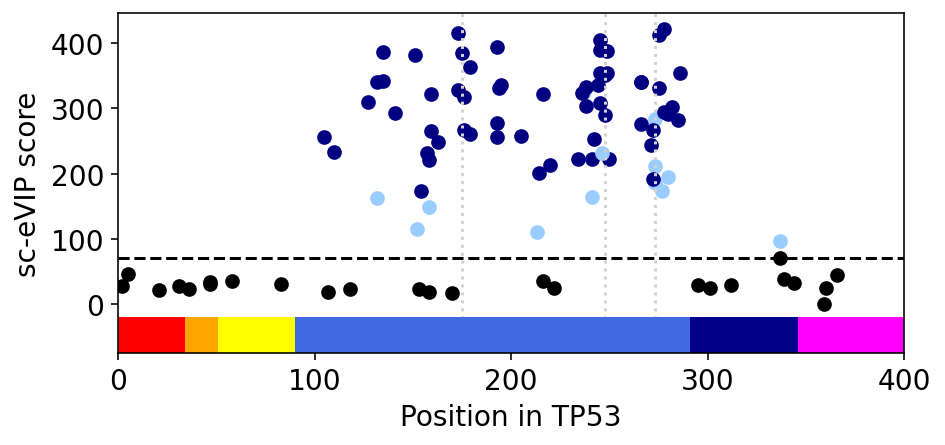

In [5]:
#overlay on the structure of p53
figwidth=7
figheight=3
fig = plt.figure()
plots = fig.add_subplot(111)
fig.set_size_inches(figwidth,figheight)

#175, 248, and 273 highlighted
plots.axvline(x=175,linestyle='dotted',color='lightgray',ymin=-0.5,ymax=1)
plots.axvline(x=248,linestyle='dotted',color='lightgray',ymin=-0.5,ymax=1)
plots.axvline(x=273,linestyle='dotted',color='lightgray',ymin=-0.5,ymax=1)

plots.axhline(y=(score_thresh_value)+50,linestyle='--',color='black')

#transactivation domains
lw=20
plots.plot(range(1,43),[-1 for i in range(42)],linewidth=lw,color='red')
plots.plot(range(44,60),[-1 for i in range(16)],linewidth=lw,color='orange')
plots.plot(range(61,99),[-1 for i in range(38)],linewidth=lw,color='yellow')
plots.plot(range(100,300),[-1 for i in range(200)],linewidth=lw,color='royalblue')
plots.plot(range(301,355),[-1 for i in range(54)],linewidth=lw,color='darkblue')
plots.plot(range(356,393),[-1 for i in range(37)],linewidth=lw,color='magenta')


#plots.axvline(x=61)
plots.set_xlim(0,400)
#plots.set_ylim(-1.5,5)
#plots.set_xticklabels([0,50,100,150,200,250,300,350,400])
plots.set_xticks([0,100,200,300,400])
plots.grid(False)


for var_idx in anno.index:
    pos=anno.loc[var_idx,'Position']
    #color by the variant type
    mut_col=anno.loc[var_idx,'Cluster']
    control_status=anno.loc[var_idx,'control_status']
    #if control_status in ['ExAC']:
    #    continue
    y_value=(anno.loc[var_idx,score]+50)
    if not np.isnan(y_value):
        plots.scatter([pos],[y_value],color=mut_col,s=40)

plots.set_yticks([50,150,250,350,450])
plots.set_yticklabels([0,100,200,300,400])
plots.set_ylabel('sc-eVIP score')
plots.set_xlabel('Position in TP53')

plt.savefig(FIGS+'/'+PROTEIN+'.ontoStr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.ontoStr.png',bbox_inches = "tight")

In [6]:
import copy
def get_corr_mat(df,axis=0,corr_type='spearman'):
    
    from scipy.stats import spearmanr
    from scipy.stats import pearsonr
    
    if axis==0: #do it for rows
        df_here=np.array(copy.deepcopy(df))
    if axis==1:
        df_here=np.array(copy.deepcopy(df.T))
        
    corr_mat=np.zeros((df_here.shape[0],df_here.shape[0]))
    for i in range(df_here.shape[0]):
        #if i%10==0:
         #   display_progress(i,df_here.shape[0])
        for j in range(i,df_here.shape[0]):
            a=df_here[i,:]
            b=df_here[j,:]
            if np.std(a)==0 or np.std(b)==0:
                if corr_type in ['pearson','spearman']:
                    continue
            if corr_type=='pearson':
                val=pearsonr(a,b)[0]
            if corr_type=='spearman':
                val=spearmanr(a,b)[0]
            if corr_type=='diff':
                val=np.mean(np.abs(a-b))
            corr_mat[i,j]=val
            corr_mat[j,i]=val
    if axis==0: #do it for rows
        corr_mat=pd.DataFrame(corr_mat,index=df.index,columns=df.index)
    if axis==1: #do it for rows
        corr_mat=pd.DataFrame(corr_mat,index=df.columns,columns=df.columns)
    return(corr_mat)

sc_bulk=adata.uns['bulk.guide.compact']
corr_mat=get_corr_mat(sc_bulk,axis=0,corr_type='spearman')

In [7]:
#make a table of genes
sc_bulk.shape

(101, 1224)

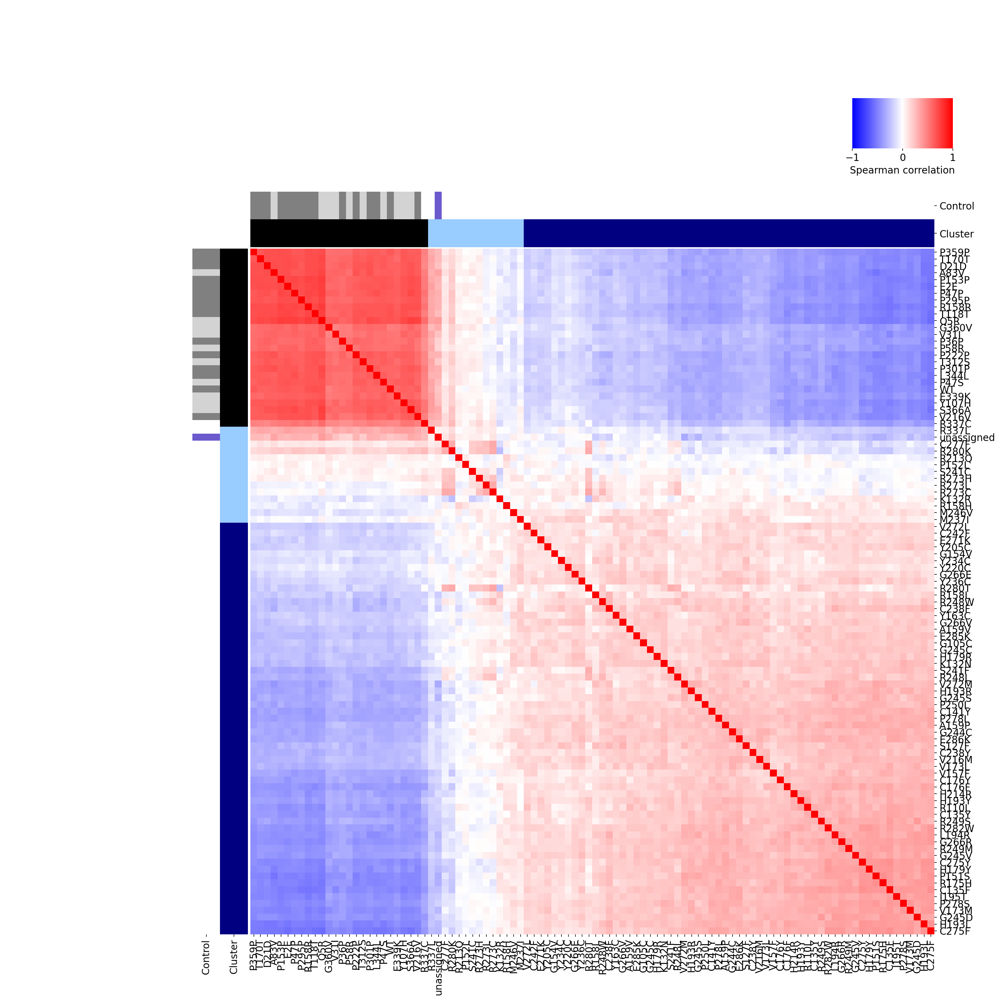

In [30]:
x=1
sns.clustermap(corr_mat.loc[sorted_variants,sorted_variants],
               cmap='bwr',vmin=-x,vmax=x,
               col_cluster=False,row_cluster=False,
              figsize=(20,20),xticklabels=True,yticklabels=True,
               cbar_pos=(0.85, 0.85, 0.1, 0.05),
                 cbar_kws={'orientation':'horizontal',
                "label": "Spearman correlation",
                'ticks':[-x,0,x]},
              row_colors=anno.loc[:,['Control','Cluster']],
              col_colors=anno.loc[:,['Control','Cluster']])

plt.savefig(FIGS+'/'+PROTEIN+'.corrMat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.corrMat.png',bbox_inches = "tight")

In [18]:
cls2=[]
for i in range(adata.n_obs):
    m=adata.obs['guide.compact'][i]
    if m=='unassigned':
        cl='slateblue'
    else:
        cl=adata.obs['Cluster'][i]
    cls2.append(cl)
adata.obs['cluster_color2']=cls2

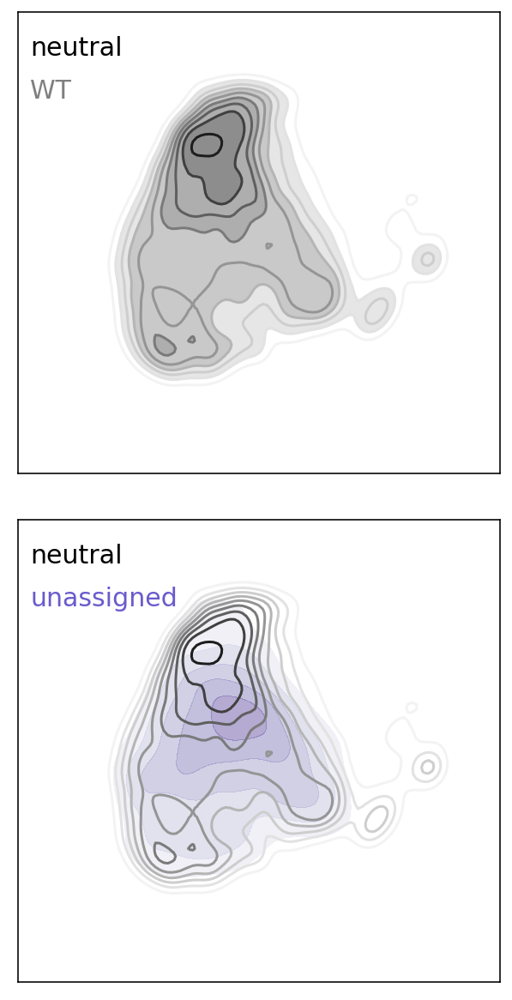

In [24]:
def sc_eVIP_plot(adata_subset,variant,ref1='uninfected',ref2='WT',variable_for_groups='mut.std',
                subsample_references=True,variant_color='Purples',variant_color2='blue',variant_label=''):
    
    coords=pd.DataFrame({'umap1':adata_subset.obsm['X_umap'][:,0],
                    'umap2':adata_subset.obsm['X_umap'][:,1],
                    'group':adata_subset.obs[variable_for_groups]})
    coords.index=adata_subset.obs_names
    fig, plots = plt.subplots(2,1)
    fig.set_size_inches(5,10)
    title_text=''
    le=5
    a=1
    maxi=0.025
    
    import matplotlib.gridspec as gridspec
    gs1 = gridspec.GridSpec(2,1)
    gs1.update(wspace=0.0, hspace=0.0) # set the spacing between axes. 
    fig.subplots_adjust(wspace=0.0, hspace=0.1)
        
    if subsample_references:
        cells_variant=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==variant]
        cells1=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==ref1]
        num_cells1=len(cells1)
        cells2=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==ref2]
        num_cells2=len(cells2)
        if num_cells1<num_cells2:
            cells2=cells2[:num_cells1]
        if num_cells1>num_cells2:
            cells1=cells1[:num_cells2]
        print(len(cells1),len(cells2),len(cells_variant))
        cells_keep=list(set(cells_variant).union(set(cells1).union(set(cells2))))
        coords=coords.loc[cells_keep,:]
    

    group=ref1
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap="Purples", shade=True, shade_lowest=False,alpha=a/2,n_levels=le,
                    ax=plots[1],vmax=0.03)#,vmax=maxi)
    group=variant
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap=variant_color, shade=False, shade_lowest=False,alpha=a,n_levels=le*2,ax=plots[1])

    group=ref2
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap='Greys', shade=True, shade_lowest=False,alpha=a/2,n_levels=le,
                    ax=plots[0])#,vmax=maxi)
    group=variant
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap=variant_color, shade=False, shade_lowest=False,alpha=a,n_levels=le*2,ax=plots[0])


    x=10
    xlim1,xlim2,ylim1,ylim2=-x,x,-5,15
    plots[1].set_xlim(xlim1,xlim2)
    plots[1].set_ylim(ylim1,ylim2)
    plots[0].set_xlim(xlim1,xlim2)
    plots[0].set_ylim(ylim1,ylim2)
    plots[1].grid(False)
    plots[0].grid(False)
    plots[1].set_xticks([])
    plots[1].set_yticks([])
    plots[0].set_xticks([])
    plots[0].set_yticks([])
    plots[1].set_xlabel('')
    plots[1].set_ylabel('')
    plots[0].set_xlabel('')
    plots[0].set_ylabel('')
    for idx in range(2):
        plots[idx].text(xlim1+0.5,ylim2-ylim2/8,variant_label,color=variant_color2,fontsize=15)
        if idx==1:
            plots[idx].text(xlim1+0.5,ylim2-2*ylim2/8,'unassigned',color='slateblue',fontsize=15)
        else:
            plots[idx].text(xlim1+0.5,ylim2-2*ylim2/8,'WT',color='gray',fontsize=15)

sc_eVIP_plot(adata,'black',ref1='slateblue',ref2='black',variant_color='Greys',variant_color2='black',
             variant_label='neutral',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_neutral.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_neutral.png',bbox_inches = "tight")

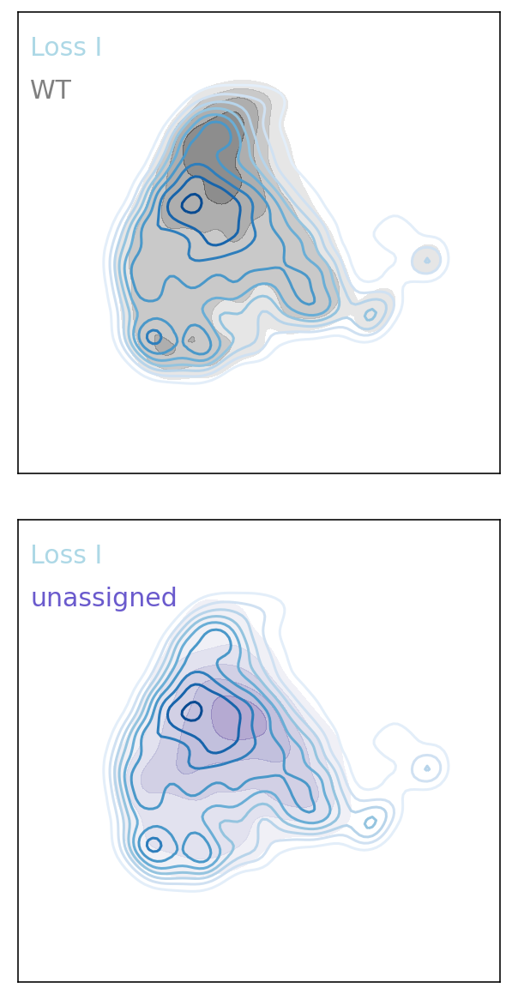

In [25]:
sc_eVIP_plot(adata,'#99CCFF',ref1='slateblue',ref2='black',variant_color='Blues',variant_color2='lightblue',
             variant_label='Loss I',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_loss1.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_loss1.png',bbox_inches = "tight")

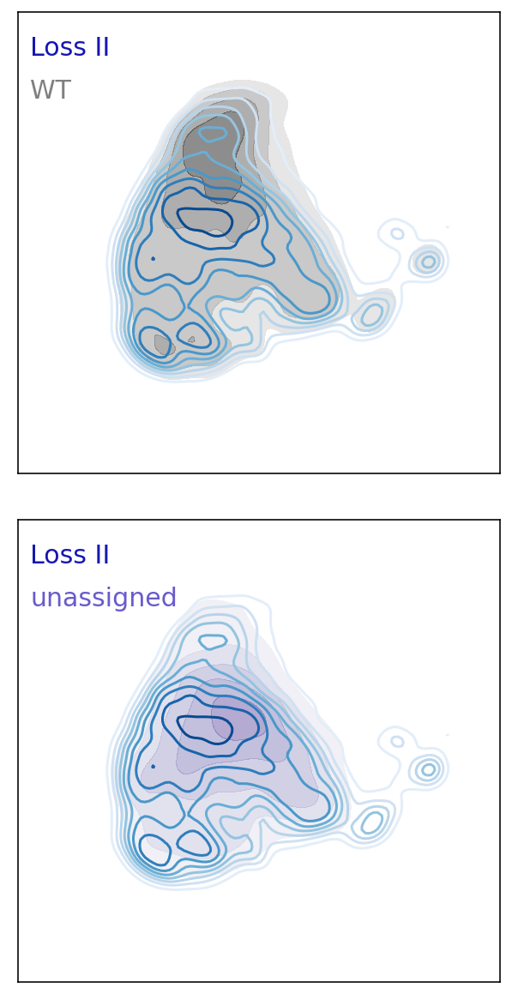

In [26]:
sc_eVIP_plot(adata,'navy',ref1='slateblue',ref2='black',variant_color='Blues',variant_color2='#1616B2',
             variant_label='Loss II',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_loss2.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_loss2.png',bbox_inches = "tight")

356 356 907


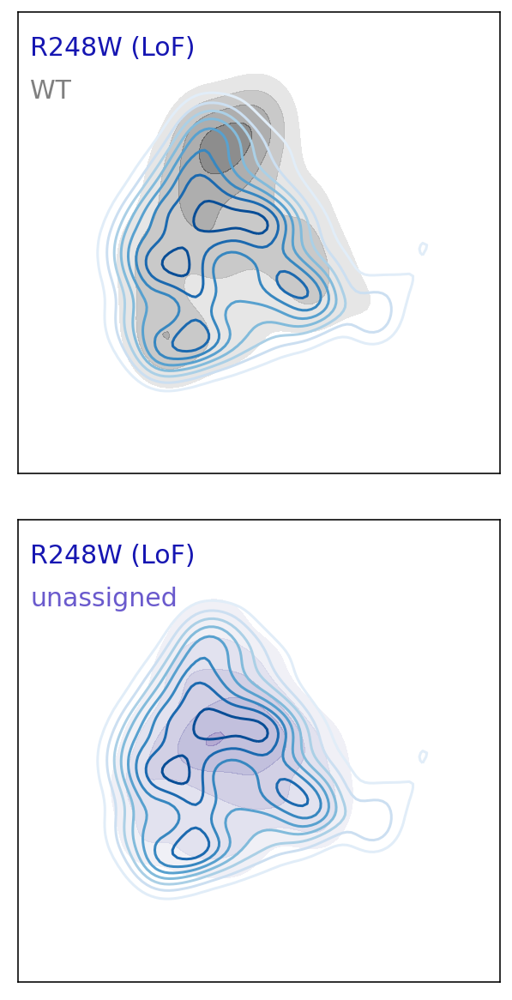

In [45]:
sc_eVIP_plot(adata,'R248W',ref1='unassigned',ref2='WT',variant_color='Blues',variant_color2='#1616B2',
             variant_label='R248W (LoF)',variable_for_groups='guide.compact')
plt.savefig(FIGS+'/'+PROTEIN+'.umap_R248W.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_R248W.png',bbox_inches = "tight")

356 356 1000


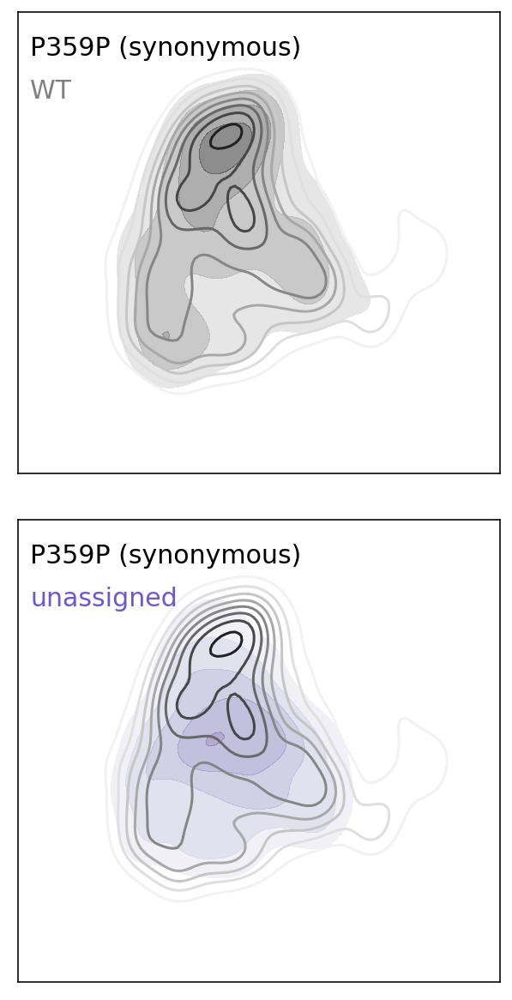

In [44]:
def sc_eVIP_plot(adata_subset,variant,ref1='uninfected',ref2='WT',variable_for_groups='mut.std',
                subsample_references=True,variant_color='Purples',variant_color2='blue',variant_label=''):
    
    coords=pd.DataFrame({'umap1':adata_subset.obsm['X_umap'][:,0],
                    'umap2':adata_subset.obsm['X_umap'][:,1],
                    'group':adata_subset.obs[variable_for_groups]})
    coords.index=adata_subset.obs_names
    fig, plots = plt.subplots(2,1)
    fig.set_size_inches(5,10)
    title_text=''
    le=5
    a=1
    maxi=0.025
    
    import matplotlib.gridspec as gridspec
    gs1 = gridspec.GridSpec(2,1)
    gs1.update(wspace=0.0, hspace=0.0) # set the spacing between axes. 
    fig.subplots_adjust(wspace=0.0, hspace=0.1)
        
    if subsample_references:
        cells_variant=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==variant]
        cells1=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==ref1]
        num_cells1=len(cells1)
        cells2=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==ref2]
        num_cells2=len(cells2)
        if num_cells1<num_cells2:
            cells2=cells2[:num_cells1]
        if num_cells1>num_cells2:
            cells1=cells1[:num_cells2]
        print(len(cells1),len(cells2),len(cells_variant))
        cells_keep=list(set(cells_variant).union(set(cells1).union(set(cells2))))
        coords=coords.loc[cells_keep,:]
    

    group=ref1
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap="Purples", shade=True, shade_lowest=False,alpha=a/2,n_levels=le,
                    ax=plots[1],vmax=0.03)#,vmax=maxi)
    group=variant
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap=variant_color, shade=False, shade_lowest=False,alpha=a,n_levels=le*2,ax=plots[1])

    group=ref2
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap='Greys', shade=True, shade_lowest=False,alpha=a/2,n_levels=le,
                    ax=plots[0])#,vmax=maxi)
    group=variant
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap=variant_color, shade=False, shade_lowest=False,alpha=a,n_levels=le*2,ax=plots[0])


    x=10
    xlim1,xlim2,ylim1,ylim2=-x,x,-5,15
    plots[1].set_xlim(xlim1,xlim2)
    plots[1].set_ylim(ylim1,ylim2)
    plots[0].set_xlim(xlim1,xlim2)
    plots[0].set_ylim(ylim1,ylim2)
    plots[1].grid(False)
    plots[0].grid(False)
    plots[1].set_xticks([])
    plots[1].set_yticks([])
    plots[0].set_xticks([])
    plots[0].set_yticks([])
    plots[1].set_xlabel('')
    plots[1].set_ylabel('')
    plots[0].set_xlabel('')
    plots[0].set_ylabel('')
    for idx in range(2):
        plots[idx].text(xlim1+0.5,ylim2-ylim2/8,variant_label,color=variant_color2,fontsize=15)
        if idx==1:
            plots[idx].text(xlim1+0.5,ylim2-2*ylim2/8,'unassigned',color='slateblue',fontsize=15)
        else:
            plots[idx].text(xlim1+0.5,ylim2-2*ylim2/8,'WT',color='gray',fontsize=15)

sc_eVIP_plot(adata,'P359P',ref1='unassigned',ref2='WT',variant_color='Greys',variant_color2='black',
             variant_label='P359P (synonymous)',variable_for_groups='guide.compact')
plt.savefig(FIGS+'/'+PROTEIN+'.umap_P359P.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_P359P.png',bbox_inches = "tight")

Effect size
==

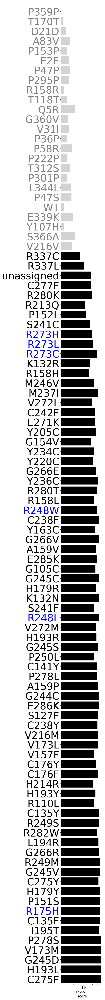

In [32]:
colors=[]
for i in sorted_variants[::-1]:
    if anno.loc[i,score]<score_thresh_value:
        colors_app='lightgray'
    else:
        colors_app='black'
    colors.append(colors_app)

fig,plots = plt.subplots(1,1)
fig.set_size_inches(3,69)
anno[score]=anno[score].astype(float)
plots.barh(sorted_variants[::-1],list(anno.loc[sorted_variants[::-1],score]),
          color=colors)
plots.set_ylim(-0.5,len(sorted_variants[::-1]))
plots.spines['top'].set_visible(False)
plots.spines['right'].set_visible(False)
plots.spines['bottom'].set_visible(True)
plots.spines['left'].set_visible(True)
plots.set_xlabel('sc-eVIP\nscore')
plots.set_xscale('log')
plots.set_yticks(sorted_variants[::-1])
plots.set_yticklabels(sorted_variants[::-1])
plots.set_yticklabels(plots.get_yticklabels(), fontsize=40)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]

plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.png',bbox_inches = "tight")

In [33]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


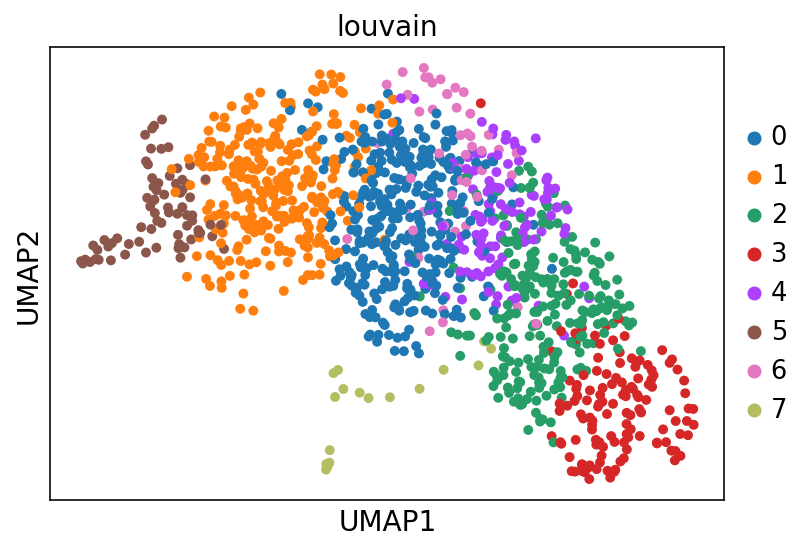

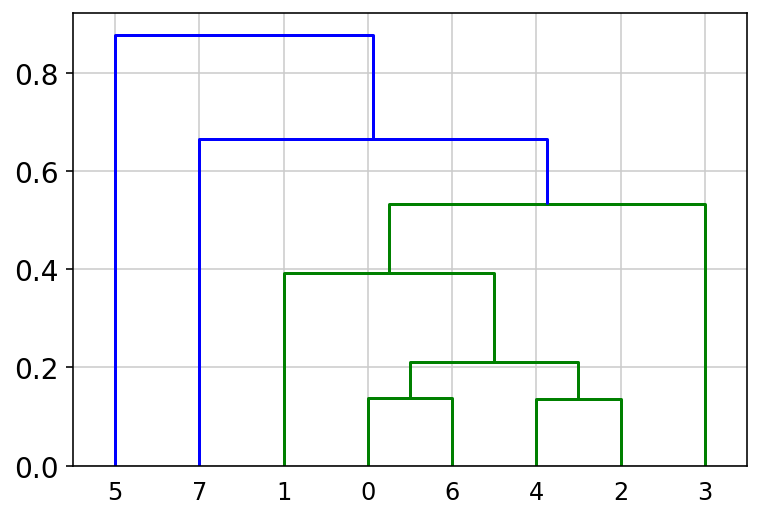

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 4 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


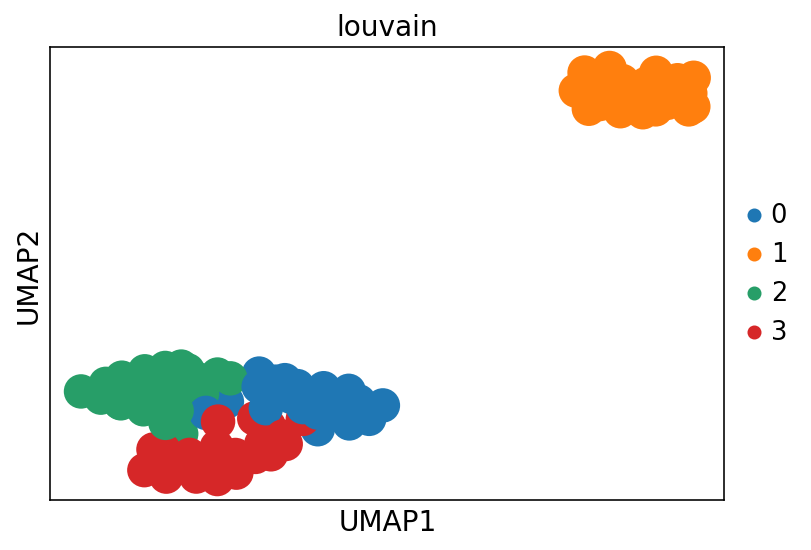

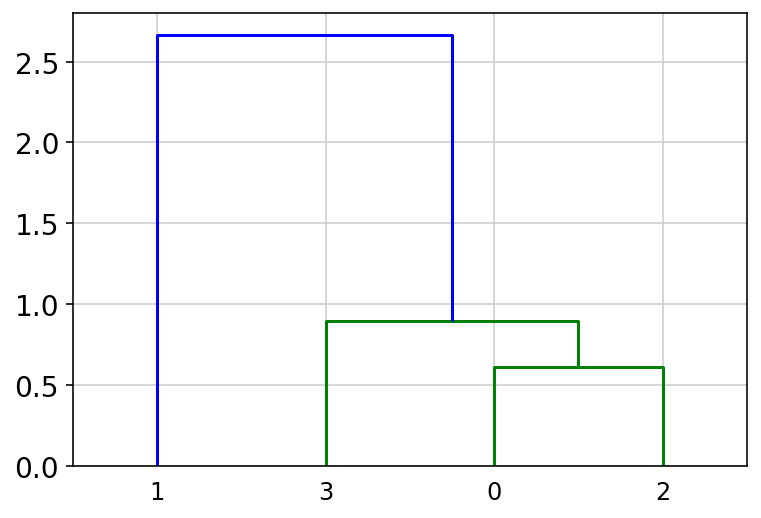

In [34]:
perturb.tl.gene_programs_and_perturbation_modules(adata,cluster_within=False,
                                                  cmap_programs='Paired')

In [35]:
adata

AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

In [36]:
sc_bulk=adata.uns['bulk.guide.compact'].T.loc[adata.var_names,sorted_variants]
sc_bulk['module']=adata.var['bulk.guide.compact.program']
sc_bulk=sc_bulk.sort_values(by='module')
sc_bulk=sc_bulk.drop(columns=['module'])

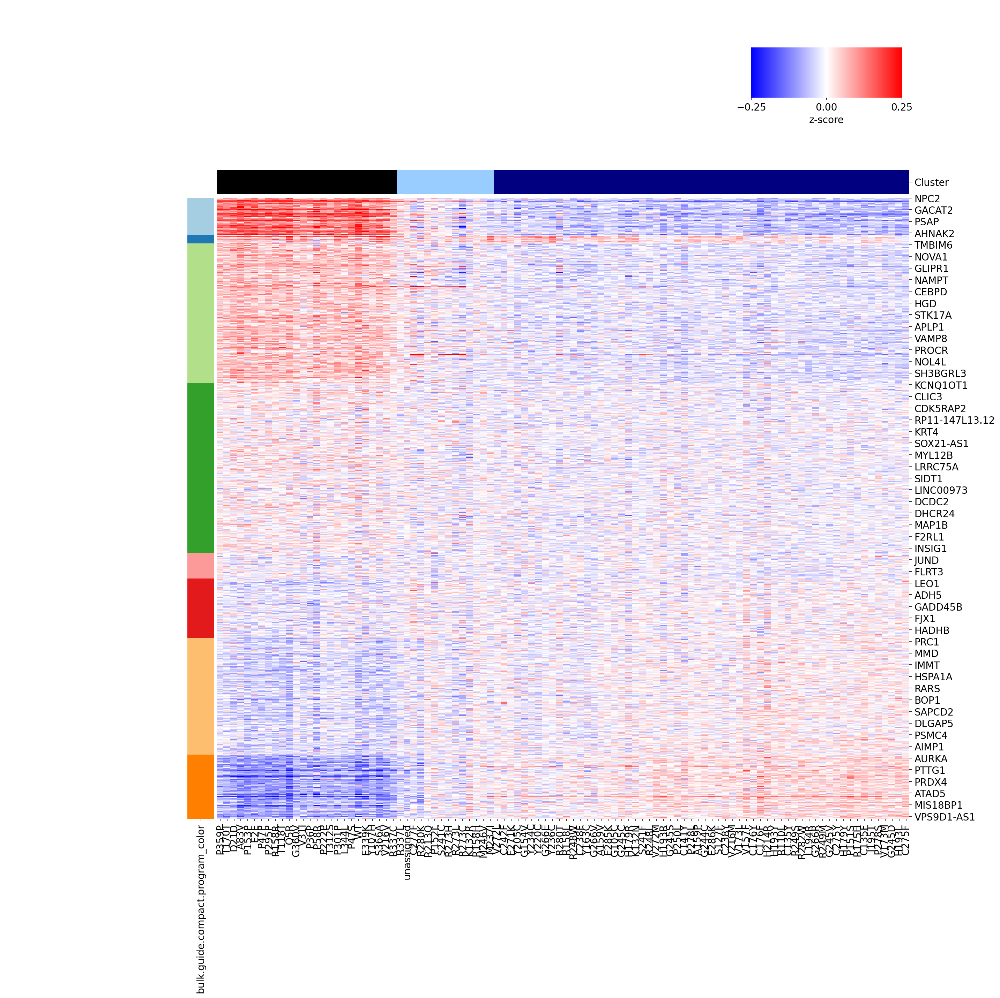

In [37]:
x=0.25
sns.clustermap(sc_bulk,
    #adata.uns['bulk.guide.compact'].T.loc[:,sorted_variants],
               row_cluster=False,col_cluster=False,
               xticklabels=True,
               figsize=(20,20),
               cbar_pos=(0.75, 0.9, 0.15, 0.05),
                 cbar_kws={'orientation':'horizontal',
                "label": "z-score",
                'ticks':[-x,0,x]},
               cmap='bwr',vmin=-x,vmax=x,
              row_colors=adata.var['bulk.guide.compact.program_color'],
               col_colors=anno.loc[:,'Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.regMat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.regMat.png',bbox_inches = "tight")

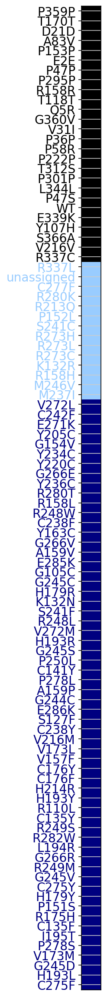

In [8]:
fig,plots = plt.subplots(1,1)
fig.set_size_inches(0.4,20)

plots.barh(anno.loc[sorted_variants[::-1],'Variant.1'],1.1,
         color=anno.loc[sorted_variants[::-1],'Cluster'],
          height=1)
plots.set_xlim(0,1.0)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
plots.set_xticks([])
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'Cluster'],plots.yaxis.get_ticklabels())]


plt.savefig(FIGS+'/'+PROTEIN+'.clusterColors.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.clusterColors.png',bbox_inches = "tight")



In [38]:
def score_programs(adata_here,program_name='bulk.guide.compact.program',
                  pref=None,copy=False):
    
    if copy: adata_here = adata_here.copy()
    
    if pref is None:
        pref=program_name
    programs=list(set(adata_here.var[program_name]))
    for pro in programs:
        print('scoring',pro)
        pro_genes=adata_here.var_names[adata_here.var[program_name]==pro]
        adata.obs[pref+str(pro)]=adata[:,pro_genes].X.mean(axis=1)
        
    if copy:
        return(adata_here)
    
score_programs(adata,pref='P')

scoring 0
scoring 1
scoring 2
scoring 3
scoring 4
scoring 5
scoring 6
scoring 7


In [39]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

... storing 'bulk.guide.compact.program_color' as categorical


Starting point
==

In [5]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

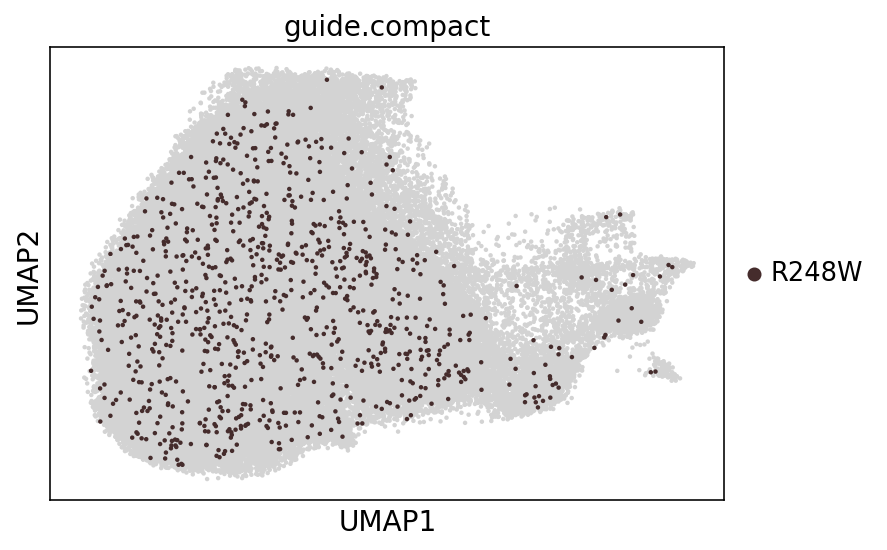

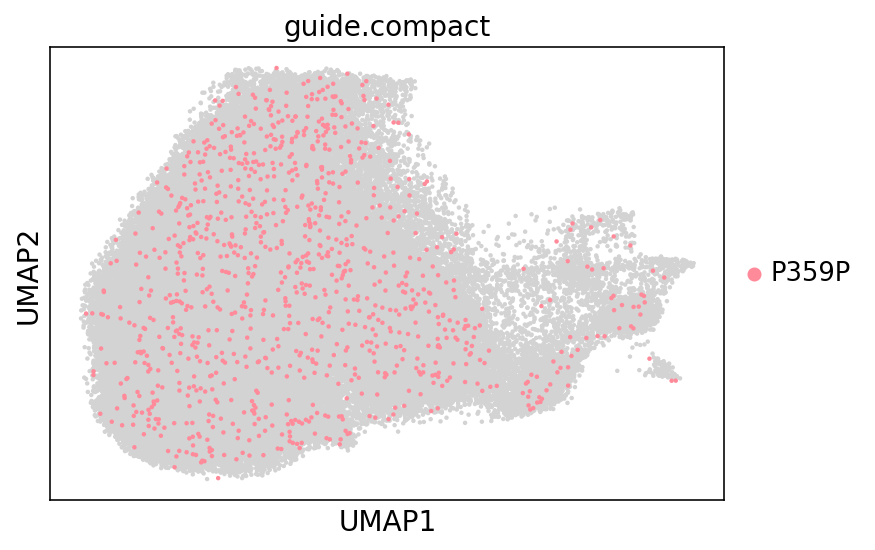

In [7]:
sc.pl.umap(adata,color=['guide.compact'],groups=['R248W'],s=20)
sc.pl.umap(adata,color=['guide.compact'],groups=['P359P'],s=20)

In [41]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['P359P', 'T170T', 'D21D', 'A83V', 'P153P', 'E2E', 'P47P', 'P295P', 'R158R', 'T118T', 'Q5R', 'G360V', 'V31I', 'P36P', 'P58R', 'P222P', 'T312S', 'P301P', 'L344L', 'P47S', 'WT', 'E339K', 'Y107H', 'S366A', 'V216V', 'R337C', 'R337L', 'unassigned', 'C277F', 'R280K', 'R213Q', 'P152L', 'S241C', 'R273H', 'R273L', 'R273C', 'K132R', 'R158H', 'M246V', 'M237I', 'V272L', 'C242F', 'E271K', 'Y205C', 'G154V', 'Y234C', 'Y220C', 'G266E', 'Y236C', 'R280T', 'R158L', 'R248W', 'C238F', 'Y163C', 'G266V', 'A159V', 'E285K', 'G105C', 'G245C', 'H179R', 'K132N', 'S241F', 'R248L', 'V272M', 'H193R', 'G245S', 'P250L', 'C141Y', 'P278L', 'A159P', 'G244C', 'E286K', 'S127F', 'C238Y', 'V216M', 'V173L', 'V157F', 'C176Y', 'C176F', 'H214R', 'H193Y', 'R110L', 'C135Y', 'R249S', 'R282W', 'L194R', 'G266R', 'R249M', 'G245V', 'C275Y', 'H179Y', 'P151S', 'R175H', 'C135F', 'I195T', 'P278S', 'V173M', 'G245D', 'H193L', 'C275F']


In [37]:
my_programs=['P'+str(x) for x in range(8)]

In [5]:
#dotplots in all their glory
def get_bulk_programs(adata_here,score_names,
                               variant_col='mut.std',fdr=0.1):
    
    variants=list(set(adata_here.obs[variant_col]))
    programs=score_names
    
    bulk_programs=pd.DataFrame(0,index=variants,columns=programs)
    p=pd.DataFrame(1,index=variants,columns=programs)
    
    #get scores of ref
    ref_scores={}
    for cl in programs:
        print(cl)
        for variant in variants:
            variant_values=adata_here[adata_here.obs[variant_col]==variant,:].obs[cl]
            bulk_programs.loc[variant,cl]=np.mean(variant_values)

    return(bulk_programs)

In [44]:
bulk_programs_values=get_bulk_programs(adata,my_programs,
                                           variant_col='guide.compact',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7


In [7]:
#dotplots in all their glory
def get_bulk_programs_with_sig(adata_here,score_names,ref='unassigned',
                               variant_col='mut.std',fdr=0.1):
    
    variants=list(set(adata_here.obs[variant_col]))
    programs=score_names
    
    bulk_programs=pd.DataFrame(0,index=variants,columns=programs)
    p=pd.DataFrame(1,index=variants,columns=programs)
    
    #get scores of ref
    ref_scores={}
    for cl in programs:
        print(cl)
        if ref is None:
            ref_values=adata_here.obs[cl]
        else:
            ref_values=adata_here[adata_here.obs[variant_col]==ref,:].obs[cl]
        for variant in variants:
            variant_values=adata_here[adata_here.obs[variant_col]==variant,:].obs[cl]
            from scipy.stats import ks_2samp
            ksp=ks_2samp(ref_values,variant_values)[1]
            diff=np.mean(variant_values)-np.mean(ref_values)
            bulk_programs.loc[variant,cl]=diff
            p.loc[variant,cl]=ksp
    #will need multiple testing on the pvalues
    pval_m=p
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    p=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)

    return(bulk_programs,p)
        

In [46]:
bulk_programs_wt,p_wt=get_bulk_programs_with_sig(adata,my_programs,
                                           ref='WT',variant_col='guide.compact',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7


In [15]:
bulk_programs,p=get_bulk_programs_with_sig(adata,my_programs,
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7


In [48]:
adata.uns['bulk.programs.vs_unassigned.avg']=bulk_programs
adata.uns['bulk.programs.vs_unassigned.p']=p
adata.uns['bulk.programs.vs_WT.avg']=bulk_programs_wt
adata.uns['bulk.programs.vs_WT.p']=p_wt

In [49]:
adata.uns['bulk.programs.avg']=bulk_programs_values

In [52]:
adata

AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

In [53]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

Starting point
==

In [11]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

In [4]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['P359P', 'T170T', 'D21D', 'A83V', 'P153P', 'E2E', 'P47P', 'P295P', 'R158R', 'T118T', 'Q5R', 'G360V', 'V31I', 'P36P', 'P58R', 'P222P', 'T312S', 'P301P', 'L344L', 'P47S', 'WT', 'E339K', 'Y107H', 'S366A', 'V216V', 'R337C', 'R337L', 'unassigned', 'C277F', 'R280K', 'R213Q', 'P152L', 'S241C', 'R273H', 'R273L', 'R273C', 'K132R', 'R158H', 'M246V', 'M237I', 'V272L', 'C242F', 'E271K', 'Y205C', 'G154V', 'Y234C', 'Y220C', 'G266E', 'Y236C', 'R280T', 'R158L', 'R248W', 'C238F', 'Y163C', 'G266V', 'A159V', 'E285K', 'G105C', 'G245C', 'H179R', 'K132N', 'S241F', 'R248L', 'V272M', 'H193R', 'G245S', 'P250L', 'C141Y', 'P278L', 'A159P', 'G244C', 'E286K', 'S127F', 'C238Y', 'V216M', 'V173L', 'V157F', 'C176Y', 'C176F', 'H214R', 'H193Y', 'R110L', 'C135Y', 'R249S', 'R282W', 'L194R', 'G266R', 'R249M', 'G245V', 'C275Y', 'H179Y', 'P151S', 'R175H', 'C135F', 'I195T', 'P278S', 'V173M', 'G245D', 'H193L', 'C275F']


In [27]:
my_programs=['P'+str(x) for x in range(8)]

In [8]:
def dotplot_programs(bulk_programs,p,myorder,sorted_variants,
                     best_p=1e-5,fdr=0.01,vmin=-0.5,vmax=0.5,w=5,h=25,
                    title='Difference',cbar_percent="5%",widths=[1,1]):
    
    
    mlog_bestp=-np.log10(best_p)
    
    bulk_programs_long=pd.DataFrame(bulk_programs.loc[sorted_variants[::-1],myorder[::-1]].unstack())   
    idx=bulk_programs_long.index.to_frame()
    bulk_programs_long['variants']=idx[1]
    bulk_programs_long['cl']=idx[0]
    
    p_long=pd.DataFrame(p.loc[sorted_variants[::-1],myorder[::-1]].unstack()) 
    idx=p_long.index.to_frame()
    p_long['variants']=idx[1]
    p_long['cl']=idx[0]
    
    
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(clip=True,vmin=vmin,vmax=vmax)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.bwr)
    colors=mapper.to_rgba(bulk_programs_long[0])

    #fig,plots=plt.subplots(1,2)
    #fig.set_size_inches(w,h)
    from matplotlib import gridspec

    fig = plt.figure()
    spec = gridspec.GridSpec(ncols=2, nrows=1,
                     width_ratios=widths)
    fig.set_size_inches(w,h)
    plots = [fig.add_subplot(spec[0]),fig.add_subplot(spec[1])]
    
    mini_size=1
    x_vector=bulk_programs_long['cl']
    y_vector=bulk_programs_long['variants']
    sizes=p_long[0]
    sizes[sizes<best_p]=best_p
    borders=0.5*(sizes<=fdr)*1.0
    sizes=-np.log10(sizes)*100.0/(-np.log10(best_p))
    
    scatter_output=plots[0].scatter(x_vector,y_vector,
                       c=colors,s=sizes,
                       edgecolor='black',
                         linewidth=borders)
    
    plots[0].grid(False)
    plots[0].set_xticks(myorder)
    plots[0].set_xticklabels(myorder)
    plots[0].set_xticklabels(plots[0].get_xticklabels(), rotation=270)
    plots[0].set_ylim(-0.5,len(sorted_variants)-0.5)
    plots[0].set_xlim(-0.5,len(myorder)-0.5)
    
    #sizes
    handles, labels = scatter_output.legend_elements(prop="sizes", alpha=0.6,num=5)
    labels2=[]
    import re
    for i in range(len(labels)):
        i_num=float(re.sub('\$\\\\mathdefault{','',re.sub('}\$','',labels[i])))
        i_num_processed=np.power(10,1.0*i_num*np.log10(best_p)/100.0)
        i_num_processed=i_num/100.0*(-np.log10(best_p))
        labels2.append(i_num_processed)
    min_size=labels2[0]
    max_size=labels2[len(labels2)-1]
    min_handle=handles[0]
    labels_ends=[min_size,max_size]
    handles_ends=[handles[0],handles[len(handles)-1]]
    legend2 = plots[1].legend(handles_ends, labels_ends, loc="upper right", title="P-value\n-log10(p)")
    
    plots[1].grid(False)
    plots[1].set_xticks([])
    plots[1].set_yticks([])
    plots[1].spines['right'].set_visible(False)
    plots[1].spines['left'].set_visible(False)
    plots[1].spines['top'].set_visible(False)
    plots[1].spines['bottom'].set_visible(False)
    
    import matplotlib as mpl
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    divider = make_axes_locatable(plots[1])
    cax = divider.append_axes("bottom", size=cbar_percent, pad=0.25)
    cb=fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cm.bwr), 
                    cax=cax,orientation='horizontal',
                   cmap=cm.bwr)
    cb.set_label(title)

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


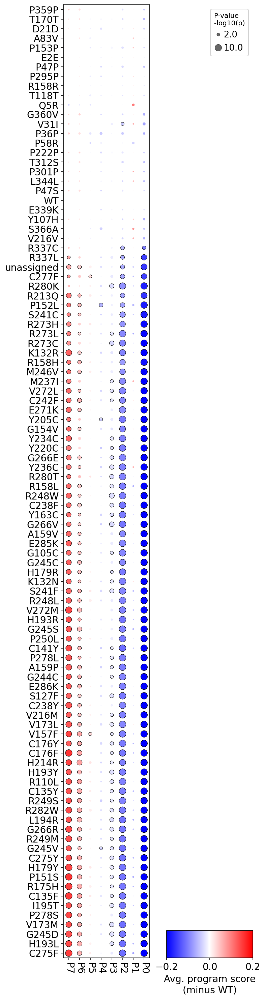

In [9]:
dotplot_programs(adata.uns['bulk.programs.vs_WT.avg'],
                 adata.uns['bulk.programs.vs_WT.p'],
                 myorder=my_programs,
                 sorted_variants=sorted_variants,
                 best_p=1e-10,
                 vmin=-0.2,vmax=0.2,
                title='Avg. program score\n(minus WT)',
                cbar_percent='3%')

plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_WT.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_WT.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


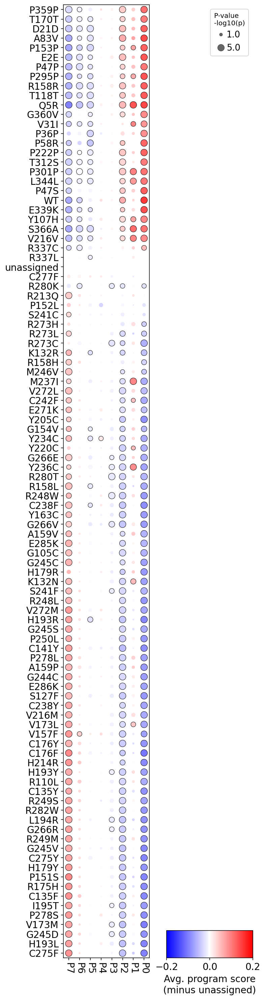

In [10]:
dotplot_programs(adata.uns['bulk.programs.vs_unassigned.avg'],
                 adata.uns['bulk.programs.vs_unassigned.p'],
                 myorder=my_programs,
                 sorted_variants=sorted_variants,
                 best_p=1e-5,
                 vmin=-0.2,vmax=0.2,
                title='Avg. program score\n(minus unassigned)',
                cbar_percent='3%')

plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_unassigned.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_unassigned.png',bbox_inches = "tight")

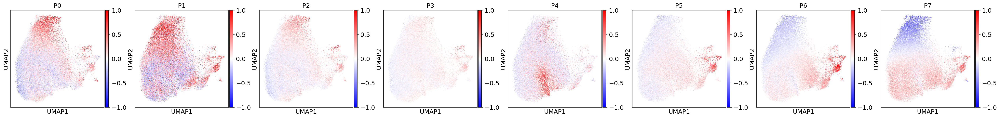

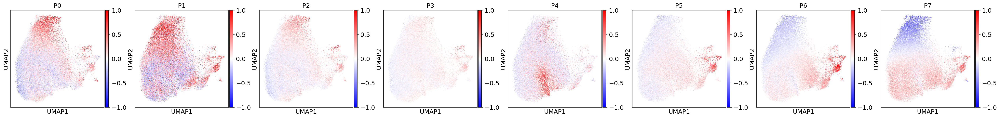

In [11]:
#plot the umaps
x=1
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=my_programs,cmap='bwr',ncols=len(my_programs),vmin=-x,vmax=x,
          save=PROTEIN+'_program_scores.pdf')
sc.pl.umap(adata,color=my_programs,cmap='bwr',ncols=len(my_programs),vmin=-x,vmax=x,
          save=PROTEIN+'_program_scores.png')

In [8]:
def ecdf_program(adata_here,score_names,grouping_variable,grouping_variable_color):
    
    n_pro=len(score_names)
    fig,plots=plt.subplots(1,n_pro)
    fig.set_size_inches(n_pro*3,2)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    c=0
    for cl_idx in range(len(score_names)):
        cl=score_names[cl_idx]
        big_number=100

        plotting_data=pd.DataFrame({'to_plot':adata_here.obs[cl],
                                       'group':adata_here.obs[grouping_variable]})

        for group in list(set(plotting_data['group'])):
            
            chosen_color=grouping_variable_color.loc[group]
            a=plotting_data.loc[plotting_data['group']==group,'to_plot']
            mini=np.quantile(plotting_data['to_plot'],0.00001)
            maxi=np.quantile(plotting_data['to_plot'],0.99)

            steps=5000
            bins=[mini+(x*1.00)/steps*(maxi-mini) for x in range(steps)]
            bins.append(big_number)
            n, bins2, patches=plots[c].hist(a,
                cumulative=True,color=chosen_color,histtype='step',density=True,bins=bins)
            plots[c].grid(False)
            plots[c].set_xlabel(cl)
            plots[c].set_title(cl)

        plots[c].set_xlim(mini,maxi)
        #plots[c].set_xticks([round(mini,2),round(maxi,2)])
        if c==0:
            plots[c].set_ylabel('ECDF')
            plots[c].set_yticks([0,1])
        else:
            plots[c].set_yticks([0,1])
        c+=1

P0 ['CDKN1A', 'NEAT1', 'GPX1', 'FDXR', 'RPS27L', 'TP53TG1', 'PHLDA3', 'ALDH1A1', 'SAT1', 'MXD4']
(10, 100)
P1 ['GNB2L1', 'EEF1A1', 'RPS4X', 'RPS27A', 'RPS3', 'LDHB', 'EIF3E', 'SLC25A3', 'RPL28', 'EEF2']
(10, 100)
P2 ['ZMAT3', 'LINC01021', 'STOM', 'PAPPA', 'SH3BGRL3', 'TIMP2', 'BTG2', 'DDB2', 'KRT8', 'VAMP8']
(10, 100)
P3 ['BCL2L1', 'TP53I11', 'BICC1', 'DOK4', 'VCAN', 'CFH', 'UBR4', 'GPCPD1', 'SIDT1', 'HACD3']
(10, 100)
P4 ['PTPRS', 'CDC42', 'B4GALT1', 'HNRNPH1', 'CAPZA1', 'NUDT19', 'CBX6', 'C1orf56', 'CTTN', 'CTNNB1']
(10, 100)
P5 ['RPN2', 'FEN1', 'COPS6', 'APOC1', 'AFMID', 'PCMT1', 'FANCD2', 'TTC39C', 'PPIB', 'ANXA7']
(10, 100)
P6 ['PRDX1', 'ENO1', 'TUBB4B', 'TXN', 'PDIA6', 'SMC4', 'RBM42', 'CCT7', 'CDC20', 'HSPA9']
(10, 100)
P7 ['UBE2S', 'BIRC5', 'TUBA1B', 'CENPA', 'UBE2C', 'SET', 'GINS2', 'HIST1H4C', 'RAN', 'MTHFD2']
(10, 100)


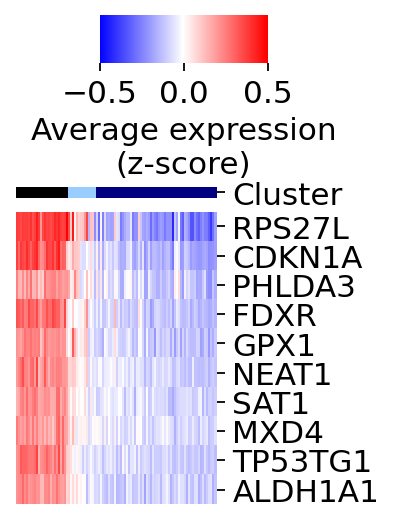

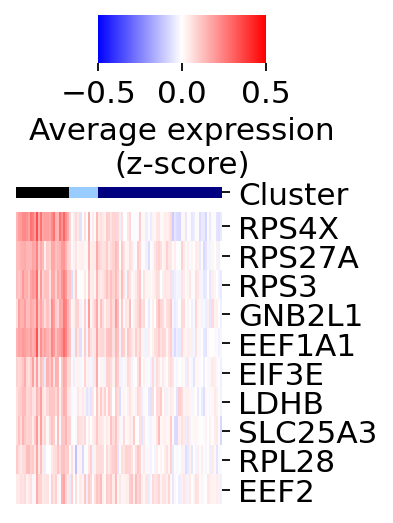

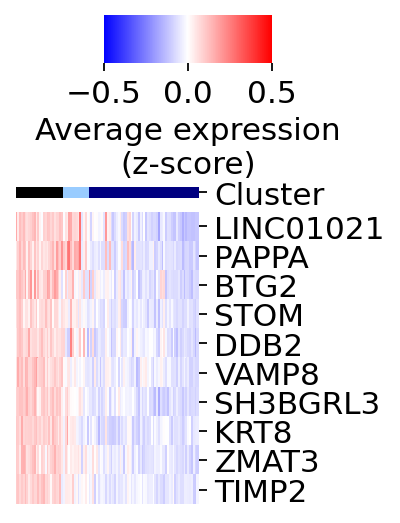

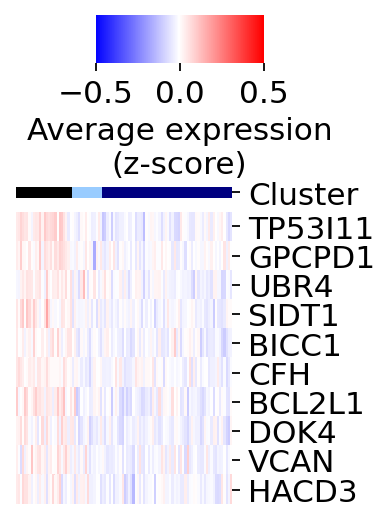

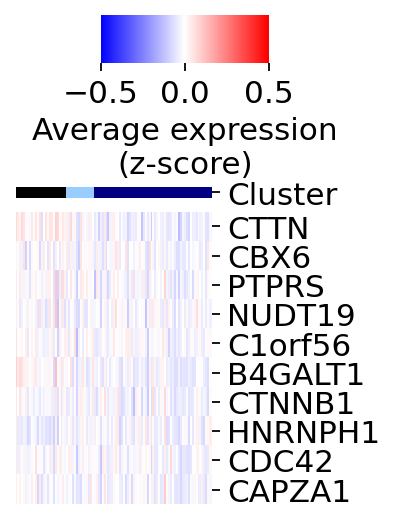

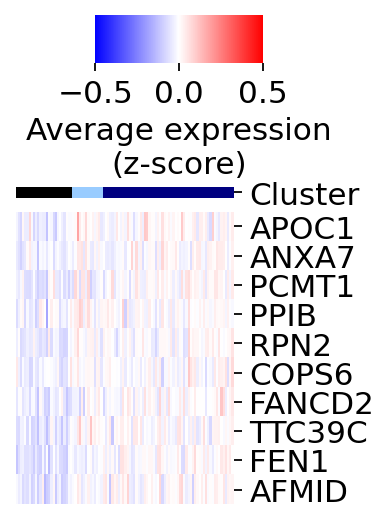

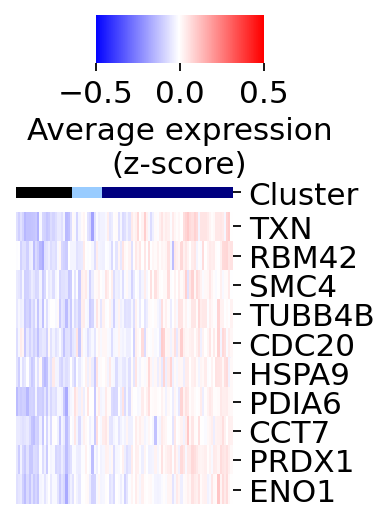

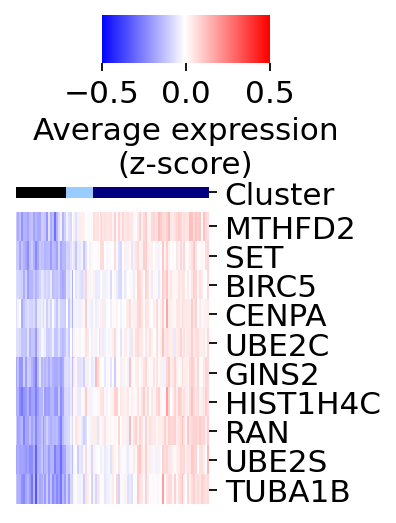

In [19]:
n=10
x=0.5
pref='P'
pro_variable='bulk.guide.compact.program'
score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']

for cl in score_names:
    genes_cl=adata.var_names[adata.var[pro_variable]==cl]
    gene_corr=pd.DataFrame({'gene':genes_cl,'corr':0},index=genes_cl)
    for gene in genes_cl:
        from scipy.stats import spearmanr,pearsonr
        c=spearmanr(sc_bulk.loc[sorted_variants,gene],
                   bulk_programs.loc[sorted_variants,pref+str(cl)])[0]
        gene_corr.loc[gene,'corr']=c
    genes_top=list(gene_corr.sort_values(by='corr',ascending=False)['corr'][:n].index)
    print(pref+str(cl),genes_top)
    
    
    print(sc_bulk.loc[sorted_variants,genes_top].T.shape)
    g=sns.clustermap(sc_bulk.loc[sorted_variants,genes_top].T,cmap='bwr',vmin=-x,vmax=x,
                  col_cluster=False,figsize=(3,3),
                     cbar_pos=(0.35, 1, 0.35, 0.1),
                 cbar_kws={'orientation':'horizontal',
                "label": "Average expression\n(z-score)",
                'ticks':[-x,0,x]},
                     #(3,5),#(30,5),#(3,5),
                     col_colors=anno['Cluster'],yticklabels=True,xticklabels=False)
    #g.cax.set_visible(False)
    g.ax_row_dendrogram.set_visible(False)
    g.ax_col_dendrogram.set_visible(False)
    
    plt.savefig(FIGS+'/'+PROTEIN+'.program_genes_'+pref+str(cl)+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.program_genes_'+pref+str(cl)+'.png',bbox_inches = "tight")

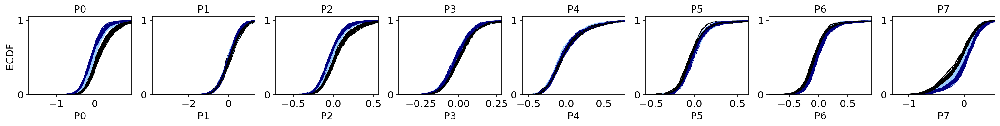

In [69]:
ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             my_programs,
             grouping_variable='guide.compact',
             grouping_variable_color=anno['Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_variant.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_variant.png',bbox_inches = "tight")


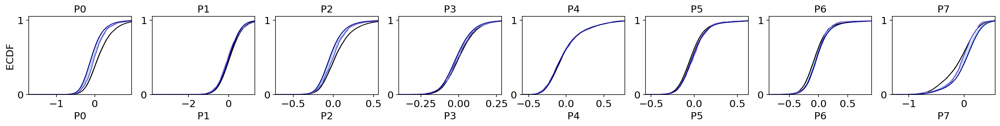

In [85]:
colors=list(set(anno['Cluster2']))
colors_df=pd.DataFrame({'color':colors},index=colors)

ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             my_programs,
             grouping_variable='Cluster2',
             grouping_variable_color=colors_df)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_module.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_module.png',bbox_inches = "tight")


In [75]:
def programs2go(program2gene_dict,organism="hsapiens"):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        if gotable_current.shape[0]==0:
            continue
        #correct p-value for multiple testing
        from statsmodels.stats.multitest import multipletests
        gotable_current['p_value']=multipletests(gotable_current['p_value'],method='fdr_bh')[1]
        gotable_current['program']='Pro: '+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    
    #go through each program and print me the sig go terms
    for program in go_table_result.columns:
        keep=go_table_result.loc[go_table_result[program]>1.0,:]
        keep=keep.sort_values(by=program,ascending=False)[program]
        print(program)
        print(keep)
        print('======')
    return(go_table_result)


score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']
pro2gene={}
for cl in score_names:
    pro2gene[cl]=adata.var_names[adata.var[pro_variable]==cl]

gos=programs2go(pro2gene)

('p_value', 'Pro: 0')
name
polyketide metabolic process                   5.954663
daunorubicin metabolic process                 5.954663
doxorubicin metabolic process                  5.954663
aminoglycoside antibiotic metabolic process    5.779725
quinone metabolic process                      4.673454
glycoside metabolic process                    4.302089
tertiary alcohol metabolic process             4.245249
response to jasmonic acid                      2.954524
cellular response to jasmonic acid stimulus    2.954524
C21-steroid hormone metabolic process          2.795413
cellular hormone metabolic process             2.714135
epithelial cell differentiation                2.704230
alcohol metabolic process                      2.523633
primary alcohol metabolic process              2.520322
secondary metabolic process                    2.103487
steroid metabolic process                      2.103487
cellular aldehyde metabolic process            2.062027
G1 DNA damage checkpo

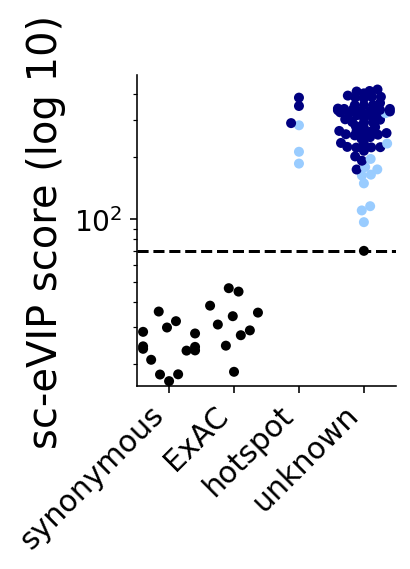

In [5]:
#sc-evip scores
mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c

g =sns.catplot(x="control_status2", y=score, hue='Cluster',
               data=anno,palette=mypal,
              order=['synonymous','ExAC','hotspot','unknown'],
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)
ax1 = g.axes[0,0]
ax1.axhline(y=score_thresh_value,color='black',linestyle='--')
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('sc-eVIP score (log 10)',fontsize=20)
ax1.set_xticklabels(['synonymous','ExAC','hotspot','unknown'],rotation=45,fontsize=15,
                   ha='right')
ax1.set_yscale('log')
ax1.grid(False)
#g.set(ylim=(0,2000))
#g.set(yticks=[0.025,0.05,0.075,0.1])

plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.png',bbox_inches = "tight")

                 hotspot       unknown          ExAC    synonymous
hotspot     1.000000e+00  1.000000e+00  1.114501e-07  1.017872e-10
unknown     1.000000e+00  1.000000e+00  7.414939e-14  7.623172e-19
ExAC        1.114501e-07  7.414939e-14  1.000000e+00  1.550719e-02
synonymous  1.017872e-10  7.623172e-19  1.550719e-02  1.000000e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

synonymous v.s. ExAC: t-test independent samples with Bonferroni correction, P_val=2.908e-02 stat=-2.821e+00
synonymous v.s. hotspot: t-test independent samples with Bonferroni correction, P_val=1.145e-10 stat=-1.342e+01
synonymous v.s. unknown: t-test independent samples with Bonferroni correction, P_val=2.859e-19 stat=-1.200e+01


(<matplotlib.axes._subplots.AxesSubplot at 0x2b8128908438>,
  <statannot.StatResult.StatResult at 0x2b812903f748>])

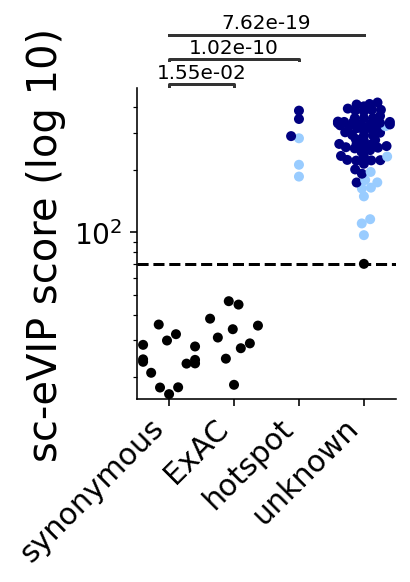

In [59]:
import seaborn as sns
from statannot import add_stat_annotation


def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)


df=pd.DataFrame({'condition':anno['control_status2'],
                'value':anno[score]})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)


mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c
    
df=anno
x="control_status2"
y=score
order = ['synonymous','ExAC','hotspot','unknown']
g =sns.catplot(x="control_status2", y=score, hue='Cluster',
               data=anno,palette=mypal,
              order=['synonymous','ExAC','hotspot','unknown'],
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)
ax1 = g.axes[0,0]
ax1.axhline(y=score_thresh_value,color='black',linestyle='--')
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('sc-eVIP score (log 10)',fontsize=20)
ax1.set_xticklabels(['synonymous','ExAC','hotspot','unknown'],rotation=45,fontsize=15,
                   ha='right')
ax1.set_yscale('log')
ax1.grid(False)

test_results = add_stat_annotation(ax1, data=df, x=x, y=y, order=order,
                                   box_pairs=[("synonymous","hotspot"), ("synonymous","ExAC"),
                                             ('synonymous','unknown')],
                                   test='t-test_ind', #text_format='full',
                                   text_annot_custom=['{:0.2e}'.format(pval_m.loc['synonymous','hotspot']),
                                                     '{:0.2e}'.format(pval_m.loc['synonymous','ExAC']),
                                                     '{:0.2e}'.format(pval_m.loc['synonymous','unknown'])],
                                   loc='outside', verbose=2)

plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.png',bbox_inches = "tight")


test_results

In [48]:
?add_stat_annotation

In [52]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='bonferroni')[1]#'fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)


df=pd.DataFrame({'condition':anno['control_status2'],
                'value':anno[score]})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

                 hotspot       unknown          ExAC    synonymous
hotspot     1.000000e+00  1.000000e+00  8.916005e-07  6.107230e-10
unknown     1.000000e+00  1.000000e+00  2.965975e-13  1.524634e-18
ExAC        8.916005e-07  2.965975e-13  1.000000e+00  1.550719e-01
synonymous  6.107230e-10  1.524634e-18  1.550719e-01  1.000000e+00


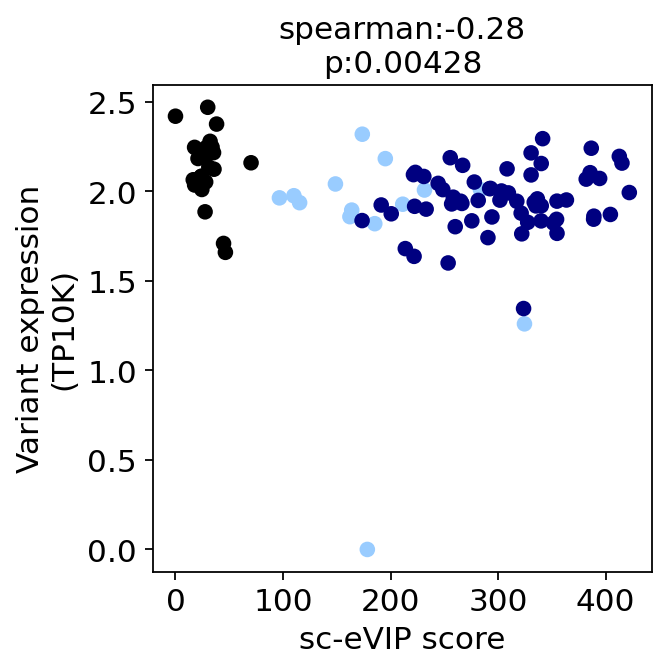

In [73]:
#phenotyping vs program scores
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))


fun_scatter(anno.loc[sorted_variants,score],
           anno.loc[sorted_variants,'variant_expression'],
           color=anno.loc[sorted_variants,'Cluster'])
plt.grid(False)
plt.xlabel('sc-eVIP score')
plt.ylabel('Variant expression\n(TP10K)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'score_vs_vbcexpr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'score_vs_vbcexpr.png',bbox_inches = "tight")

Signatures
===

In [12]:
for gene in ['CDKN1A','RPS27L']:
    adata.obs[gene]=adata[:,gene].X.flatten()

In [13]:
genes13=['HDM2', 'CDKN1A', 'ZMAT3', 'DDB2', 'FDXR', 'RPS27L', 'BAX', 'RRM2B', 'SESN1', 'CCNG1', 'XPC', 'TNFRSF10B', 'AEN']
sc.tl.score_genes(adata,genes13,score_name='13-gene sig.',use_raw=True)


computing score '13-gene sig.'
    finished: added
    '13-gene sig.', score of gene set (adata.obs).
    348 total control genes are used. (0:00:14)


In [14]:
large_sig_f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-12-05/'+PROTEIN+'/anno/p53_target_genes_Fischer.txt'

large_sig=pd.read_csv(large_sig_f,sep='\t')
print(large_sig.shape)
large_sig_genes=list(set(list(large_sig['Gene Symbol'])).intersection(set(adata.raw.var_names)))
print(len(large_sig_genes))

sc.tl.score_genes(adata,large_sig_genes,score_name='300-gene sig.',use_raw=True)


(343, 2)
341
computing score '300-gene sig.'
    finished: added
    '300-gene sig.', score of gene set (adata.obs).
    1089 total control genes are used. (0:00:15)


In [15]:
signatures=['CDKN1A','RPS27L','13-gene sig.','300-gene sig.']
bulk_signatures,p_signatures=get_bulk_programs_with_sig(adata,signatures,
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)

CDKN1A
RPS27L
13-gene sig.
300-gene sig.


              #99CCFF          navy         black
#99CCFF  1.000000e+00  1.370005e-10  2.875489e-15
navy     1.370005e-10  1.000000e+00  1.039805e-46
black    2.875489e-15  1.039805e-46  1.000000e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=3.834e-15 stat=1.305e+01
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=2.740e-10 stat=7.584e+00
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=6.932e-47 stat=3.064e+01


(<matplotlib.axes._subplots.AxesSubplot at 0x2b69241ccd30>,
  <statannot.StatResult.StatResult at 0x2b6924134cf8>])

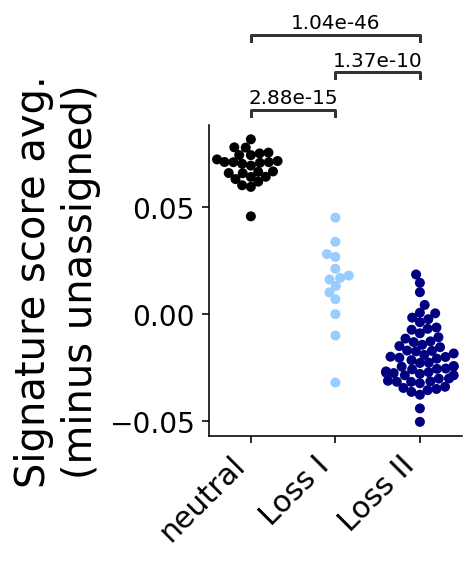

In [28]:
import seaborn as sns
from statannot import add_stat_annotation


def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

item='13-gene sig.'

df=pd.DataFrame({'condition':anno.loc[sorted_variants,'Cluster'],
                'value':bulk_signatures.loc[sorted_variants,item]})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)


mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c
    
x="condition"
y='value'
order = ['black','#99CCFF','navy']
g =sns.catplot(x=x, y=y, hue='condition',
               data=df,palette=mypal,
              order=order,
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)

ax1 = g.axes[0,0]
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('Signature score avg.\n(minus unassigned)',fontsize=20)
ax1.set_xticklabels(['neutral','Loss I','Loss II'],rotation=45,fontsize=15,
                   ha='right')
ax1.grid(False)

test_results = add_stat_annotation(ax1, data=df, x=x, y=y, order=order,
                                   box_pairs=[("black","#99CCFF"), ("#99CCFF","navy"),
                                             ('black','navy')],
                                   test='t-test_ind', #text_format='full',
                                   text_annot_custom=['{:0.2e}'.format(pval_m.loc["black","#99CCFF"]),
                                                     '{:0.2e}'.format(pval_m.loc["#99CCFF","navy"]),
                                                     '{:0.2e}'.format(pval_m.loc['black','navy'])],
                                   loc='outside', verbose=2)

plt.savefig(FIGS+'/'+PROTEIN+'.'+item+'_scores_test.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+item+'_scores_test.png',bbox_inches = "tight")


test_results

              #99CCFF          navy         black
#99CCFF  1.000000e+00  2.724898e-10  7.420227e-17
navy     2.724898e-10  1.000000e+00  1.589487e-54
black    7.420227e-17  1.589487e-54  1.000000e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=9.894e-17 stat=1.464e+01
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=5.450e-10 stat=7.424e+00
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=1.060e-54 stat=3.854e+01


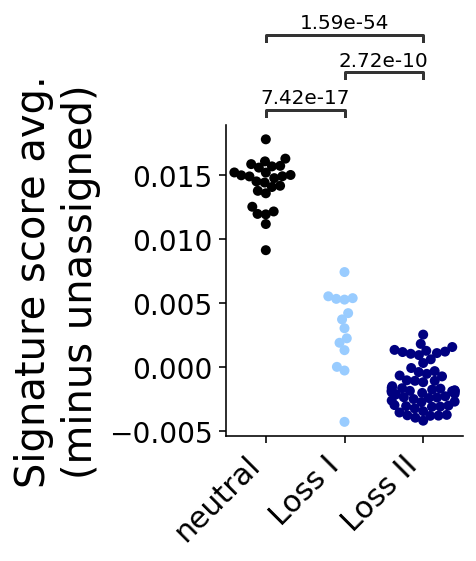

In [30]:
import seaborn as sns
from statannot import add_stat_annotation


def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

item='300-gene sig.'

df=pd.DataFrame({'condition':anno.loc[sorted_variants,'Cluster'],
                'value':bulk_signatures.loc[sorted_variants,item]})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)


mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c
    
x="condition"
y='value'
order = ['black','#99CCFF','navy']
g =sns.catplot(x=x, y=y, hue='condition',
               data=df,palette=mypal,
              order=order,
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)

ax1 = g.axes[0,0]
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('Signature score avg.\n(minus unassigned)',fontsize=20)
ax1.set_xticklabels(['neutral','Loss I','Loss II'],rotation=45,fontsize=15,
                   ha='right')
ax1.grid(False)

test_results = add_stat_annotation(ax1, data=df, x=x, y=y, order=order,
                                   box_pairs=[("black","#99CCFF"), ("#99CCFF","navy"),
                                             ('black','navy')],
                                   test='t-test_ind', #text_format='full',
                                   text_annot_custom=['{:0.2e}'.format(pval_m.loc["black","#99CCFF"]),
                                                     '{:0.2e}'.format(pval_m.loc["#99CCFF","navy"]),
                                                     '{:0.2e}'.format(pval_m.loc['black','navy'])],
                                   loc='outside', verbose=2)

plt.savefig(FIGS+'/'+PROTEIN+'.'+item+'_scores_test.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+item+'_scores_test.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


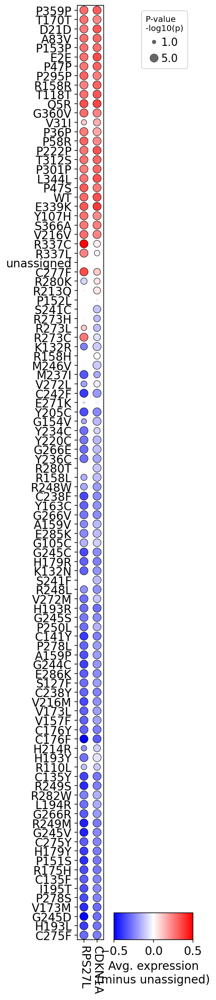

In [123]:
dotplot_programs(bulk_signatures,p_signatures,
                 myorder=['CDKN1A','RPS27L'],
                 sorted_variants=sorted_variants,
                 best_p=1e-5,
                 vmin=-0.5,vmax=0.5,w=2.5,h=20,cbar_percent='3%',widths=[1,3],
                title='Avg. expression\n(minus unassigned)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'signatures_CDKRPS.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'signatures_CDKRPS.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


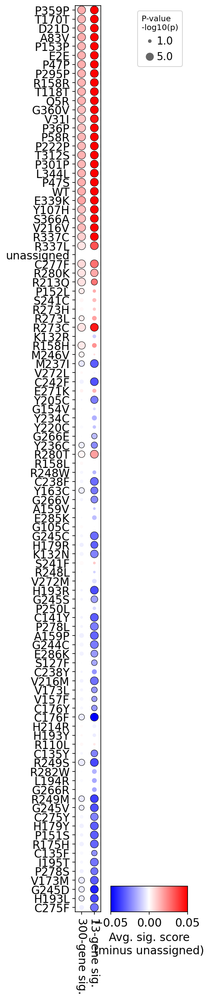

In [124]:
dotplot_programs(bulk_signatures,p_signatures,
                 myorder=['13-gene sig.','300-gene sig.'],
                 sorted_variants=sorted_variants,
                 best_p=1e-5,
                 vmin=-0.05,vmax=0.05,w=2.5,h=20,cbar_percent='3%',widths=[1,3],
                title='Avg. sig. score\n(minus unassigned)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'signatures_13_300.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'signatures_13_300.png',bbox_inches = "tight")

Proportions
==

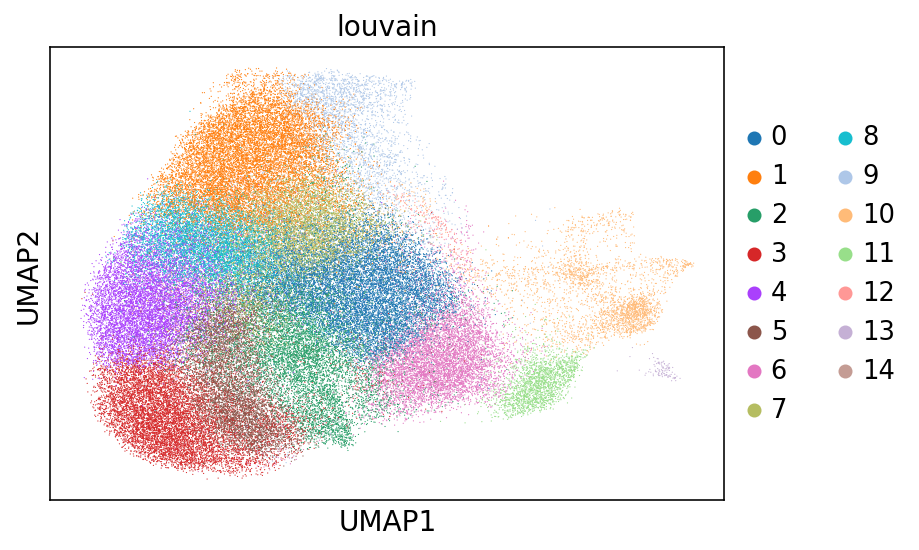

In [9]:
sc.pl.umap(adata,color=['louvain'])

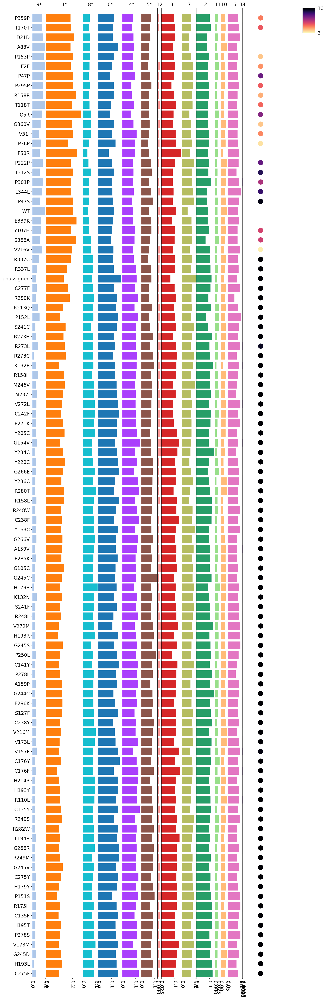

In [10]:
adata.uns['phase.multi_colors']=['gray','purple','red','orange','gold','lightblue']
def obs_split(adata_here,obs_of_interest,pref='',copy_adata=False):
    #convert one vector of obs into one obs for each encountered value 
    
    import pandas as pd
    import copy
    
    if copy_adata:
        adata_here=copy.deepcopy(adata_here)
    encountered_values=list(set(adata_here.obs[obs_of_interest]))
    cells=adata_here.obs_names
    df=pd.DataFrame(0,columns=encountered_values,index=cells)
    
    for val_idx,value in enumerate(encountered_values):
        df[value]=1.0*(adata_here.obs[obs_of_interest]==value)
    
    for col in df.columns:
        adata_here.obs[pref+col]=df[col]
    
    if copy_adata:
        return(adata_here)


def perturbation2cluster(adata_here,perturbations,cluster_variable):

    clusters=list(set(adata_here.obs[cluster_variable]))
    perturbations_found=list(set(perturbations).intersection(set(adata_here.obs.columns)))
    cluster_counts=pd.DataFrame(index=perturbations_found,columns=clusters)
    for perturbation in perturbations:
        if perturbation not in adata_here.obs.columns:
            print("WARNING: The perturbation "+perturbation+' is not saved in adata as an obs. It will not be included in this analysis.')
            continue
        perturbation_cells=adata_here[adata_here.obs[perturbation]>0,:]
        for cl in clusters:
            count=np.sum(perturbation_cells.obs[cluster_variable]==cl)
            cluster_counts.loc[perturbation,cl]=count
    return(cluster_counts)

   
def chisq_test_from_table(compositional_counts_table,reference):

    from scipy.stats import chisquare

    #compute expected fractions                                                                              
    #- either from a control perturbation or from the total                                                  
    if reference=='total':
        exp_counts=np.rint(compositional_counts_table.sum(axis=0))
    else:
        exp_counts=compositional_counts_table.loc[reference,:]
    exp_total=np.array(exp_counts).sum()
    exp_fractions=np.array(exp_counts)/np.array(exp_counts).sum()

    #go through each line of counts and perform chi-square test                                              
    chisq_stats_here=pd.DataFrame(index=compositional_counts_table.index,columns=['p','test_stat'])
    for item in compositional_counts_table.index:

        obs_counts_init=compositional_counts_table.loc[item,:]
        obs_fractions=np.array(obs_counts_init)/np.array(obs_counts_init).sum()
        obs_total=np.array(obs_counts_init).sum()
        #obs_counts=np.rint(exp_total*obs_fractions)
        obs_counts=obs_counts_init
        exp_counts=np.rint(obs_total*exp_fractions)

        test_result=chisquare(np.array(obs_counts)+1, exp_counts+1)

        chisq_stats_here.loc[item,'p']=test_result[1]
        chisq_stats_here.loc[item,'test_stat']=test_result[0]
    #adjust p-values with BH
    from statsmodels.stats.multitest import multipletests
    chisq_stats_here['p.adj']=multipletests(chisq_stats_here['p'])[1]

    chisq_stats_here=chisq_stats_here.sort_values(by='test_stat',ascending=False)
    return(chisq_stats_here)


def compositional_test(compositional_counts,reference):
    
    chisq_stats={}
    chisq_stats['perturbation']=chisq_test_from_table(compositional_counts,reference=reference)
    chisq_stats['composition']=chisq_test_from_table(compositional_counts.T,reference='total')
    sorted_compositional_counts=compositional_counts.loc[chisq_stats['perturbation'].index,
                                                         chisq_stats['composition'].index]
    chisq_stats['data']=sorted_compositional_counts
    chisq_stats['data.norm']=sorted_compositional_counts.div(sorted_compositional_counts.sum(axis=1), axis=0)
    
    return(chisq_stats)
        
def plot_compositional_test(chisq_stats,ax=None,specific_order=None,plot_kind='bar',my_colors=None,
                           FDR=0.1,ps=1e-10,multi=1):
    
    if specific_order==None:
        my_order=list(chisq_stats['data.norm'].index)
    else:
        my_order=specific_order
    compositions=list(chisq_stats['data.norm'].columns)
    
    widths=list(chisq_stats['data.norm'].max(axis=0))
    widths.append(1.0*np.sum(np.array(widths))/6)
    
    if plot_kind=='bar':
        #make the nice bar chart
        from matplotlib import gridspec

        fig = plt.figure()
        spec = gridspec.GridSpec(ncols=len(compositions)+1, nrows=1,
                         width_ratios=widths)
        
        fig.set_size_inches(1.0*(len(compositions)+1)*multi,0.5*len(my_order))

        for col_idx in range(len(compositions)):
            col=compositions[col_idx]
            if my_colors==None:
                color='black'
            else:
                color=my_colors[col_idx]
            ax = fig.add_subplot(spec[col_idx])
            
            ax.barh(my_order,chisq_stats['data.norm'].loc[my_order,col],
                               color=color,alpha=1)
            ylabel=str(col)
            if chisq_stats['composition'].loc[col,'p.adj']<=FDR:
                ylabel=ylabel+'*'
            ax.set_title(ylabel)
            ax.grid(False)
            
            if col_idx!=0:
                ax.set_yticks([])
            ax.set_ylim(-0.5,len(my_order))
            for tick in ax.get_xticklabels():
                tick.set_rotation(270) 
        ax = fig.add_subplot(spec[col_idx+1])
        
        colors=[]

        import matplotlib
        import matplotlib.cm as cm
        norm = matplotlib.colors.Normalize(vmin=0, vmax=-np.log10(ps), clip=True)
        mapper = cm.ScalarMappable(norm=norm, cmap=cm.magma_r)

        vals=[]
        sigs=[]
        for i in range(len(my_order)):
            v=-np.log10(chisq_stats['perturbation'].loc[my_order[i],'p.adj'].astype(float)+ps)
            
            v_color_vec=mapper.to_rgba(v)
            if v>=(-np.log10(FDR)):
                vals.append(v)
                sigs.append(i)

        mini=-np.log10(FDR)
        stuff=ax.scatter([1 for x in range(len(sigs))],sigs,s=200,c=vals,cmap='magma_r',
                         vmin=mini,vmax=max(vals))#c=colors)
        ax.spines['right'].set_visible(False)
        
        from mpl_toolkits.axes_grid1.inset_locator import inset_axes
        axins = inset_axes(ax,
                   width=0.5,  # width = 5% of parent_bbox width
                   height=1,  # height : 50%
                   loc='upper right',
                   bbox_to_anchor=(1.05, 0., 1, 1),
                   bbox_transform=ax.transAxes,
                   borderpad=0,
                   )
        
        fig.colorbar(stuff, cax=axins,fraction=0.5,aspect=1,ticks=[mini,max(vals)])
        ax.set_yticks([])
        ax.set_xticks([])
        ax.spines['bottom'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.set_ylim(-0.5,len(my_order))
        plt.subplots_adjust(wspace=0, hspace=0)
        
def run_compositional_test(adata_here,
                          perturbations,
                          cluster_variable,
                          reference='total',
                          specific_order=None,
                          my_colors=None,
                          FDR=0.01,
                          figsize_multi=1):
    compositional_counts=perturbation2cluster(adata_here,
                                          perturbations=perturbations,
                                          cluster_variable=cluster_variable)
    result=compositional_test(compositional_counts,reference=reference)
    
    if cluster_variable+'_colors' in adata_here.uns:
        old_color_order=adata_here.uns[cluster_variable+'_colors']
        old_color_names=list(adata_here.obs[cluster_variable].cat.categories)
        new_color_order=[]
        for i in range(result['data.norm'].shape[1]):
            cl=result['data.norm'].columns[i]
            col=old_color_order[old_color_names.index(cl)]
            new_color_order.append(col)
        my_colors=new_color_order
    plot_compositional_test(result,
                        specific_order=specific_order,
                       my_colors=my_colors,FDR=FDR,multi=figsize_multi)
    
    return(result)



louv_res=run_compositional_test(adata,
                          perturbations=sorted_variants,
                          cluster_variable='louvain',
                          reference='WT',
                          specific_order=sorted_variants[::-1],figsize_multi=0.8)

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars.png',bbox_inches = "tight")

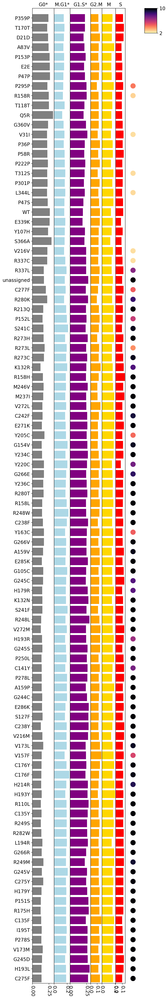

In [11]:
ccycle_res=run_compositional_test(adata,
                          perturbations=sorted_variants,
                          cluster_variable='phase.multi',
                          reference='WT',
                          specific_order=sorted_variants[::-1],figsize_multi=0.8)

plt.savefig(FIGS+'/'+PROTEIN+'.ccycle_bars.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.ccycle_bars.png',bbox_inches = "tight")

In [ ]:



mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c
    
df=anno
x="control_status2"
y=score
order = ['synonymous','ExAC','hotspot','unknown']
g =sns.catplot(x="control_status2", y=score, hue='Cluster',
               data=anno,palette=mypal,
              order=['synonymous','ExAC','hotspot','unknown'],
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)
ax1 = g.axes[0,0]
ax1.axhline(y=score_thresh_value,color='black',linestyle='--')
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('sc-eVIP score (log 10)',fontsize=20)
ax1.set_xticklabels(['synonymous','ExAC','hotspot','unknown'],rotation=45,fontsize=15,
                   ha='right')
ax1.set_yscale('log')
ax1.grid(False)

test_results = add_stat_annotation(ax1, data=df, x=x, y=y, order=order,
                                   box_pairs=[("synonymous","hotspot"), ("synonymous","ExAC"),
                                             ('synonymous','unknown')],
                                   test='t-test_ind', #text_format='full',
                                   text_annot_custom=['{:0.2e}'.format(pval_m.loc['synonymous','hotspot']),
                                                     '{:0.2e}'.format(pval_m.loc['synonymous','ExAC']),
                                                     '{:0.2e}'.format(pval_m.loc['synonymous','unknown'])],
                                   loc='outside', verbose=2)

plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.png',bbox_inches = "tight")



/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


             navy   #99CCFF     black
navy     1.000000  1.000000  0.000377
#99CCFF  1.000000  1.000000  0.040055
black    0.000377  0.040055  1.000000
['4.01e-02', '3.77e-04', '1.00e+00']
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=5.341e-02 stat=-2.477e+00
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-1.560e-01
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=2.514e-04 stat=-4.135e+00


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


                 navy       #99CCFF         black
navy     1.000000e+00  4.933066e-01  6.413807e-17
#99CCFF  4.933066e-01  1.000000e+00  4.944144e-07
black    6.413807e-17  4.944144e-07  1.000000e+00
['4.94e-07', '6.41e-17', '4.93e-01']
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=6.592e-07 stat=-6.302e+00
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=9.866e-01 stat=-9.831e-01
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=4.276e-17 stat=-1.081e+01


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


                 navy       #99CCFF         black
navy     1.000000e+00  5.545823e-06  1.153977e-38
#99CCFF  5.545823e-06  1.000000e+00  2.791597e-11
black    1.153977e-38  2.791597e-11  1.000000e+00
['2.79e-11', '1.15e-38', '5.55e-06']
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=3.722e-11 stat=9.541e+00
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=1.109e-05 stat=5.014e+00
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=7.693e-39 stat=2.397e+01


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


                 navy   #99CCFF         black
navy     1.000000e+00  0.183103  1.028551e-13
#99CCFF  1.831029e-01  1.000000  2.205326e-05
black    1.028551e-13  0.000022  1.000000e+00
['2.21e-05', '1.03e-13', '1.83e-01']
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=2.940e-05 stat=-5.097e+00
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=3.662e-01 stat=-1.565e+00
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=6.857e-14 stat=-9.206e+00


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


             navy   #99CCFF     black
navy     1.000000  0.099843  0.099843
#99CCFF  0.099843  1.000000  0.879864
black    0.099843  0.879864  1.000000
['8.80e-01', '9.98e-02', '9.98e-02']
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=5.485e-01
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=1.127e-01 stat=-2.119e+00
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=1.331e-01 stat=-2.041e+00


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


             navy   #99CCFF     black
navy     1.000000  0.339807  0.000143
#99CCFF  0.339807  1.000000  0.124457
black    0.000143  0.124457  1.000000
['1.24e-01', '1.43e-04', '3.40e-01']
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #99CCFF: t-test independent samples with Bonferroni correction, P_val=1.659e-01 stat=-1.977e+00
#99CCFF v.s. navy: t-test independent samples with Bonferroni correction, P_val=6.796e-01 stat=-1.220e+00
black v.s. navy: t-test independent samples with Bonferroni correction, P_val=9.531e-05 stat=-4.398e+00


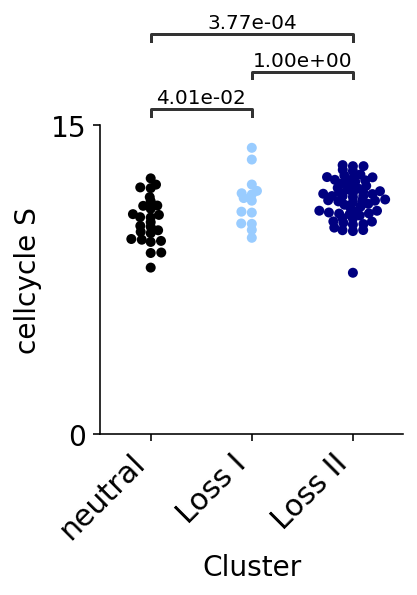

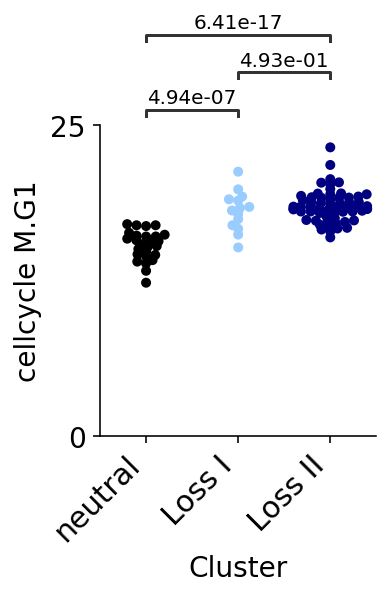

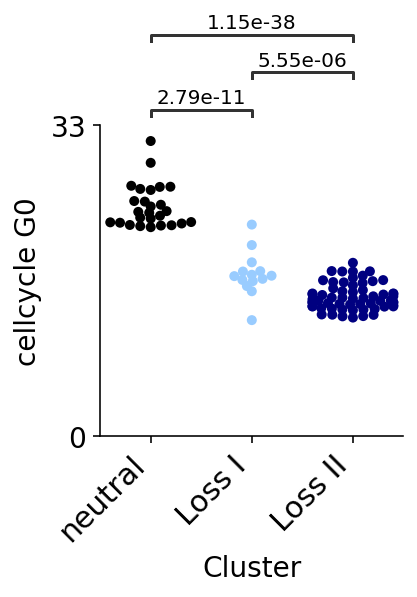

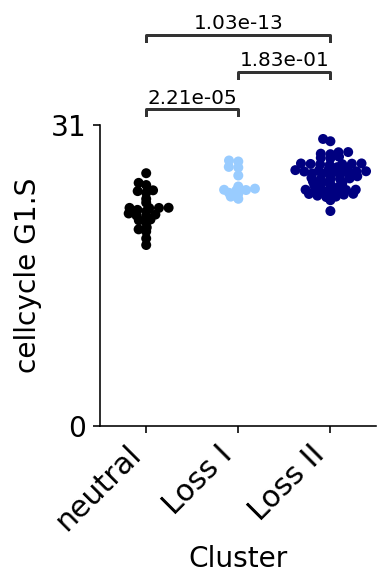

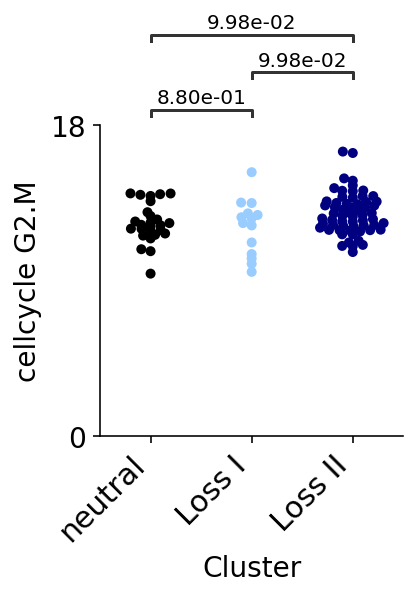

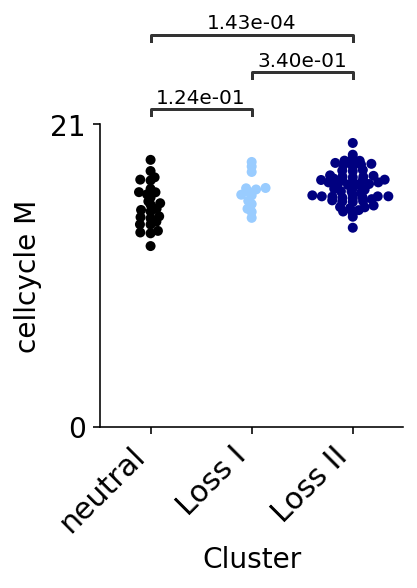

In [87]:
for cc in set(adata.obs['phase.multi']):
    anno['cellcycle '+cc]=100*ccycle_res['data.norm'].loc[anno.index,cc]

    mypal={}
    for c in set(anno['Cluster']):
        mypal[c]=c
        
    df=pd.DataFrame({'condition':anno.loc[anno['Cluster'].isin(['navy' , '#99CCFF', 'black']),'Cluster'],
                'value':anno.loc[anno['Cluster'].isin(['navy' , '#99CCFF', 'black']),'cellcycle '+cc]})

    condition='condition'
    value='value'
    conditions=set(df[condition])
    pval_m=pairwise_ttests(df,'condition','value')
    print(pval_m)

    g =sns.catplot(x="Cluster", y='cellcycle '+cc, hue='Cluster',
                   data=anno,palette=mypal,
                  order=['black','#99CCFF','navy'],
                  height=3, # make the plot 5 units high
                    aspect=1,legend=False,kind='swarm')
    ax1 = g.axes[0,0]
    ax1.set_yticks([0,int(np.max(anno['cellcycle '+cc]))+2])
    
    ax1.grid(False)
    
    print(['{:0.2e}'.format(pval_m.loc["black","#99CCFF"]),
                                                     '{:0.2e}'.format(pval_m.loc["black","navy"]),
                                                     '{:0.2e}'.format(pval_m.loc["#99CCFF","navy"])])
    
    test_results = add_stat_annotation(ax1, data=anno, x="Cluster", y='cellcycle '+cc, 
                                       order=['black','#99CCFF','navy'],
                                       #hue='Cluster',
                                   box_pairs=[("black","#99CCFF"),('black','navy'),
                                             ("#99CCFF","navy")],
                                   test='t-test_ind', #text_format='full',
                                   text_annot_custom=['{:0.2e}'.format(pval_m.loc["black","#99CCFF"]),
                                                     '{:0.2e}'.format(pval_m.loc["black","navy"]),
                                                     '{:0.2e}'.format(pval_m.loc["#99CCFF","navy"])],
                                   loc='outside', verbose=2)
    
    ax1.set_xticklabels(['neutral','Loss I','Loss II'],
                        rotation=45,fontsize=15,
                       ha='right')

    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.png',bbox_inches = "tight") 

In [ ]:
("black","#99CCFF"), ("black","navy"),
                                             ("#99CCFF","navy")

In [89]:
set(anno['Cluster'])

{'#99CCFF', 'black', nan, 'navy'}

Classifier
==

... storing 'Cluster3' as categorical


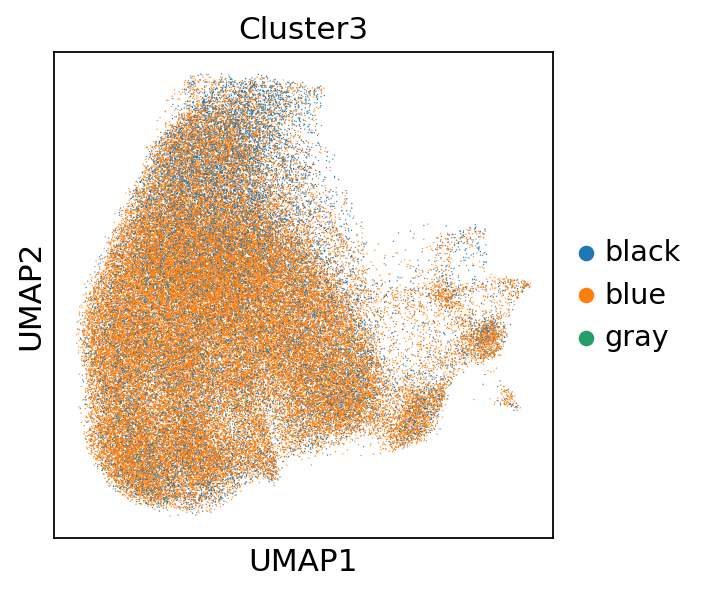

In [90]:
cluster3=[]
for i in range(adata.n_obs):
    cl=adata.obs['Cluster'][i]
    if cl=='black':
        cl3='black'
    else:
        if cl in ['navy','#99CCFF']:
            cl3='blue'
        else:
            cl3='gray'
    cluster3.append(cl3)
adata.obs['Cluster3']=cluster3
sc.pl.umap(adata,color=['Cluster3'])

In [119]:
adata3=perturb.pp.subsample_cells(adata,6000,'Cluster3')
adata3=adata3[adata3.obs['Cluster3'].isin(['black','blue']),:]
print(adata3)

View of AnnData object with n_obs × n_vars = 12000 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', '

(array([6000.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        6000.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

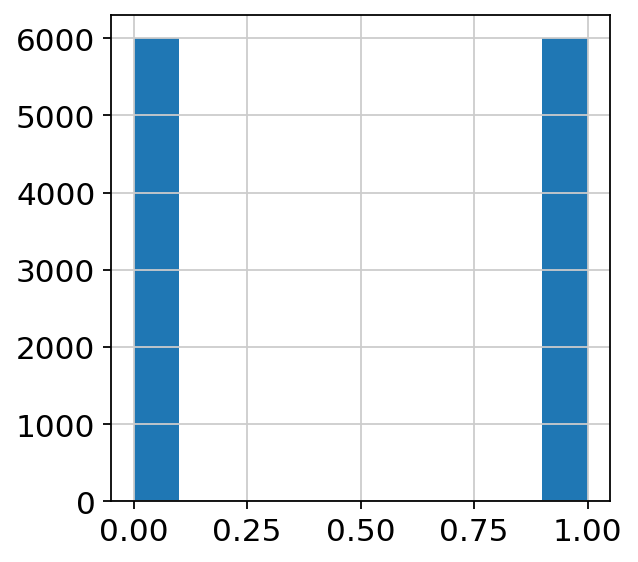

In [120]:
#X = expression
X=pd.DataFrame(adata3.X,index=adata3.obs_names,columns=adata3.var_names)

#y=variant class
variant_mapping={'black':0,'blue':1}
y=[]
for i in range(len(adata3.obs_names)):
    var_group=variant_mapping[adata3.obs['Cluster3'][i]]
    y.append(var_group)
plt.hist(y)

In [121]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)

In [122]:
from sklearn.datasets import make_gaussian_quantiles
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.linear_model import LogisticRegression


clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(6000,)


Confusion matrix, without normalization
[[2321  658]
 [ 629 2392]]
Normalized confusion matrix
[[0.77912051 0.22087949]
 [0.2082092  0.7917908 ]]
Confusion matrix, without normalization
[[1849 1172]
 [1060 1919]]
Normalized confusion matrix
[[0.61204899 0.38795101]
 [0.3558241  0.6441759 ]]


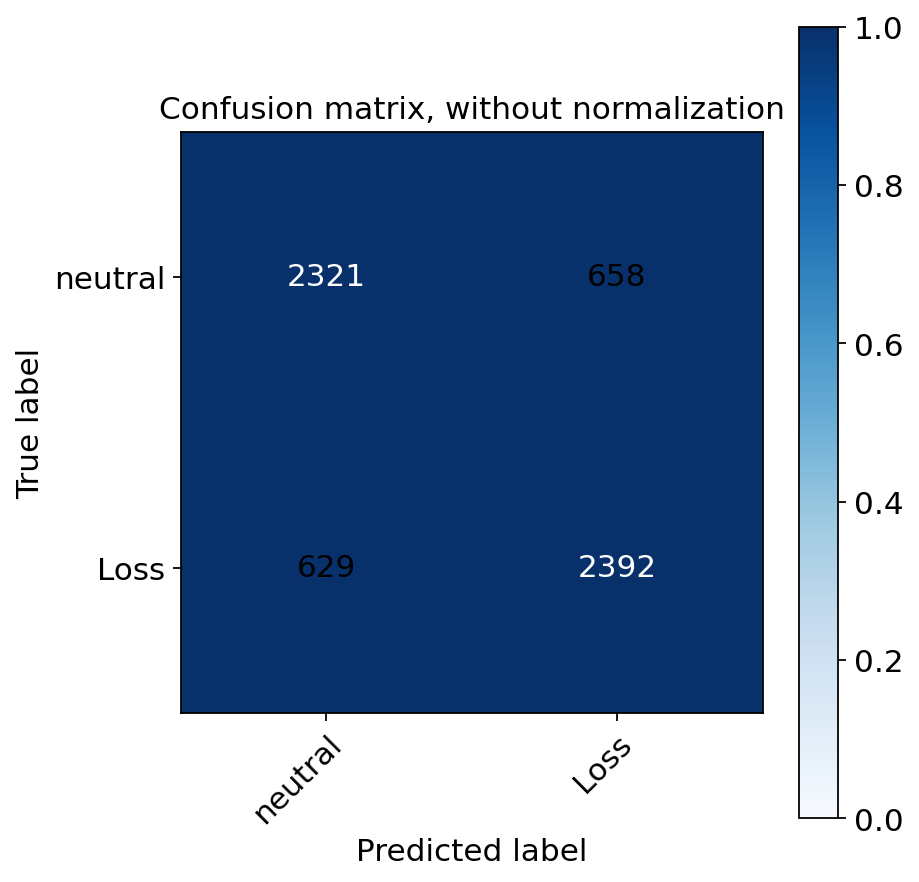

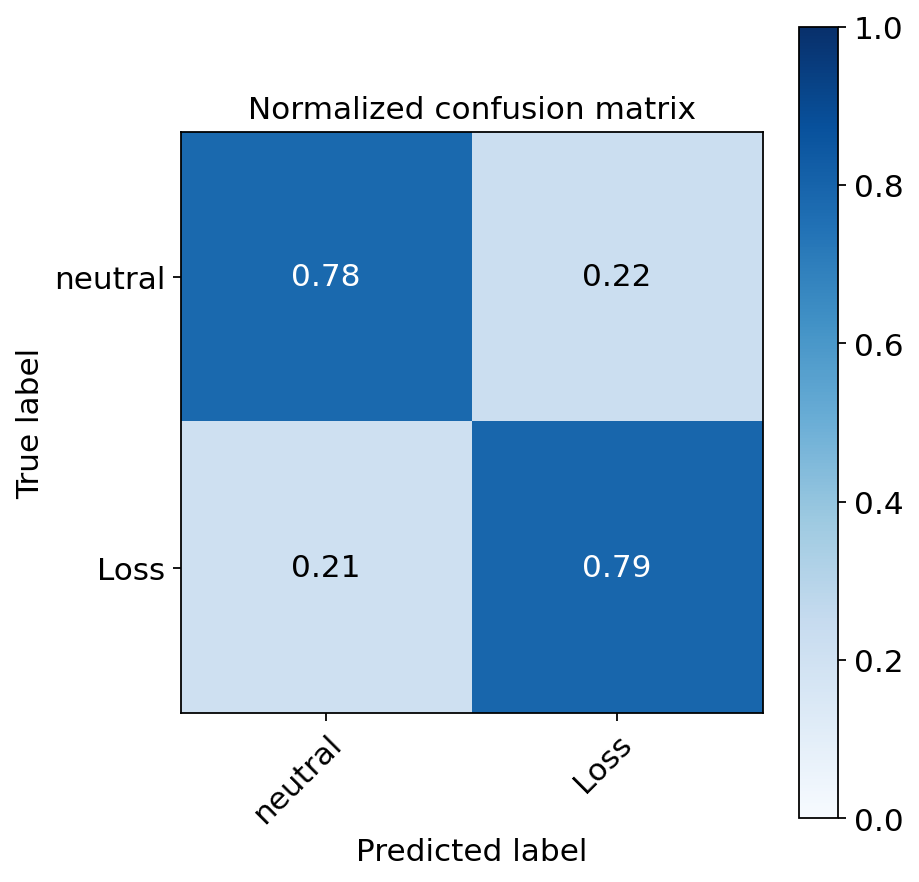

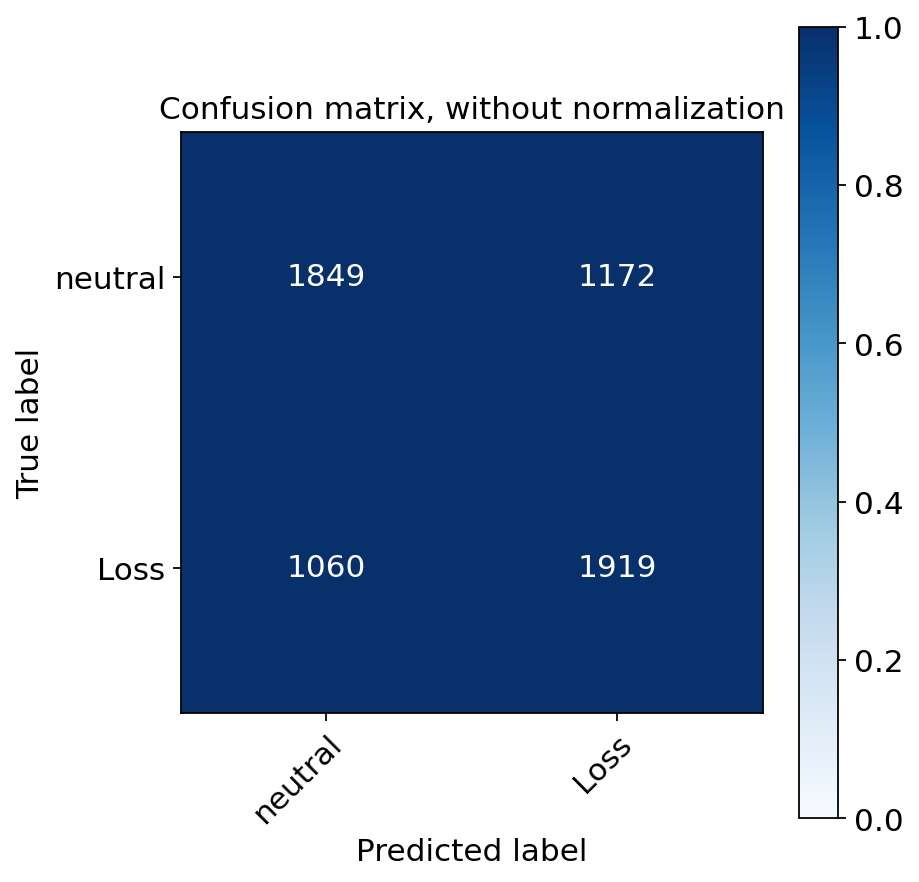

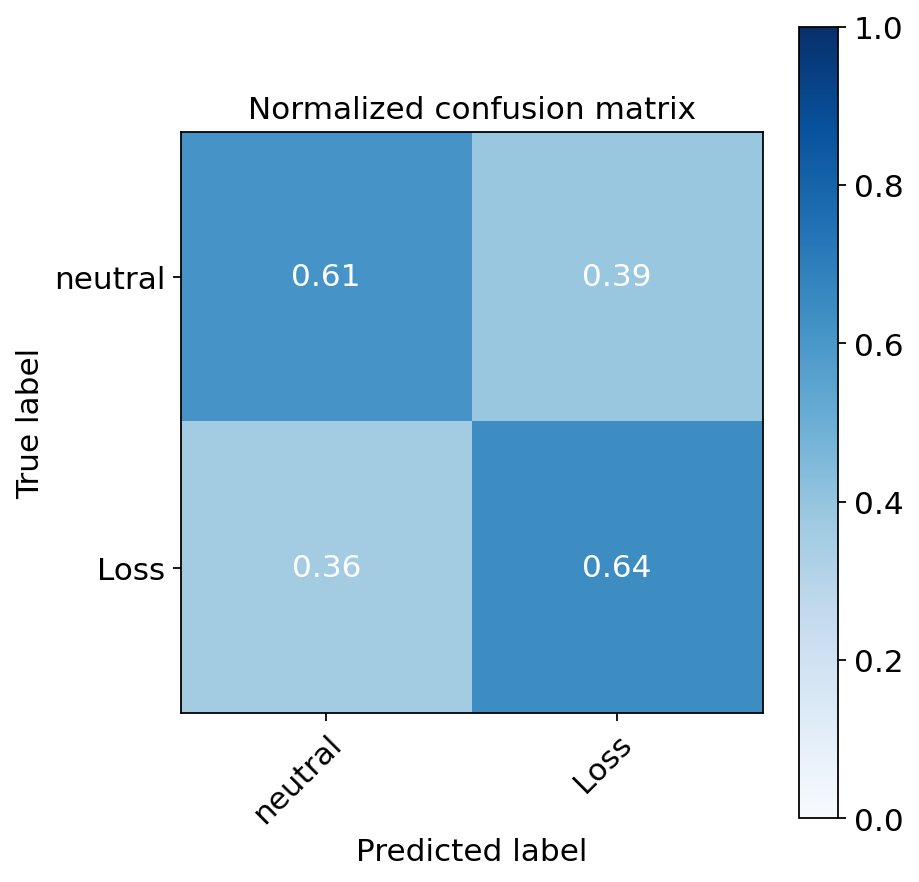

In [123]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes#classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap,vmin=0,vmax=1)
    fig.set_size_inches(6,6)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    ax.grid(False)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

classes=['neutral','Loss']
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat.png',bbox_inches = "tight")

In [124]:
#look at error by louvain
errors=pd.DataFrame({'louvain':adata[X_valid.index,:].obs['louvain'],
                    'pred':pred_valid,
                    'true':y_valid})
errors['error']=errors['pred']!=errors['true']

In [125]:
error_table=pd.DataFrame(0.0,index=list(set(errors['louvain'])),
                         columns=classes)

for louv in set(errors['louvain']):
    for vclass in set(errors['true']):
        error_here=errors.loc[errors['louvain']==louv,:]
        error_here=error_here.loc[error_here['true']==vclass,'error']
        error_counts=error_here.value_counts()
        if True not in error_counts:
            error_table.loc[louv,classes[vclass]]=0
        else:
            error_table.loc[louv,classes[vclass]]=error_counts[True]/error_counts.sum()

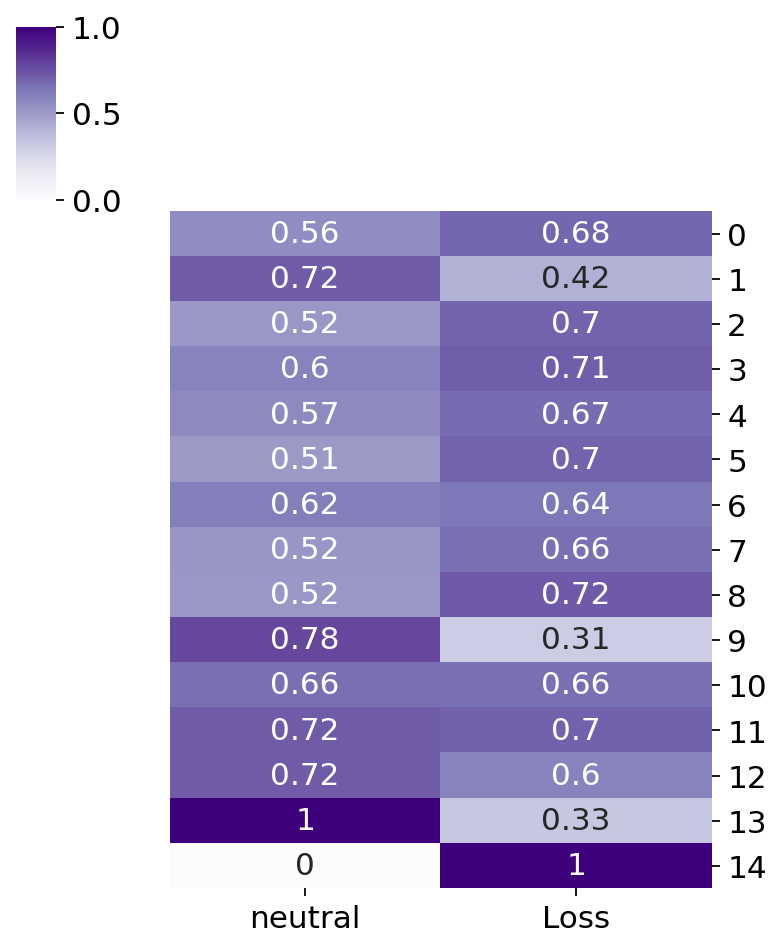

In [126]:
sns.clustermap(1-error_table.loc[['0','1','2','3','4','5','6','7','8','9','10','11','12','13','14'],:],
                cmap='Purples',row_cluster=False,annot=True,figsize=(5,6),
              col_cluster=False,vmin=0,vmax=1)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'performance.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'performance.png',bbox_inches = "tight")

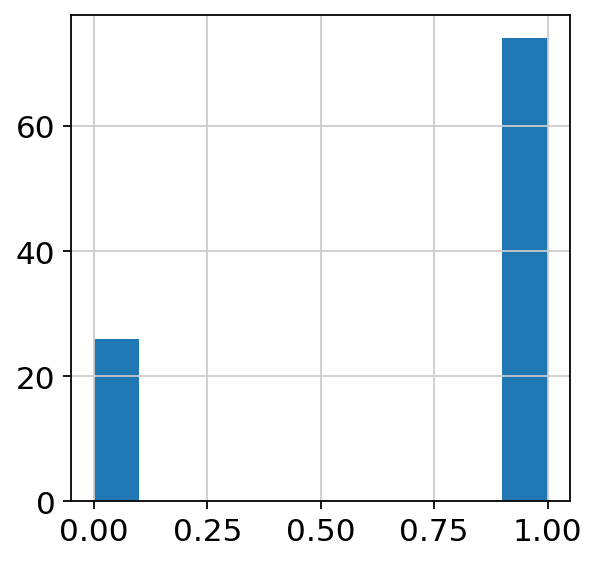

In [129]:
#now, a classifier with the proportions of cells in the clusters
proportions=louv_res['data.norm']
X=proportions

variant_mapping={'black':0,'#99CCFF':1,'navy':1}


keep=[]
y=[]
for i in range(proportions.shape[0]):
    variant=proportions.index[i]
    if anno.loc[variant,'Cluster'] not in variant_mapping:
        continue
    keep.append(variant)
    var_group=variant_mapping[anno.loc[variant,'Cluster']]
    y.append(var_group)
plt.hist(y)
X=X.loc[keep,:]

In [130]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)

In [131]:
clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         solver='saga',
                         penalty='elasticnet',
                         l1_ratio=0.5,
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(50,)


Confusion matrix, without normalization
[[14  0]
 [ 2 34]]
Normalized confusion matrix
[[1.         0.        ]
 [0.05555556 0.94444444]]
Confusion matrix, without normalization
[[12  0]
 [ 0 38]]
Normalized confusion matrix
[[1. 0.]
 [0. 1.]]


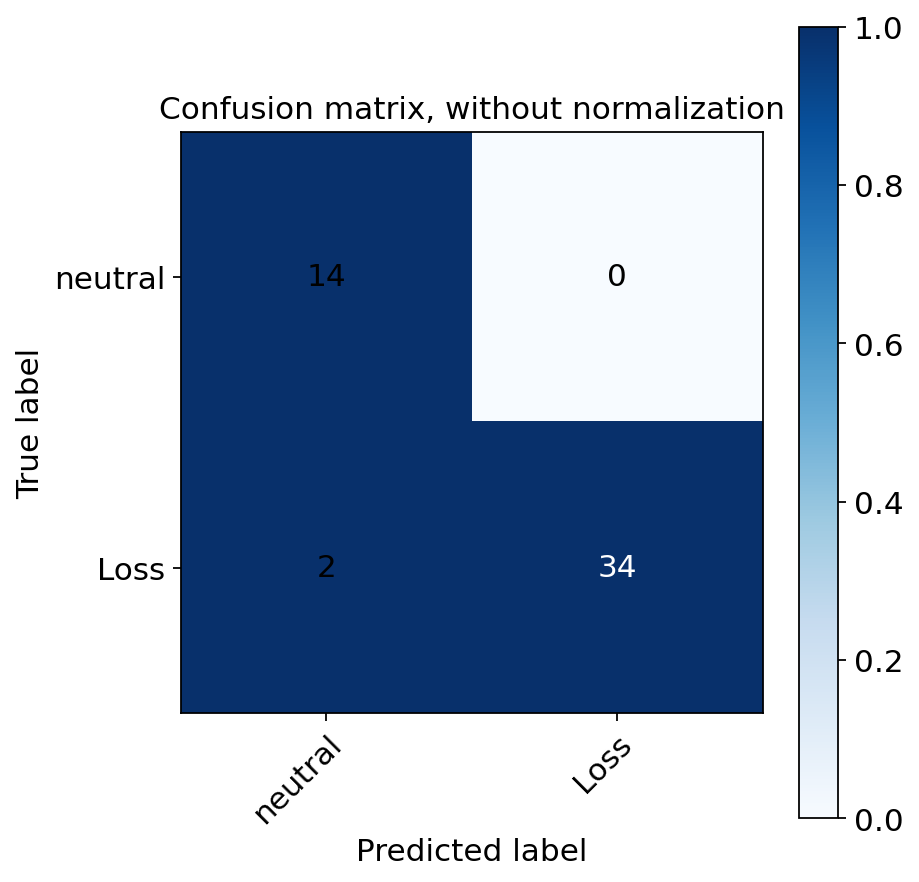

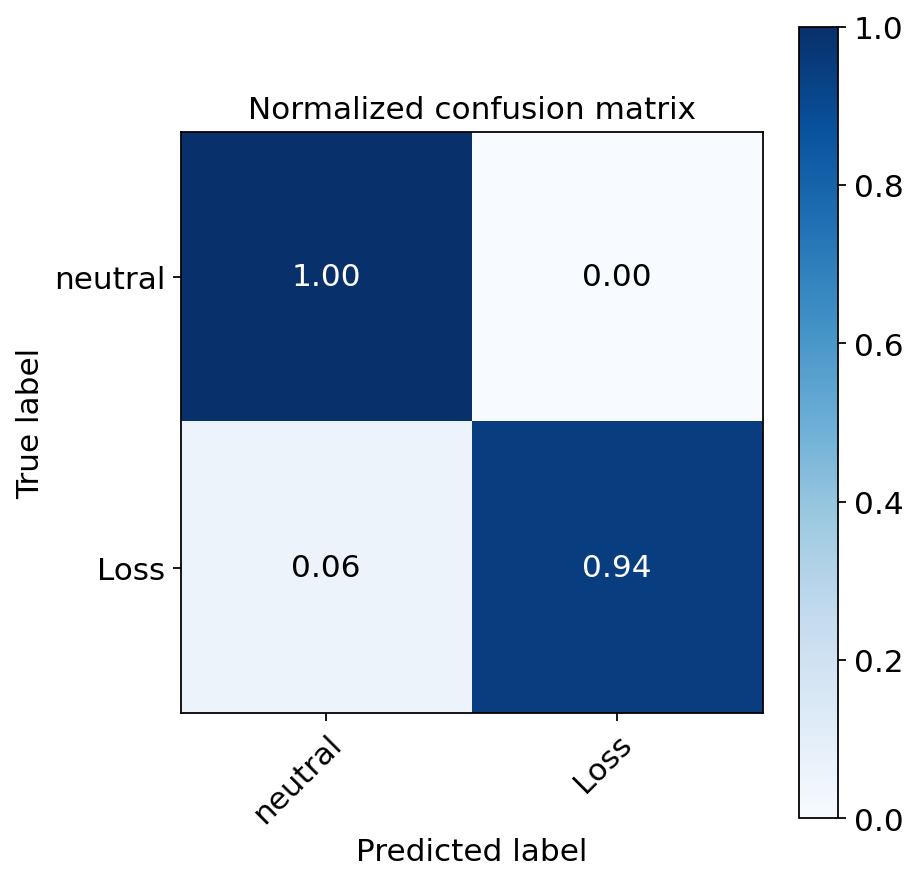

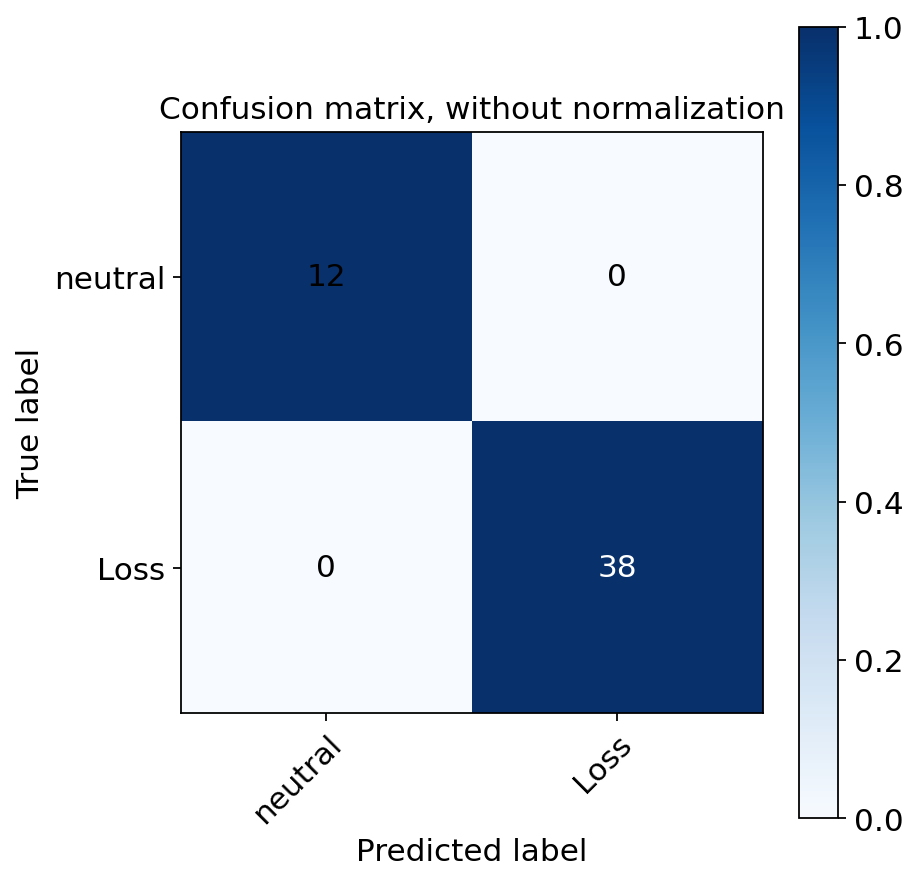

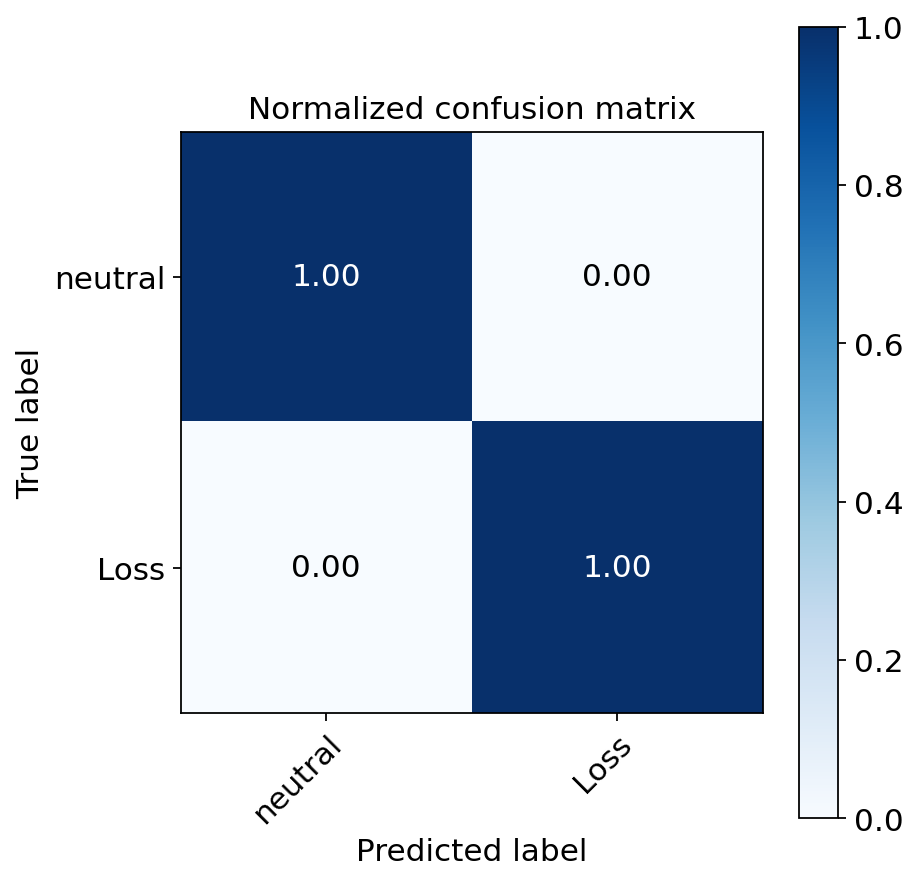

In [133]:
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_proportions.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_proportions.png',bbox_inches = "tight")

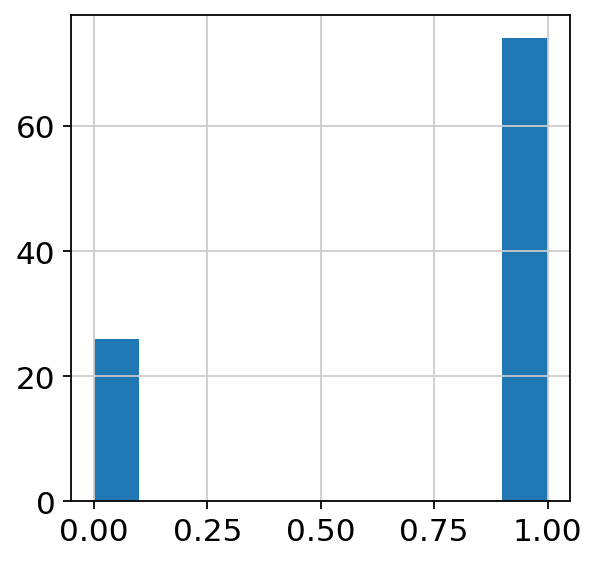

In [99]:
#now, a classifier with the bulk
sc_bulk=adata.uns['bulk.guide.compact']
X=sc_bulk

variant_mapping={'black':0,'#99CCFF':1,'navy':1}
keep=[]
y=[]
for i in range(len(sorted_variants)):
    variant=sorted_variants[i]
    if anno.loc[variant,'Cluster'] not in variant_mapping:
        continue
    keep.append(variant)
    var_group=variant_mapping[anno.loc[variant,'Cluster']]
    y.append(var_group)
plt.hist(y)
X=X.loc[keep,:]

In [100]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)
clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         solver='saga',
                         penalty='elasticnet',
                         l1_ratio=0.5,
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(50,)


Confusion matrix, without normalization
[[11  0]
 [ 0 39]]
Normalized confusion matrix
[[1. 0.]
 [0. 1.]]
Confusion matrix, without normalization
[[15  0]
 [ 1 34]]
Normalized confusion matrix
[[1.         0.        ]
 [0.02857143 0.97142857]]


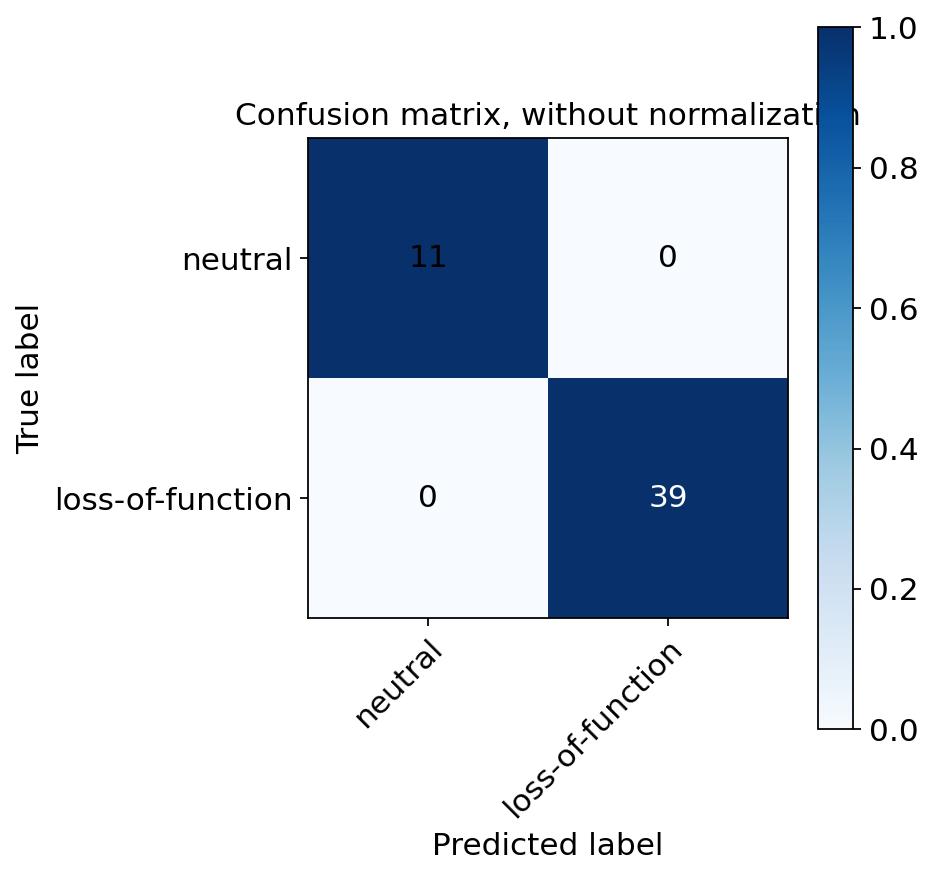

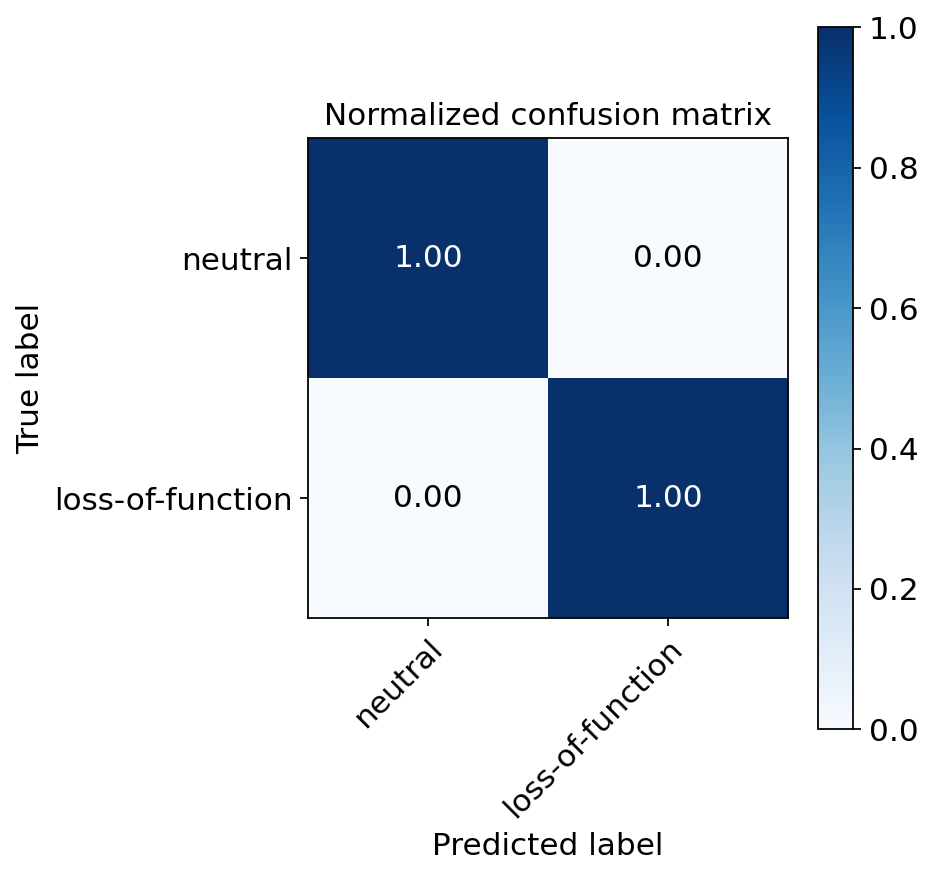

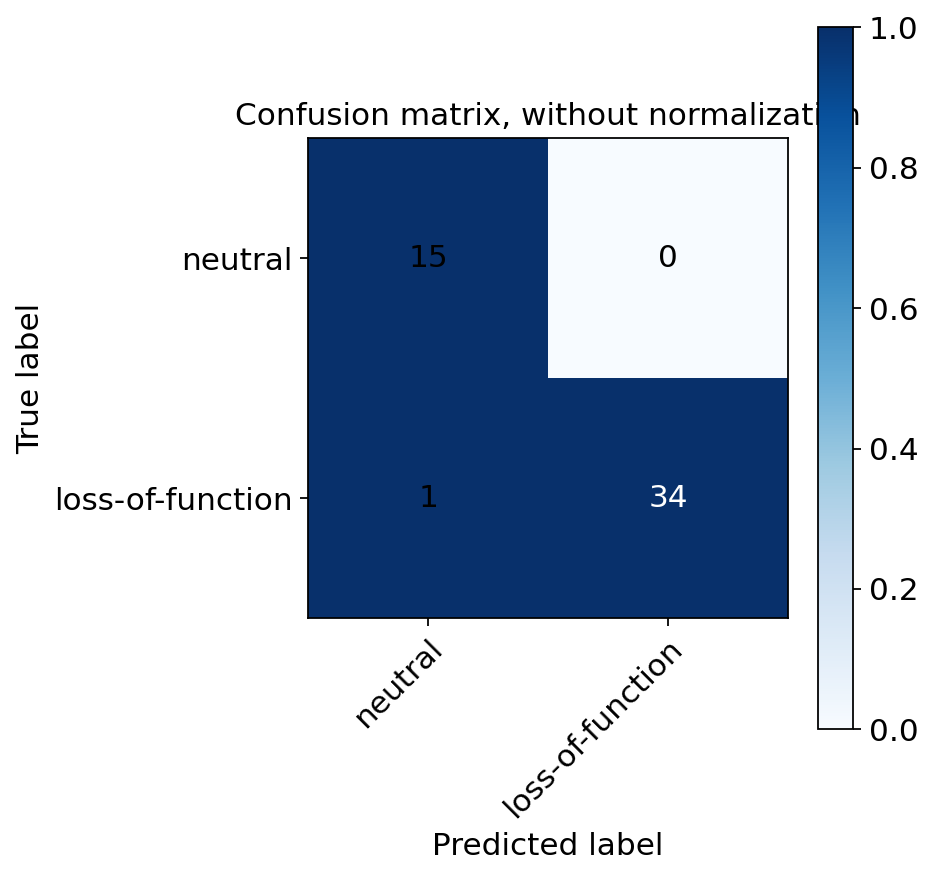

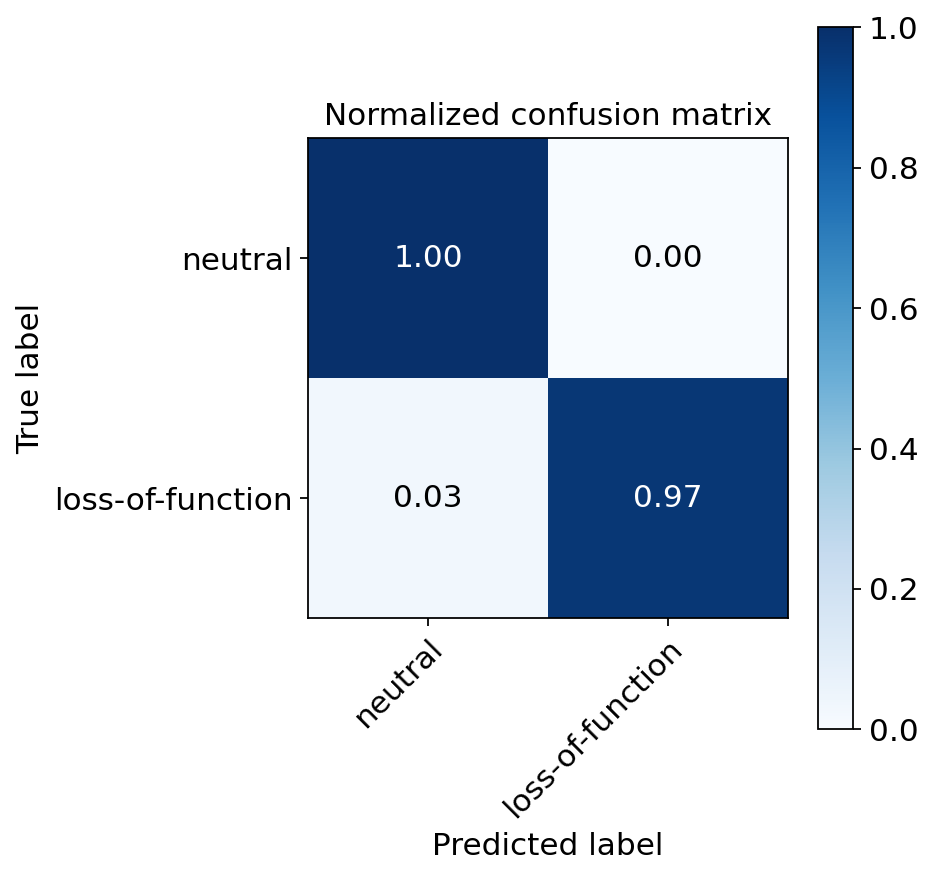

In [101]:
classes=['neutral','loss-of-function']
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_bulk.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_bulk.png',bbox_inches = "tight")

PCs
==

In [9]:
for pc in range(50):
    adata.obs['PC'+str(pc)]=-adata.obsm['X_pca'][:,pc]
adata

AnnData object with n_obs × n_vars = 85778 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', 'R249M', 

In [10]:
hotspot_var=list(anno.loc[anno['control_status2']=='hotspot',:].index)
neutrals=list(anno.loc[anno['control_status']=='synonymous',:].index)
print(hotspot_var)
print(neutrals)

['R175H', 'R273C', 'R248Q', 'R273H', 'R248W', 'R273L', 'R248L']
['F338F', 'P36P', 'D21D', 'P301P', 'T170T', 'P153P', 'E2E', 'P47P', 'P222P', 'V216V', 'R158R', 'P295P', 'T118T', 'P359P', 'L344L', 'WT']


... storing 'known_hotspot' as categorical


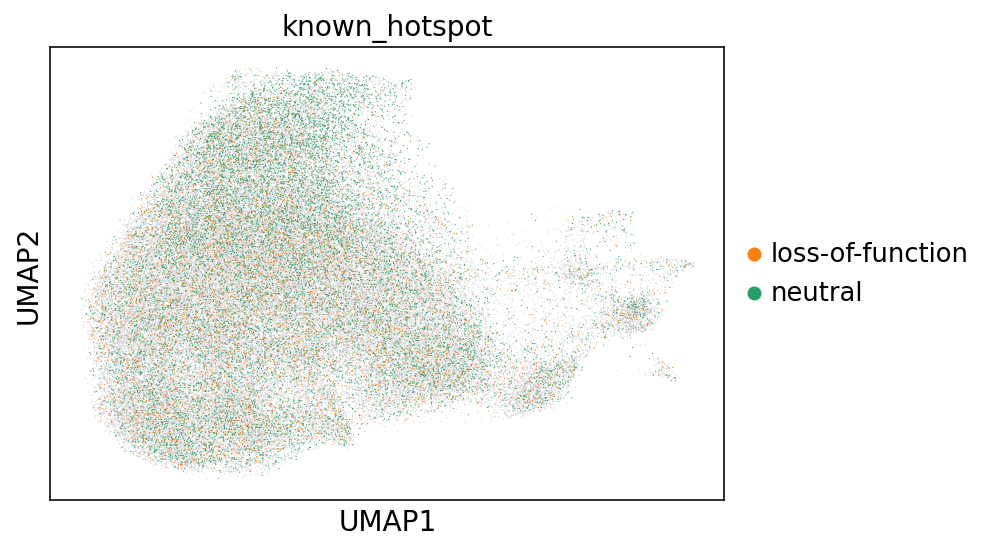

In [11]:
hotspot_pos=[]
for i in range(adata.n_obs):
    anno_here='NA'
    if adata.obs['guide.compact'][i] in hotspot_var:
        anno_here='loss-of-function'
    if adata.obs['guide.compact'][i] in neutrals:
        anno_here='neutral'
    hotspot_pos.append(anno_here)
adata.obs['known_hotspot']=hotspot_pos

sc.pl.umap(adata,color=['known_hotspot'],groups=['loss-of-function','neutral'])

In [12]:
#ttest PC between hostpot and the wildtypes
#genes in each PC

pc_pval=pd.DataFrame({'pc':range(50),'p':1,'t':0,'auPRC':0})
pc_pval.index=list(pc_pval['pc'])


attr='known_hotspot'
g1='loss-of-function'
g2='neutral'

for pc in range(50):
    if pc%10==0:
        print(pc)

    val='PC'+str(pc)
    g1_cells=adata.obs_names[adata.obs[attr]==g1]
    g2_cells=adata.obs_names[adata.obs[attr]==g2]
    g1_values=adata[g1_cells,:].obs[val]
    g2_values=adata[g2_cells,:].obs[val]

    from scipy.stats import ttest_ind
    
    res=ttest_ind(g1_values,g2_values)
    pc_pval.loc[pc,'p']=res[1]
    pc_pval.loc[pc,'t']=res[0]

0
10
20
30
40


In [13]:
from statsmodels.stats.multitest import multipletests

pc_pval['p.adj']=multipletests(pc_pval['p'],method='fdr_bh')[1]
pc_pval=pc_pval.sort_values(by='p.adj')

fdr=0.01
print(pc_pval.loc[pc_pval['p.adj']<=fdr,:].shape)
pc_pval.loc[pc_pval['p.adj']<=fdr,:]

(30, 5)


,pc,p,t,auPRC,p.adj
1,1,4.896953e-106,-22.021948,0,1.283644e-104
15,15,5.134574e-106,-22.019741,0,1.283644e-104
22,22,3.548746e-28,11.025934,0,5.914576e-27
2,2,7.048326e-26,-10.536008,0,8.810407e-25
9,9,1.361460e-25,-10.473497,0,1.361460e-24
13,13,2.453587e-25,-10.417263,0,2.044656e-24
7,7,2.531716e-24,10.191475,0,1.808369e-23
4,4,1.095951e-21,-9.580111,0,6.849694e-21
29,29,3.371494e-21,9.462745,0,1.873052e-20
24,24,5.230193e-20,9.170297,0,2.615097e-19


In [13]:
bulk_programs_pc_un,p_pc_un=get_bulk_programs_with_sig(adata,['PC'+str(x) for x in range(10)],
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)

PC0
PC1
PC2
PC3
PC4
PC5
PC6
PC7
PC8
PC9


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


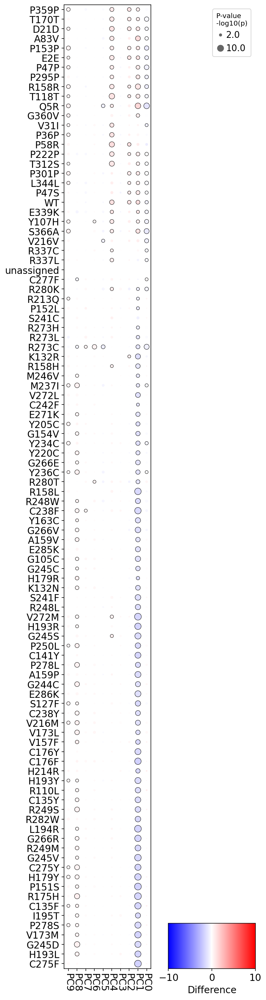

In [16]:
dotplot_programs(bulk_programs_pc_un,p_pc_un,
                 myorder=['PC'+str(x) for x in range(10)],
                 sorted_variants=sorted_variants,
                 best_p=1e-10,
                 vmin=-10,vmax=10)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_unassigned.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_unassigned.png',bbox_inches = "tight")

View of AnnData object with n_obs × n_vars = 17476 × 1224 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'uninfected', 'vbc.counts', 'batch_num18', 'batch_num8', 'batch_num25', 'batch_num22', 'batch_num24', 'batch_num28', 'batch_num27', 'batch_num23', 'batch_num17', 'batch_num19', 'batch_num12', 'batch_num31', 'batch_num5', 'batch_num15', 'batch_num7', 'batch_num9', 'batch_num4', 'batch_num2', 'batch_num13', 'batch_num6', 'batch_num26', 'batch_num16', 'batch_num10', 'batch_num1', 'batch_num29', 'batch_num0', 'batch_num11', 'batch_num30', 'batch_num3', 'batch_num14', 'batch_num21', 'batch_num20', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'G105C', 'G266E', 'G154V', 'Y220C', 'V216V', 'WT', 'M246V', 'E286K', 'C176Y', 'S366A', 'H193Y', 'L344L', 'E339K', 'P47P', 'V173M', 'V272L', 'R158H', 'C135F', 'A83V', 'L194R', 'T312S', 'S127F', 'R249S', 'R337L', 'R273H', 'V272M', 'R273L', 'Q5R', '

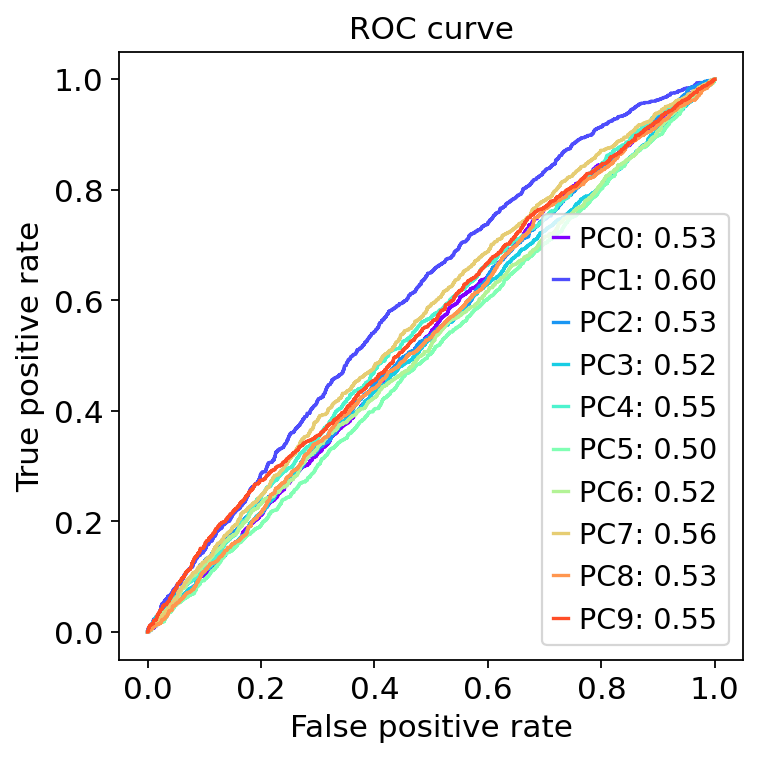

In [107]:
#classification by PCs
adata2=adata[adata.obs['known_hotspot'].isin(['neutral','loss-of-function']),:]
print(adata2)

adata3=perturb.pp.subsample_cells(adata2,10000,'known_hotspot')
print(adata3)

#X = expression
pcs=range(10)

fig,plots=plt.subplots(1)
fig.set_size_inches(5,5)

for pc in pcs:
    X=pd.DataFrame(adata3.obsm['X_pca'][:,pc],index=adata3.obs_names)

    #y=variant class
    variant_mapping={'neutral':0,'loss-of-function':1}
    y=[]
    for i in range(len(adata3.obs_names)):
        var_group=variant_mapping[adata3.obs['known_hotspot'][i]]
        y.append(var_group)
    classes=['neutral','loss-of-function']
   
    from sklearn.model_selection import train_test_split
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.7)
    
    from sklearn.datasets import make_gaussian_quantiles
    from sklearn.ensemble import AdaBoostClassifier
    from sklearn.metrics import accuracy_score
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.linear_model import LogisticRegression
    import numpy as np
    import matplotlib.pyplot as plt
    from sklearn import svm, datasets
    from sklearn.model_selection import train_test_split
    from sklearn.metrics import confusion_matrix
    from sklearn.utils.multiclass import unique_labels
    from sklearn.linear_model import LogisticRegression
    from sklearn.metrics import roc_curve



    clf = LogisticRegression(random_state=0, multi_class='multinomial',penalty='l2',
                            max_iter=500)
    clf.fit(X_train, y_train)

    #predict===================
    pred_valid=clf.predict(X_valid)
    pred_train=clf.predict(X_train)
    pred_valid_scores=clf.predict_proba(X_valid)[:,1]
    print(pred_valid.shape)
    
    #plot_confusion_matrix(y_valid, 
    #                  pred_valid, 
    #                  classes=classes,normalize=True,title='PC'+str(pc))
    
    print(pc,clf.score(X_valid, y_valid))
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(vmin=0, vmax=len(pcs), clip=True)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.rainbow)
    mapped_color=mapper.to_rgba(pc) #where v is the value
    fpr_rt, tpr_rt, _ = roc_curve(y_valid, pred_valid_scores)
    from sklearn import metrics
    auROC=round(metrics.auc(fpr_rt, tpr_rt),2)

    
    plots.plot(fpr_rt, tpr_rt, label='PC'+str(pc)+': '+"%.2f" % auROC,color=mapped_color)
plots.set_xlabel('False positive rate')
plots.set_ylabel('True positive rate')
plots.set_title('ROC curve')
plots.legend(loc='best')
plots.grid(False)
plt.savefig(FIGS+'/'+PROTEIN+'.PCauROC.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PCauROC.png',bbox_inches = "tight")

In [14]:
bulk_programs_pc,p_pc=get_bulk_programs_with_sig(adata,['PC'+str(x) for x in range(10)],
                                           ref='WT',variant_col='guide.compact',
                                           fdr=0.1)

PC0
PC1
PC2
PC3
PC4
PC5
PC6
PC7
PC8
PC9


In [18]:
p_pc.min()

PC0    1.091602e-03
PC1    1.121325e-13
PC2    4.056753e-07
PC3    1.326231e-02
PC4    5.553630e-07
PC5    1.462342e-03
PC6    1.733999e-03
PC7    1.018310e-03
PC8    7.421260e-03
PC9    1.223962e-02
dtype: float64

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


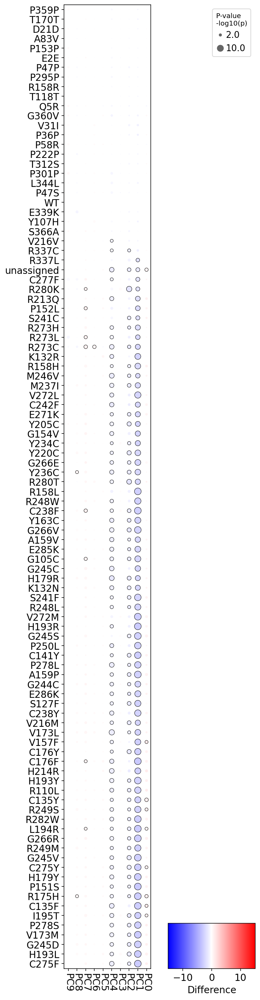

In [25]:
def dotplot_programs(bulk_programs,p,myorder,sorted_variants,
                     best_p=1e-5,fdr=0.01,vmin=-0.5,vmax=0.5,w=5,h=25,
                    title='Difference',cbar_percent="5%",widths=[1,1]):
    
    
    mlog_bestp=-np.log10(best_p)
    
    bulk_programs_long=pd.DataFrame(bulk_programs.loc[sorted_variants[::-1],myorder[::-1]].unstack())   
    idx=bulk_programs_long.index.to_frame()
    bulk_programs_long['variants']=idx[1]
    bulk_programs_long['cl']=idx[0]
    
    p_long=pd.DataFrame(p.loc[sorted_variants[::-1],myorder[::-1]].unstack()) 
    idx=p_long.index.to_frame()
    p_long['variants']=idx[1]
    p_long['cl']=idx[0]
    
    
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(clip=True,vmin=vmin,vmax=vmax)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.bwr)
    colors=mapper.to_rgba(bulk_programs_long[0])

    #fig,plots=plt.subplots(1,2)
    #fig.set_size_inches(w,h)
    from matplotlib import gridspec

    fig = plt.figure()
    spec = gridspec.GridSpec(ncols=2, nrows=1,
                     width_ratios=widths)
    fig.set_size_inches(w,h)
    plots = [fig.add_subplot(spec[0]),fig.add_subplot(spec[1])]
    
    mini_size=1
    x_vector=bulk_programs_long['cl']
    y_vector=bulk_programs_long['variants']
    sizes=p_long[0]
    sizes[sizes<best_p]=best_p
    borders=0.5*(sizes<=fdr)*1.0
    sizes=-np.log10(sizes)*100.0/(-np.log10(best_p))
    
    scatter_output=plots[0].scatter(x_vector,y_vector,
                       c=colors,s=sizes,
                       edgecolor='black',
                         linewidth=borders)
    
    plots[0].grid(False)
    plots[0].set_xticks(myorder)
    plots[0].set_xticklabels(myorder)
    plots[0].set_xticklabels(plots[0].get_xticklabels(), rotation=270)
    plots[0].set_ylim(-0.5,len(sorted_variants)-0.5)
    plots[0].set_xlim(-0.5,len(myorder)-0.5)
    
    #sizes
    handles, labels = scatter_output.legend_elements(prop="sizes", alpha=0.6,num=5)
    labels2=[]
    import re
    for i in range(len(labels)):
        i_num=float(re.sub('\$\\\\mathdefault{','',re.sub('}\$','',labels[i])))
        i_num_processed=np.power(10,1.0*i_num*np.log10(best_p)/100.0)
        i_num_processed=i_num/100.0*(-np.log10(best_p))
        labels2.append(i_num_processed)
    min_size=labels2[0]
    max_size=labels2[len(labels2)-1]
    min_handle=handles[0]
    labels_ends=[min_size,max_size]
    handles_ends=[handles[0],handles[len(handles)-1]]
    legend2 = plots[1].legend(handles_ends, labels_ends, loc="upper right", title="P-value\n-log10(p)")
    
    plots[1].grid(False)
    plots[1].set_xticks([])
    plots[1].set_yticks([])
    plots[1].spines['right'].set_visible(False)
    plots[1].spines['left'].set_visible(False)
    plots[1].spines['top'].set_visible(False)
    plots[1].spines['bottom'].set_visible(False)
    
    import matplotlib as mpl
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    divider = make_axes_locatable(plots[1])
    cax = divider.append_axes("bottom", size=cbar_percent, pad=0.25)
    cb=fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cm.bwr), 
                    cax=cax,orientation='horizontal',
                   cmap=cm.bwr)
    cb.set_label(title)

dotplot_programs(bulk_programs_pc,p_pc,
                 myorder=['PC'+str(x) for x in range(10)],
                 sorted_variants=sorted_variants,
                 best_p=1e-10,
                 vmin=-15,vmax=15)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_WT.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_WT.png',bbox_inches = "tight")

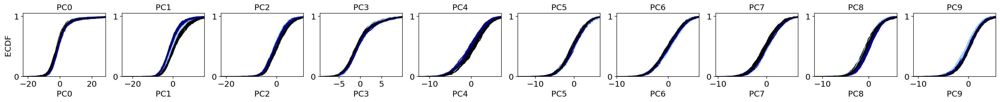

In [111]:
ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             ['PC'+str(x) for x in range(10)],
             grouping_variable='guide.compact',
             grouping_variable_color=anno['Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_variant.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_variant.png',bbox_inches = "tight")

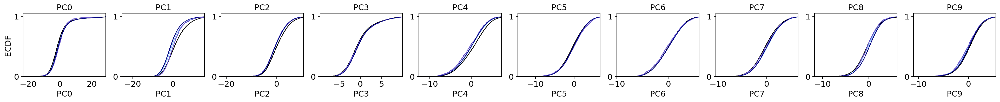

In [112]:
colors=list(set(anno['Cluster2']))
colors_df=pd.DataFrame({'color':colors},index=colors)

ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             ['PC'+str(x) for x in range(10)],
             grouping_variable='Cluster2',
             grouping_variable_color=colors_df)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_module.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_module.png',bbox_inches = "tight")

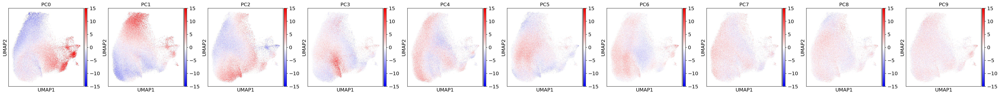

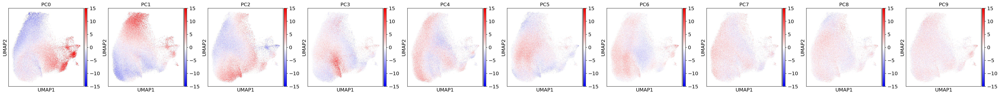

In [113]:
#plot the umaps
x=15
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=['PC'+str(x) for x in range(10)],cmap='bwr',ncols=10,vmin=-x,vmax=x,
          save=PROTEIN+'_PC_scores.pdf')
sc.pl.umap(adata,color=['PC'+str(x) for x in range(10)],cmap='bwr',ncols=10,vmin=-x,vmax=x,
          save=PROTEIN+'_PC_scores.png')

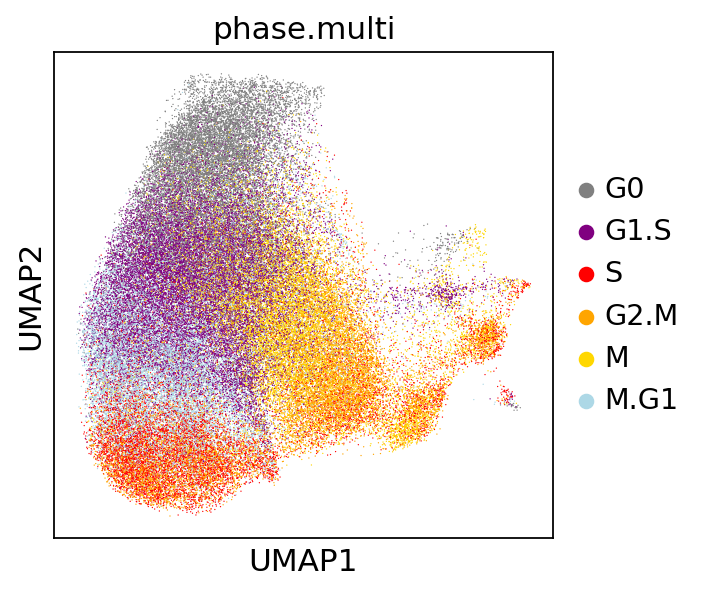

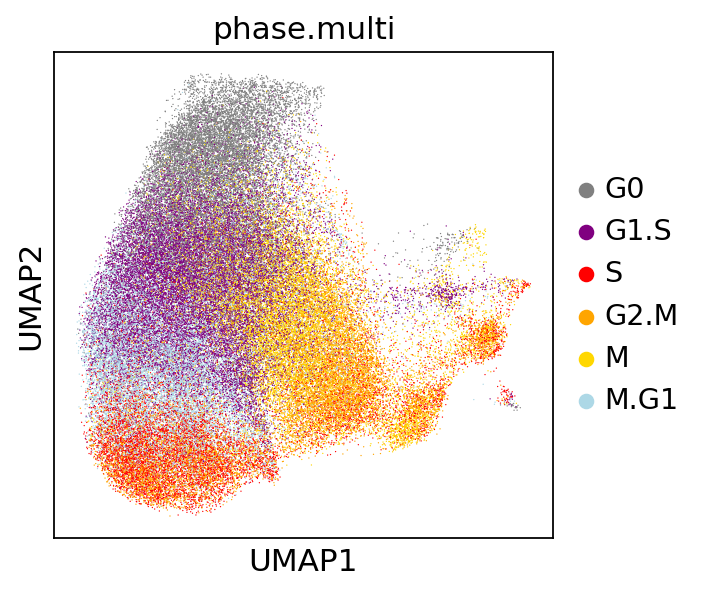

In [114]:
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=['phase.multi'],
          save=PROTEIN+'cellcycle.pdf')
sc.pl.umap(adata,color=['phase.multi'],
          save=PROTEIN+'cellcycle.png')

In [28]:
bulk_programs_louvain_pro,p_louvain_pro=get_bulk_programs_with_sig(adata[adata.obs['guide.compact']!='multiple',:],
                                                                         my_programs,
                                           ref=None,variant_col='louvain',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


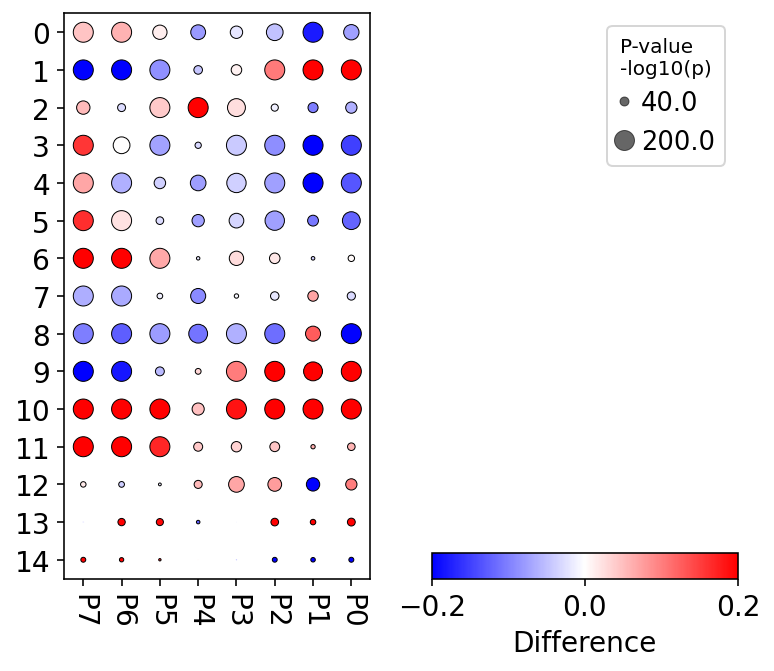

In [30]:
louvains=['0','1','2','3','4','5','6','7','8','9','10','11','12','13','14']
dotplot_programs(bulk_programs_louvain_pro,p_louvain_pro,
                 myorder=my_programs,
                 sorted_variants=louvains,
                 best_p=1e-200,
                 vmin=-0.2,vmax=0.2,w=6,h=5)

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_vs_programs.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_vs_programs.png',bbox_inches = "tight")

Cellular phenotyping
==

In [6]:
f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-06-07/TP53/mutational_signatures/TP53_mutationalSignatures_Giacomelli.txt'
mutsig=pd.read_csv(f,sep='\t',skiprows=1)
mutsig.index=mutsig['Allele']
print(mutsig.head())

#modify the names for the synonymous ones
import re
new_vars=[]
for i in range(mutsig.shape[0]):
    v=mutsig.index[i]
    new_var_here=v
    if 'B' in v:
        new_var_here=re.sub('B',v[0],v)
    new_vars.append(new_var_here)
mutsig.index=new_vars


       Allele AA_wt AA_variant  Position  A549_p53WT_Nutlin-3_Z-score  \
Allele                                                                  
R175H   R175H     R          H       175                     1.791388   
R248Q   R248Q     R          Q       248                     1.233480   
R273H   R273H     R          H       273                     1.145501   
R248W   R248W     R          W       248                     1.552718   
R273C   R273C     R          C       273                     1.261347   

        A549_p53NULL_Nutlin-3_Z-score  A549_p53NULL_Etoposide_Z-score  \
Allele                                                                  
R175H                        0.538396                       -0.744765   
R248Q                        0.217053                       -0.985385   
R273H                        1.077844                       -1.438387   
R248W                        0.613931                       -0.689231   
R273C                        0.314304             

In [7]:
func_data=mutsig.loc[sorted_variants,['A549_p53WT_Nutlin-3_Z-score', 'A549_p53NULL_Nutlin-3_Z-score',
       'A549_p53NULL_Etoposide_Z-score']]

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


In [11]:
for assay in func_data.columns:
    anno[assay]=func_data.loc[anno.index,assay]

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


In [18]:
set(anno['Cluster'])

{'#99CCFF', 'black', nan, 'navy'}

In [21]:
dom_neg=anno.loc[anno['A549_p53WT_Nutlin-3_Z-score']>0.61,:].index
print(dom_neg)
non_dom_neg=set(anno.index).difference(set(dom_neg).union(set(anno.loc[anno['Cluster']=='black',:].index)))
print(non_dom_neg)

print(func_data.loc[non_dom_neg,:])
print(anno.loc[non_dom_neg,:])

Index(['R175H', 'R273C', 'R273H', 'R248W', 'R282W', 'Y220C', 'G245S', 'V157F',
       'H179R', 'E285K', 'Y163C', 'M237I', 'R273L', 'R158L', 'C176F', 'S241F',
       'H193R', 'I195T', 'P278S', 'G245D', 'Y234C', 'R249S', 'H179Y', 'V173L',
       'Y236C', 'C238Y', 'E286K', 'G266R', 'S127F', 'R158H', 'L194R', 'V272M',
       'K132N', 'C176Y', 'Y205C', 'R280T', 'P151S', 'A159V', 'G245V', 'G245C',
       'G266E', 'P152L', 'H214R', 'V216M', 'E271K', 'C242F', 'R248L', 'C135Y',
       'V173M', 'C135F', 'H193Y', 'C238F', 'C141Y', 'H193L', 'K132R', 'G154V',
       'C277F', 'R110L', 'A159P', 'P250L', 'R213Q', 'C275F', 'G266V', 'C275Y',
       'R249M', 'V272L', 'P278L', 'G244C', 'M246V', 'S241C'],
      dtype='object', name='Variant')
{'unassigned', 'R280K', 'R248Q', 'F338F', 'R337L', 'G105C'}
            A549_p53WT_Nutlin-3_Z-score  A549_p53NULL_Nutlin-3_Z-score  \
unassigned                          NaN                            NaN   
R280K                          0.370045                     

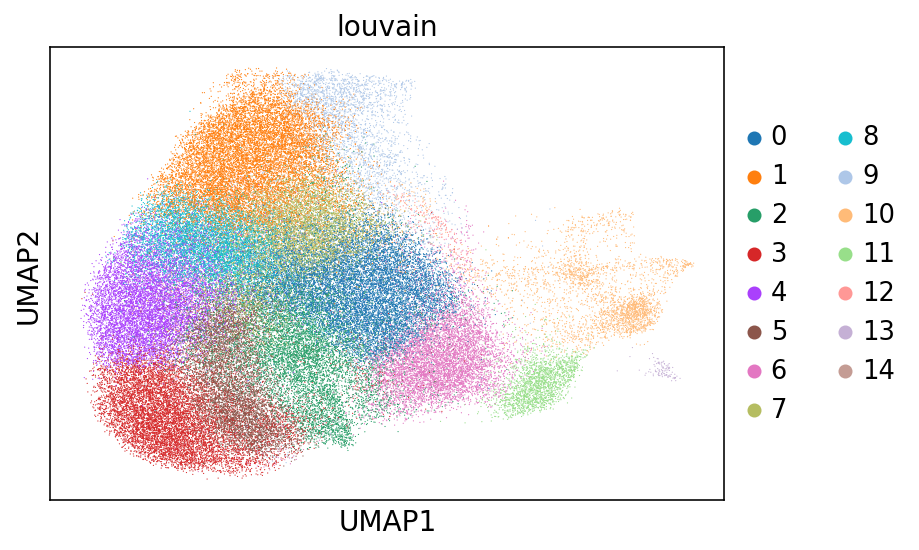

In [39]:
sc.pl.umap(adata,color=['louvain'])

3 SpearmanrResult(correlation=0.4578920859553495, pvalue=2.130486220456317e-06)
10 SpearmanrResult(correlation=0.020886663077697907, pvalue=0.8382466578265273)
0 SpearmanrResult(correlation=0.4957267681896548, pvalue=2.1019078322457823e-07)
8 SpearmanrResult(correlation=0.5852207703641819, pvalue=2.4759584953463043e-10)
7 SpearmanrResult(correlation=0.308106229898568, pvalue=0.002025875306814488)
12 SpearmanrResult(correlation=0.22563955435450625, pvalue=0.025486292390694346)
13 SpearmanrResult(correlation=0.04109447179466656, pvalue=0.6878572497326602)
11 SpearmanrResult(correlation=0.08542801676386039, pvalue=0.4029445989210797)
6 SpearmanrResult(correlation=-0.014032649340039484, pvalue=0.8909197389438209)
9 SpearmanrResult(correlation=-0.6548972728586513, pvalue=2.5722671511506454e-13)
14 SpearmanrResult(correlation=-0.022700527910109933, pvalue=0.8244158622509218)
1 SpearmanrResult(correlation=-0.6996305352015325, pvalue=1.1086431663078584e-15)
2 SpearmanrResult(correlation=0.4044

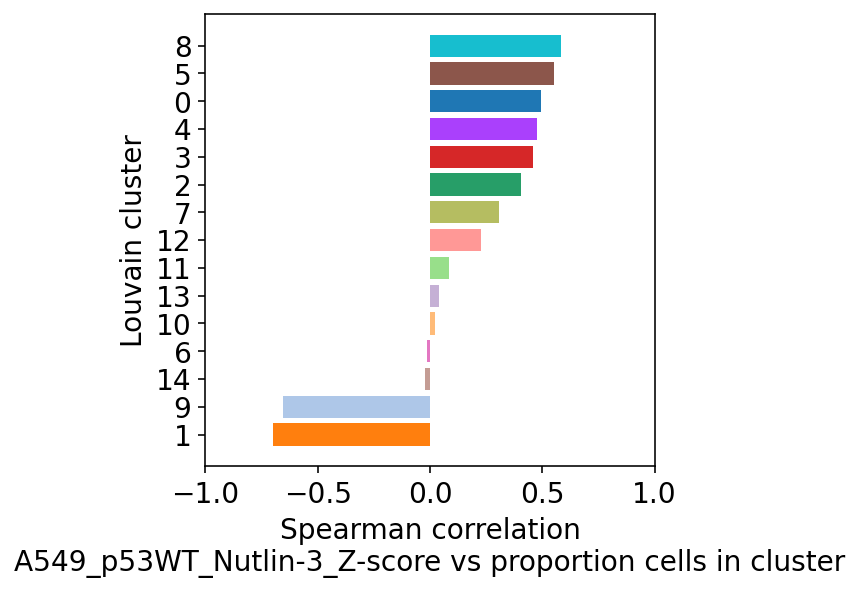

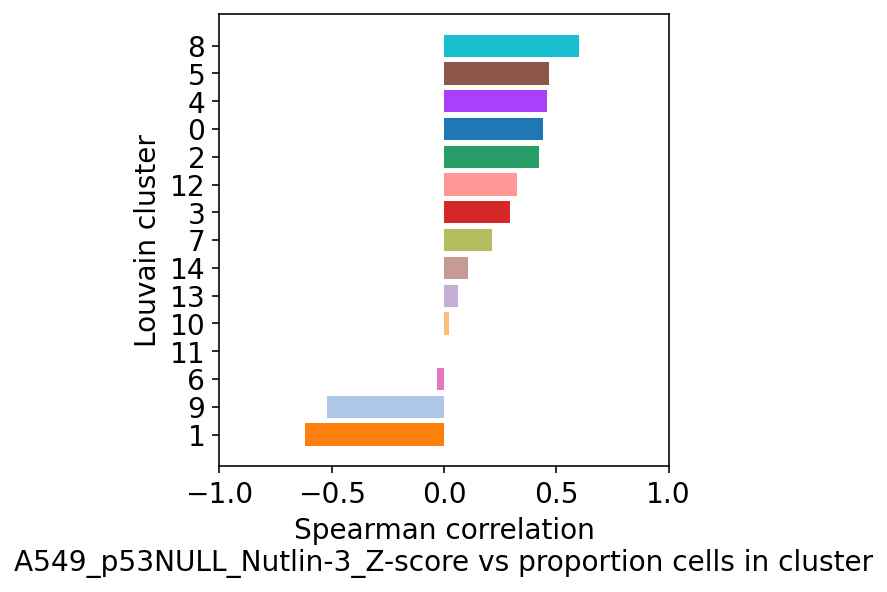

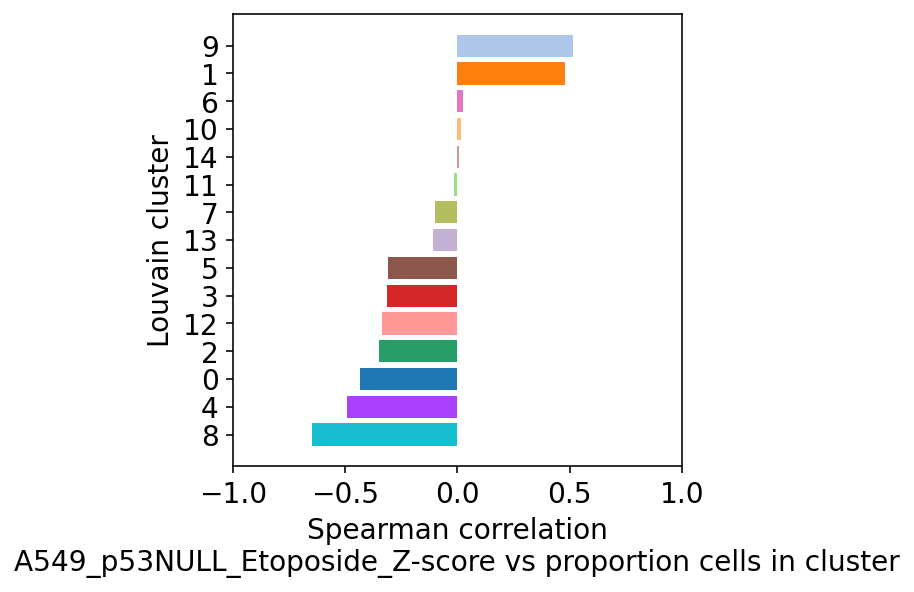

In [40]:
#corr louvain proportions with assays
#barplot with all the correlations

for assay in func_data.columns:
    louvs=set(adata.obs['louvain'])
    corr_assay=pd.DataFrame({'corr':0},index=louvs)
    for cl in louvs:
        from scipy.stats import spearmanr
        corres=spearmanr(louv_res['data.norm'].loc[sorted_variants,cl],
                   func_data.loc[sorted_variants,assay],nan_policy='omit')
        print(cl,corres)
        c=corres[0]
        corr_assay.loc[cl,'corr']=c

    corr_assay=corr_assay.sort_values(by='corr')

    #cluster colors
    categories=adata.obs['louvain'].cat.categories
    colors=pd.DataFrame({'cl':categories,'color':adata.uns['louvain_colors']},index=categories)
    print(colors)

    fig,plots=plt.subplots(1)
    fig.set_size_inches(4,4)
    plots.barh(corr_assay.index,corr_assay['corr'],color=colors.loc[corr_assay.index,'color'])
    plots.set_xlim(-1,1)
    plots.grid(False)
    plots.set_xlabel('Spearman correlation\n'+assay+' vs proportion cells in cluster')
    plots.set_ylabel('Louvain cluster')

    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'.png',bbox_inches = "tight")

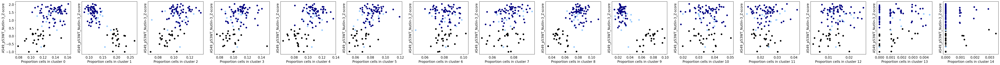

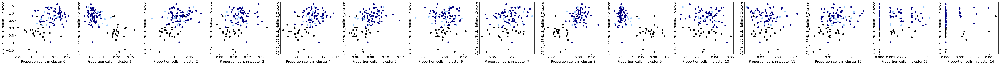

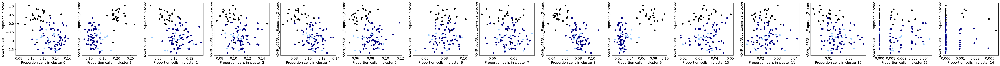

In [42]:
#proportion of each Louvain vs the func data

for assay in func_data.columns:

    n=len(list(set(adata.obs['louvain'])))
    fig,plots=plt.subplots(1,n)
    fig.set_size_inches(n*5,4)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    idx=0
    for cl in ['0','1','2','3','4',
               '5','6','7','8','9',
               '10','11','12','13','14']:

        plots[idx].scatter(louv_res['data.norm'].loc[sorted_variants,cl],
                   func_data.loc[sorted_variants,assay],
                          color=anno.loc[sorted_variants,'cluster_color'])
        plots[idx].set_xlabel('Proportion cells in cluster '+cl)
        plots[idx].set_ylabel(assay)
        plots[idx].grid(False)

        '''
        for i, txt in enumerate(sorted_variants):
            plots[idx].annotate(txt, (louv_res['data.norm'].loc[sorted_variants,cl][i], 
                               func_data.loc[sorted_variants,assay][i]),fontsize=7)
        '''
        if idx!=0:
            plots[idx].set_yticks([])

        idx+=1
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'_scatter.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'_scatter.png',bbox_inches = "tight")
    plt.show()

['P0', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7']


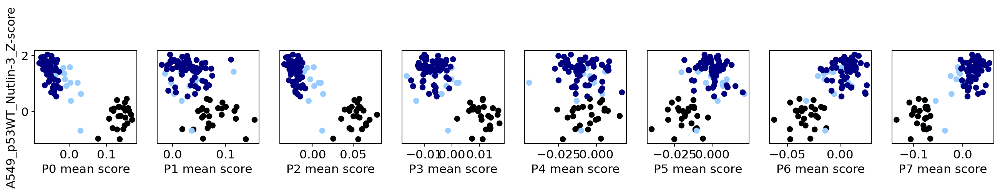

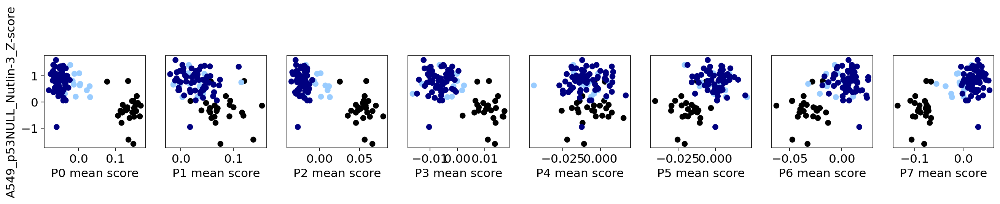

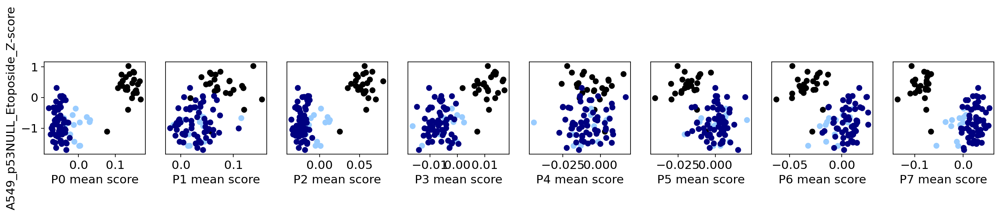

In [42]:

print(my_programs)
n_pro=len(my_programs)
for assay in func_data.columns:

    fig,plots=plt.subplots(1,n_pro)
    fig.set_size_inches(n_pro*2.5,2)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    idx=0
    for pro in my_programs:

        plots[idx].scatter(adata.uns['bulk.programs.avg'].loc[sorted_variants,pro],
                   func_data.loc[sorted_variants,assay],color=anno.loc[sorted_variants,'Cluster'])
        plots[idx].set_xlabel(pro+' mean score')
        plots[idx].set_ylabel(assay)
        plots[idx].grid(False)

        if idx!=0:
            plots[idx].set_yticks([])
            plots[idx].set_ylabel('')

        idx+=1

        plt.savefig(FIGS+'/'+PROTEIN+'programs_vs_'+assay+'.pdf',bbox_inches = "tight") 
        plt.savefig(FIGS+'/'+PROTEIN+'programs_vs_'+assay+'.png',bbox_inches = "tight")
 
    

0
100
200
300
400
500
600
700
800
900
1000
1100
1200


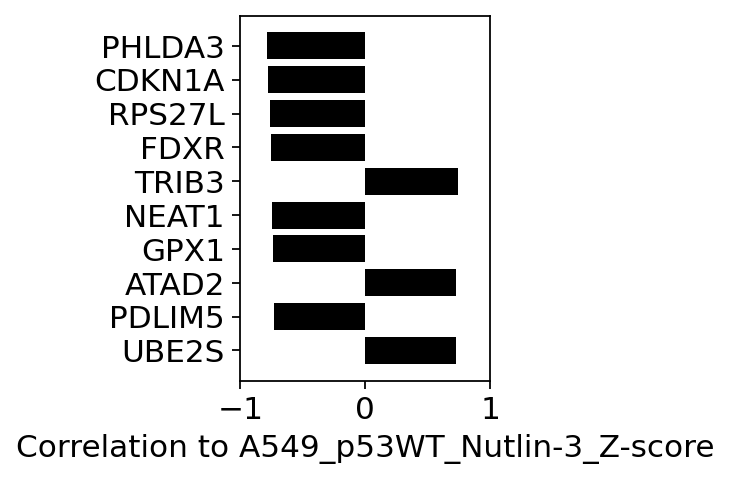

0
100
200
300
400
500
600
700
800
900
1000
1100
1200


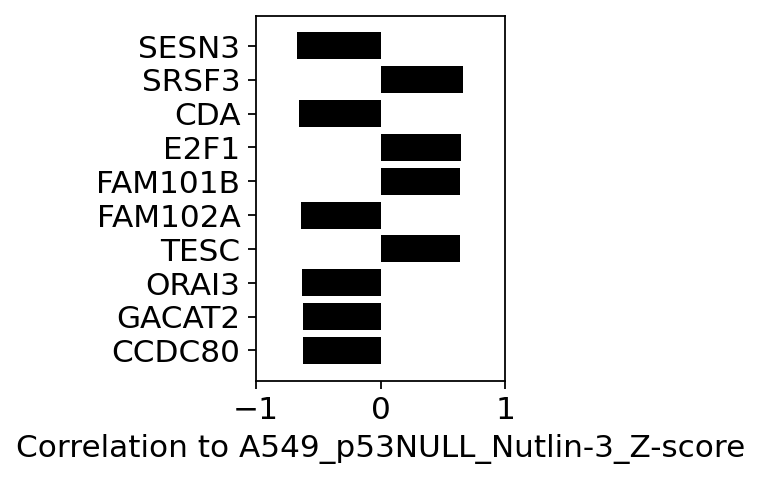

0
100
200
300
400
500
600
700
800
900
1000
1100
1200


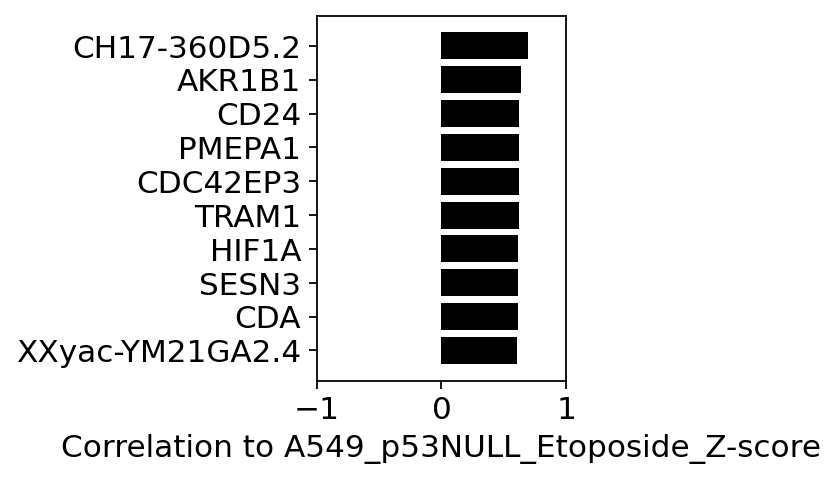

In [81]:
for assay in func_data.columns:

    nutl_corr=pd.DataFrame({'gene':adata.var_names,'corr':0},index=adata.var_names)
    from scipy.stats import spearmanr,pearsonr
    counter=0
    for gene in adata.var_names:
        if counter%100==0:
            print(counter)
        counter+=1
        c=spearmanr(sc_bulk.loc[sorted_variants,gene],
                    func_data.loc[sorted_variants,assay],nan_policy='omit')[0]
        nutl_corr.loc[gene,'corr']=c
        
    #plot me the top correlated/anticorr genes
    fig,plots=plt.subplots(1)
    fig.set_size_inches(2,3)


    absolutes=pd.DataFrame(nutl_corr['corr']).abs()
    top_genes=absolutes.sort_values(by='corr',ascending=False).index[:10]



    plots.barh(top_genes,nutl_corr.loc[top_genes,'corr'],color='black')
    plots.invert_yaxis()
    plots.grid(False)
    plots.set_xlabel('Correlation to '+assay)
    plots.set_title('')
    plots.set_xlim(-1,1)
    plt.savefig(FIGS+'/'+PROTEIN+'func_genes_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'func_genes_'+assay+'.png',bbox_inches = "tight")
    plt.show()
    
    

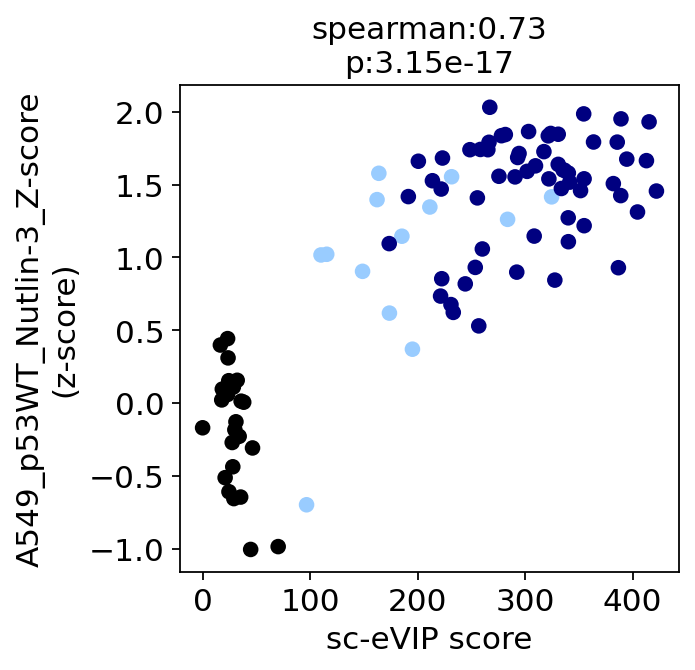

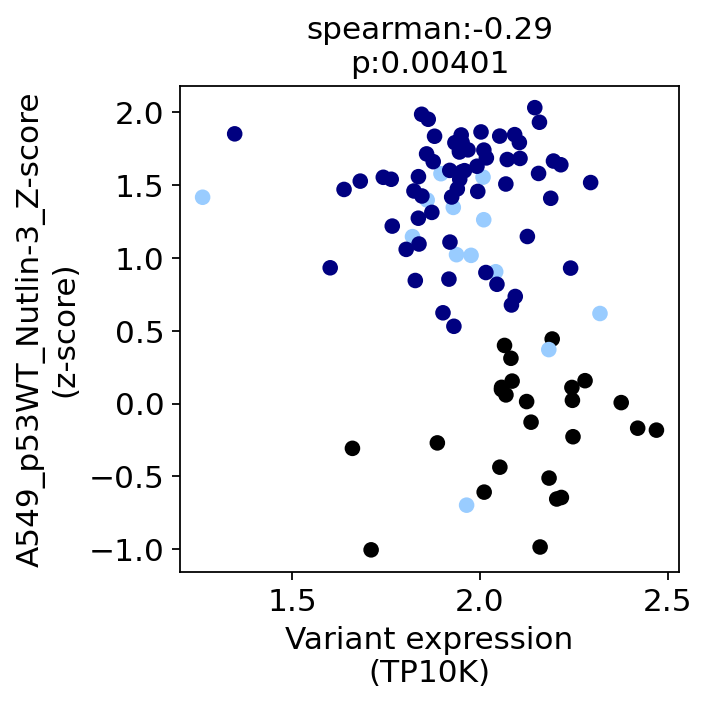

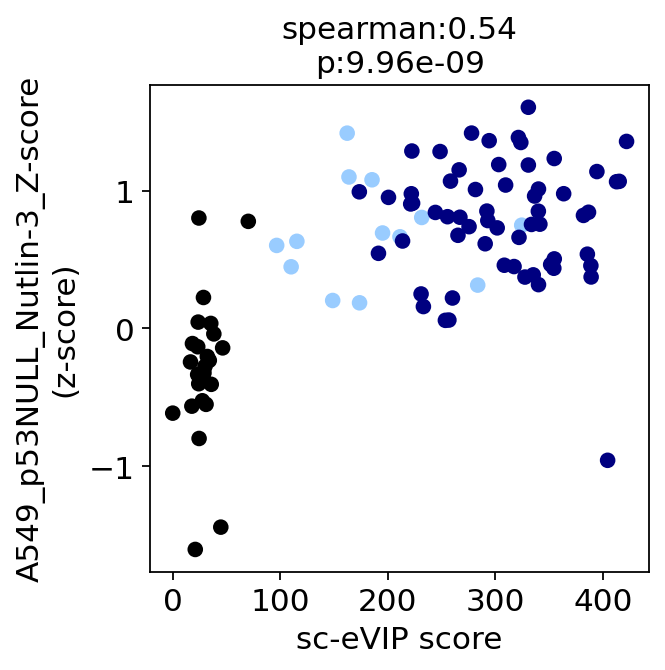

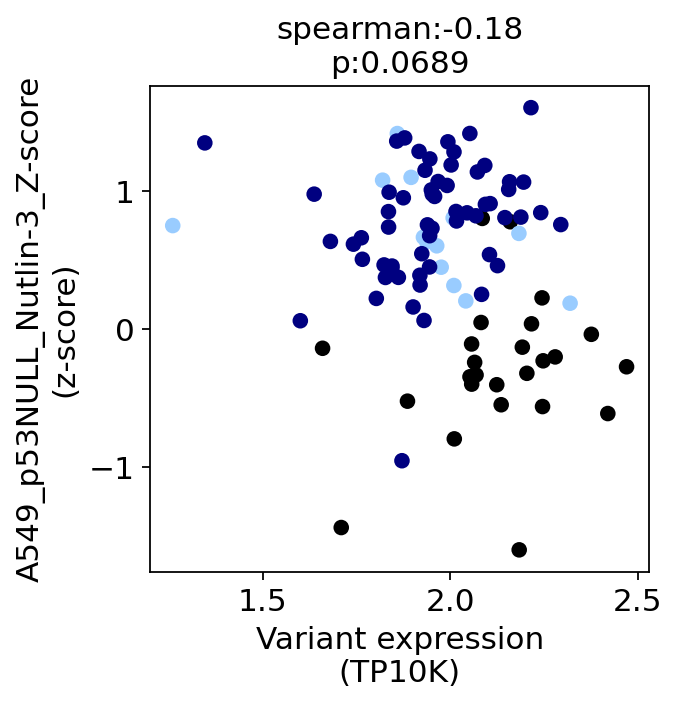

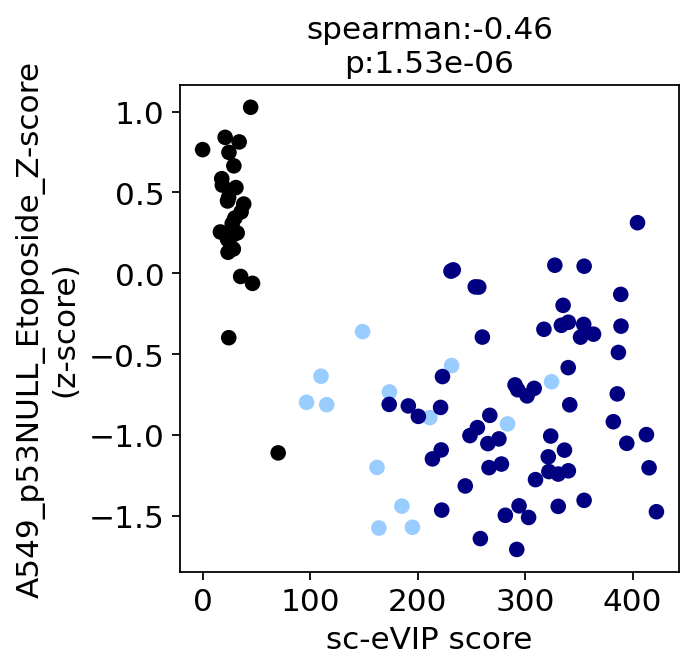

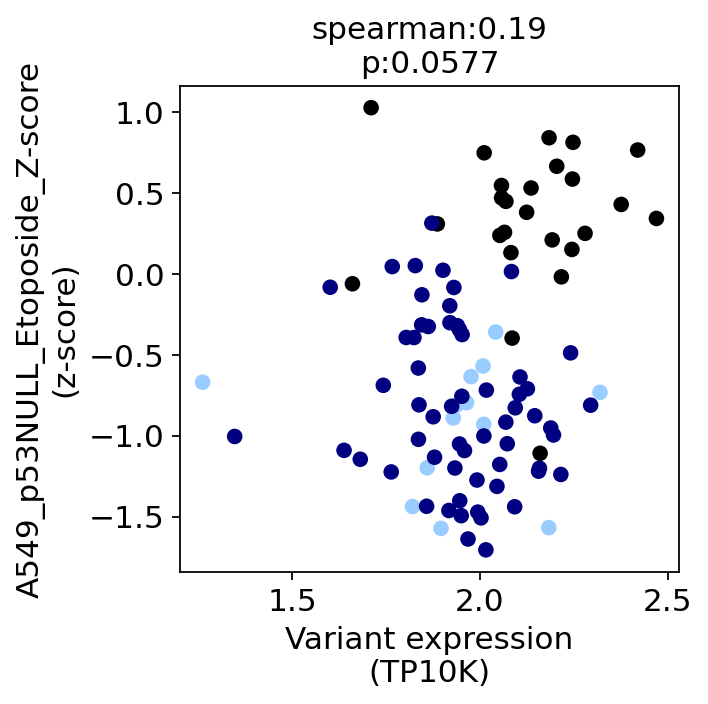

In [32]:

for assay in func_data.columns:
    
    fun_scatter(anno.loc[sorted_variants,score],
                 func_data.loc[sorted_variants,assay],
                 color=anno.loc[sorted_variants,'cluster_color'])

    plt.grid(False)
    plt.xlabel('sc-eVIP score')
    plt.ylabel(assay+'\n(z-score)')

    plt.xticks([0,100,200,300,400])

    plt.savefig(FIGS+'/'+PROTEIN+'func_scatter_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'func_scatter_'+assay+'.png',bbox_inches = "tight")
    
    fun_scatter(anno.loc[sorted_variants,'variant_expression'],
                 func_data.loc[sorted_variants,assay],
                 color=anno.loc[sorted_variants,'cluster_color'])

    plt.grid(False)
    plt.xlabel('Variant expression\n(TP10K)')
    plt.ylabel(assay+'\n(z-score)')
    plt.savefig(FIGS+'/'+PROTEIN+'func_vs_expr_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'func_vs_expr_'+assay+'.png',bbox_inches = "tight")

In [89]:
mutsig.columns

Index(['Allele', 'AA_wt', 'AA_variant', 'Position',
       'A549_p53WT_Nutlin-3_Z-score', 'A549_p53NULL_Nutlin-3_Z-score',
       'A549_p53NULL_Etoposide_Z-score', 'Signature_1', 'Signature_2',
       'Signature_3', 'Signature_4', 'Signature_4*', 'Signature_5',
       'Signature_6', 'Signature_7', 'Signature_8', 'Signature_9',
       'Signature_10', 'Signature_11', 'Signature_12', 'Signature_13',
       'Signature_14', 'Signature_15', 'Signature_16', 'Signature_17',
       'Signature_18', 'Signature_19', 'Signature_20', 'Signature_21',
       'Signature_22', 'Signature_23', 'Signature_24', 'Signature_25',
       'Signature_26', 'Signature_27', 'Signature_28', 'Signature_29',
       'Signature_30', 'IARC_Mutation_Counts', 'GENIE_Mutation_Counts',
       'Phenotypic_Selection_Model', 'Mutational_Signatures_Model',
       'Combined_Model', 'Unnamed: 43', 'Unnamed: 44', 'Unnamed: 45'],
      dtype='object')

In [44]:
np.max(mutsig['IARC_Mutation_Counts'].astype(float))

1221.0

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


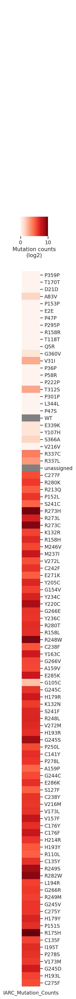

In [90]:
x=10

sns.set(rc={'axes.facecolor':'gray'})
mutdata=pd.DataFrame(np.log2(1+mutsig['IARC_Mutation_Counts'].astype(float)))

g=sns.clustermap(mutdata.loc[sorted_variants,:],cmap='Reds',
                 vmin=0,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.73, 0.85, 0.015),
                 cbar_kws={'orientation':'horizontal',
                "label": "Mutation counts\n(log2)",
                'ticks':[0,x]},
                figsize=(1,40)) 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_IARC.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_IARC.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


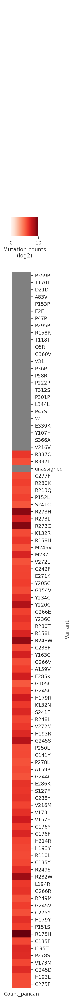

In [91]:
x=10

sns.set(rc={'axes.facecolor':'gray'})
mutdata=pd.DataFrame(np.log2(1+anno['Count_pancan'].astype(float)))

g=sns.clustermap(mutdata.loc[sorted_variants,:],cmap='Reds',
                 vmin=0,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.73, 0.85, 0.015),
                 cbar_kws={'orientation':'horizontal',
                "label": "Mutation counts\n(log2)",
                'ticks':[0,x]},
                figsize=(1,40)) 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_pancan.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_pancan.png',bbox_inches = "tight")

In [33]:
func_data.columns

Index(['A549_p53WT_Nutlin-3_Z-score', 'A549_p53NULL_Nutlin-3_Z-score',
       'A549_p53NULL_Etoposide_Z-score'],
      dtype='object')

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


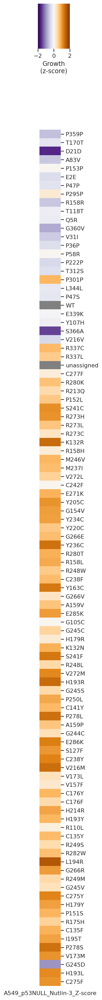

In [9]:
x=2

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(func_data.loc[sorted_variants,'A549_p53NULL_Nutlin-3_Z-score'],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.75, 0.85, 0.03),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(1,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'nutlinnull_heatmap.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'nutlinnull_heatmap.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


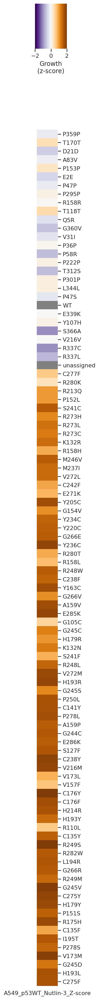

In [8]:
x=2

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(func_data.loc[sorted_variants,'A549_p53WT_Nutlin-3_Z-score'],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.75, 0.85, 0.03),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(1,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'nutlin_heatmap.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'nutlin_heatmap.png',bbox_inches = "tight")

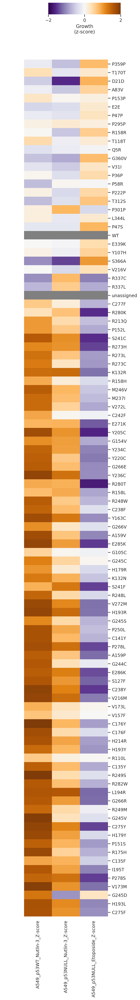

In [42]:
x=2

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(func_data.loc[sorted_variants,func_data.columns],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.85, 0.5, 0.01),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(5,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'func_heatmap.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'func_heatmap.png',bbox_inches = "tight")